In [1]:
import cv2, ctypes, logging, os, numpy as np, pickle
from numpy import ma
from collections import OrderedDict
from skimage.morphology import binary_closing, disk
import scipy, skfmm
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import skimage
from PIL import Image
from collections import defaultdict
from typing import Optional, Type, Dict

import torch
import habitat
import habitat.datasets
from habitat_baselines.common.environments import NavRLEnv
from habitat_baselines.common.baseline_registry import baseline_registry
from habitat_baselines.config.default import get_config
from habitat.utils.visualizations.utils import images_to_video
from habitat.utils.visualizations import fog_of_war, maps


from habitat.utils.visualizations.utils import observations_to_image_challenge, observations_to_image_custum
from habitat.core.challenge import Challenge

from agents.proto_sgolam_walker import ProtoSGoLAMWalker
from utils.planner import FMMPlanner

In [2]:
try:
    env.close()
except:
    pass
config = get_config(config_paths='configs/baselines/proto_sgolam.yaml')
config.defrost()
config.TASK_CONFIG.TASK.MEASUREMENTS.append("TOP_DOWN_MAP")
config.TASK_CONFIG.TASK.MEASUREMENTS.append("COLLISIONS")
config.freeze()

In [3]:
def display_rgb(rgb):
    rgb_img = Image.fromarray(rgb, mode="RGB")
    plt.figure(figsize=(12 ,8))
    plt.imshow(rgb_img)
    plt.show()
    return rgb_img

In [4]:
challenge = Challenge(phase=None)
agent = ProtoSGoLAMWalker('configs/baselines/proto_sgolam.yaml', challenge)

2021-05-04 15:02:19,453 Initializing dataset MultiNav-v1
2021-05-04 15:02:19,454 initializing sim Sim-v0
I0504 15:02:24.945753 32272 simulator.py:145] Loaded navmesh data/scene_datasets/mp3d/zsNo4HB9uLZ/zsNo4HB9uLZ.navmesh
I0504 15:02:24.946487 32272 simulator.py:157] Recomputing navmesh for agent's height 0.88 and radius 0.1.
2021-05-04 15:02:25,058 Initializing task MultiNav-v1
  0%|          | 0/25 [00:00<?, ?it/s]

In [5]:
num_test = 1

In [6]:
top_down_map = maps.get_topdown_map(challenge._env.sim, (275, 275), 10000, False)
range_x = np.where(np.any(top_down_map, axis=1))[0]
range_y = np.where(np.any(top_down_map, axis=0))[0]

_ind_x_min = range_x[0]
_ind_x_max = range_x[-1]
_ind_y_min = range_y[0]
_ind_y_max = range_y[-1]

top_down_map = top_down_map[_ind_x_min:_ind_x_max,_ind_y_min:_ind_y_max,]

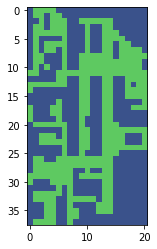

In [7]:
fig, ax = plt.subplots()
ax.imshow(top_down_map * 1., vmin=-0.5, vmax=1.5)

In [8]:
torch.tensor([[agent.config.TASK_CONFIG.SIMULATOR.FORWARD_STEP_SIZE,0]])

tensor([[0.2500, 0.0000]])

1
3
2
3
1
3
1
1
3
3
3
2
2
2
3
2
3
2
3
1
1
3
2
2
3
3
0


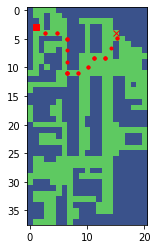

In [9]:
        fig, ax = plt.subplots()
        #####  PLANNING OPTIONS  #####
        selem = skimage.morphology.disk(2)
        selem_small = skimage.morphology.disk(1)
        close_small_openings = False
        num_erosions = 3
        turn_angle = 30
        ##############################
        
        ##### TODO #####
        forward_step_size = 2 # in map
        state = [1,3,0] # angle info?
        goal = [15,4] # goal position in map coord
        ################

         # TODO : Change after confirming Occupancy map's shape
        traversible = top_down_map == 1
        
        planner = FMMPlanner(traversible,forward_step_size, 360//turn_angle)
        reachable = planner.set_goal(goal) # check goal if int?
        
        ax.imshow(traversible * 1., vmin=-0.5, vmax=1.5)
        ax.plot(goal[0], goal[1], 'rx')
        ax.plot(state[0], state[1], 'rs')
        states = []
        for i in range(1000):
            a, state, _ = planner.get_action(state)
            states.append(state)
            print(a)
            if a == 0:
                break
        states = np.array(states)
        ax.plot(states[:, 0], states[:, 1], 'r.')

In [10]:
selem = skimage.morphology.disk(3)
selem_small = skimage.morphology.disk(1)
not_traversible = top_down_map != 1 # TODO : Change after confirming Occupancy map's shape
before = skimage.morphology.binary_dilation(not_traversible, selem) != True
after = skimage.morphology.binary_erosion(before, selem_small)
after = skimage.morphology.binary_dilation(after, selem_small)

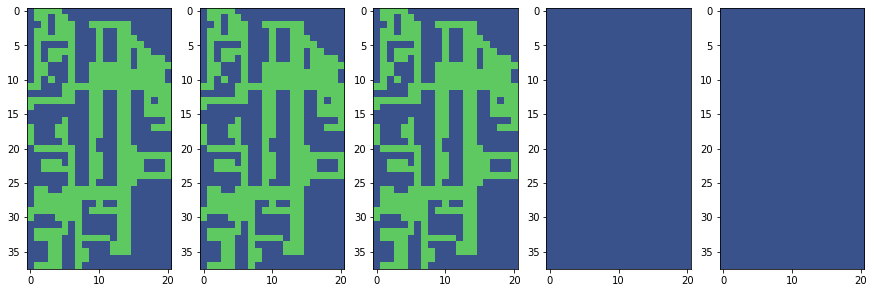

In [11]:
fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5,figsize=(15,15))
ax1.imshow(top_down_map * 1., vmin=-0.5, vmax=1.5)
ax2.imshow(top_down_map * 1. - before * 1., vmin=-0.5, vmax=1.5)
ax3.imshow(top_down_map * 1. - after * 1., vmin=-0.5, vmax=1.5)
ax4.imshow(before * 1. - after * 1., vmin=-0.5, vmax=1.5)
ax5.imshow(after * 1., vmin=-0.5, vmax=1.5)


  4%|▍         | 1/25 [00:00<00:19,  1.23it/s]

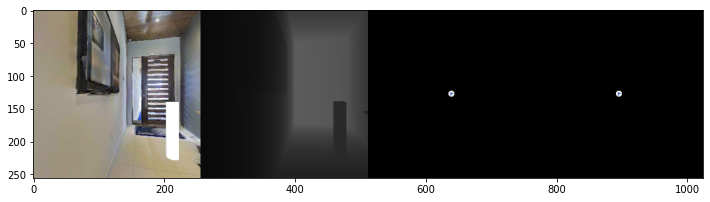

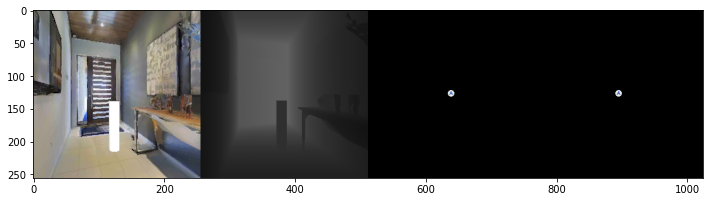

STEPS : 3 GOALS_FOUND : 0 GOALS : [4, 6, 7]
EXPLORE


/home/mingilee/multion/lib/python3.6/site-packages/torch/nn/functional.py:3448: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn("Default grid_sample and affine_grid behavior has changed "
/home/mingilee/multion/lib/python3.6/site-packages/torch/nn/functional.py:3385: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn("Default grid_sample and affine_grid behavior has changed "


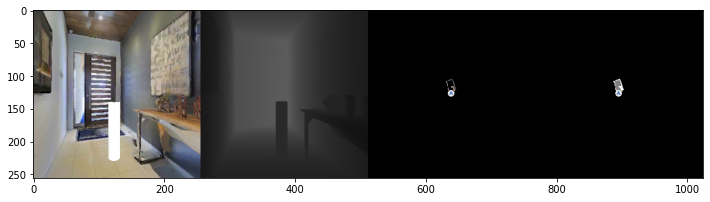

STEPS : 4 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


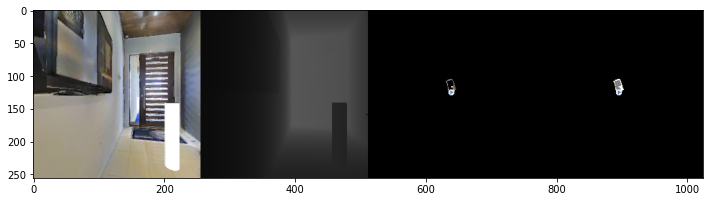

STEPS : 5 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


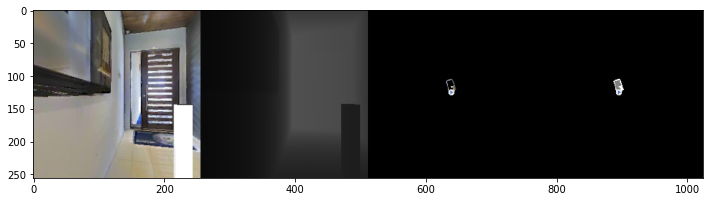

STEPS : 6 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


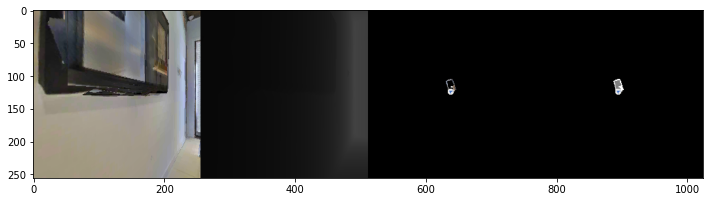

STEPS : 7 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


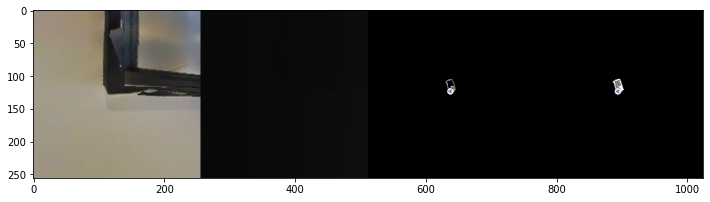

STEPS : 8 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


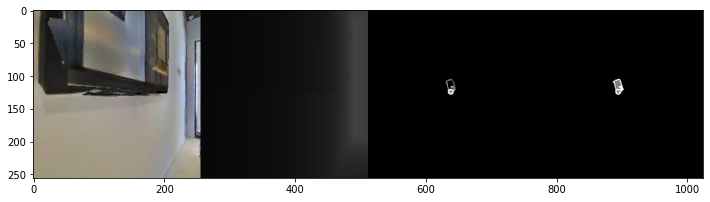

STEPS : 9 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


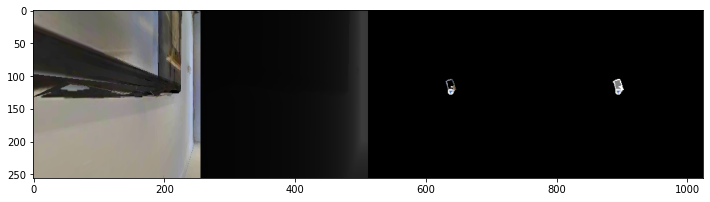

STEPS : 10 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


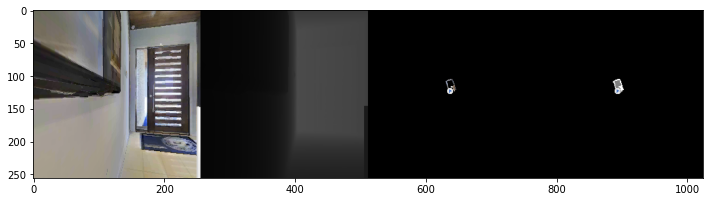

STEPS : 11 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


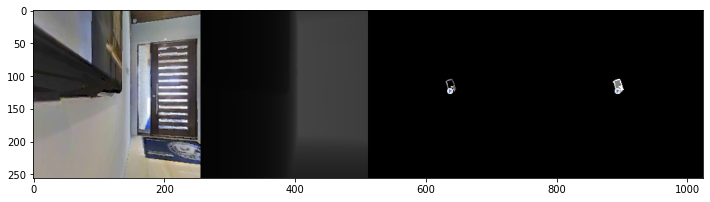

STEPS : 12 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


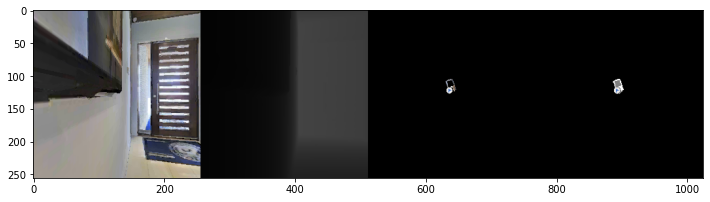

STEPS : 13 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


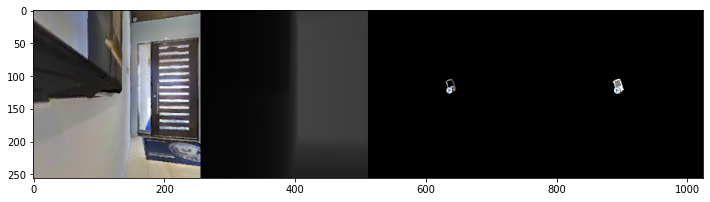

STEPS : 14 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


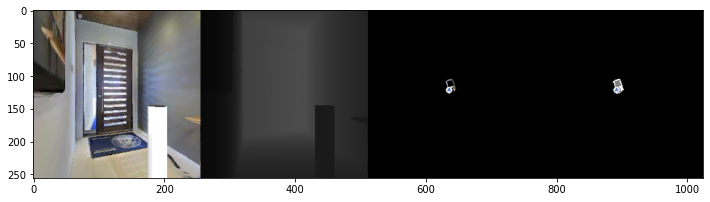

STEPS : 15 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


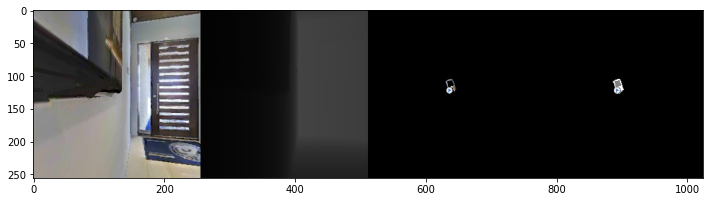

STEPS : 16 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


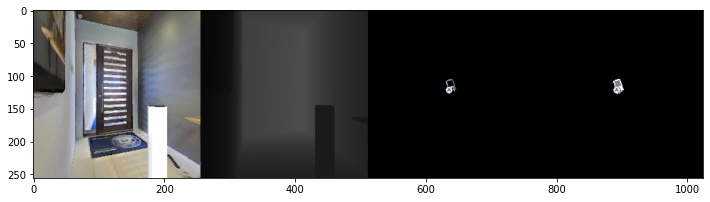

STEPS : 17 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


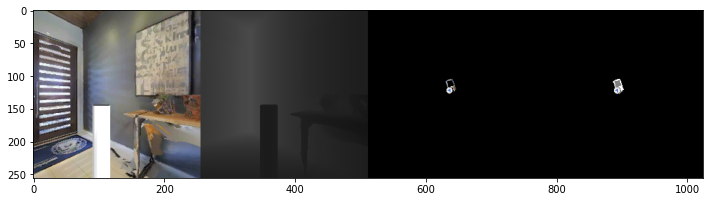

STEPS : 18 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


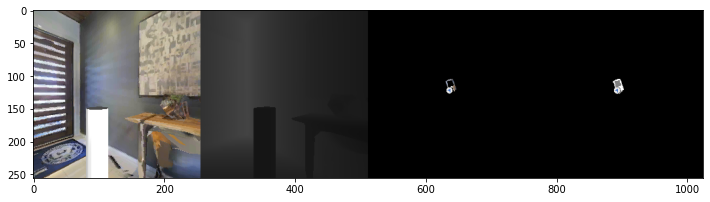

STEPS : 19 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


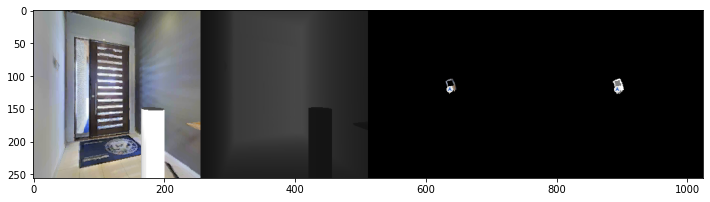

STEPS : 20 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


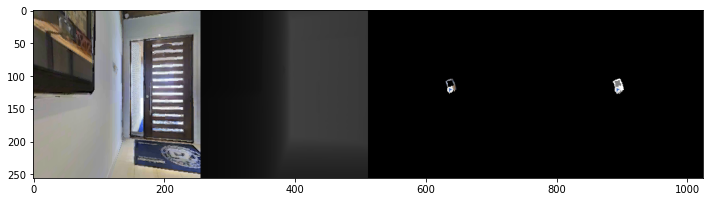

STEPS : 21 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


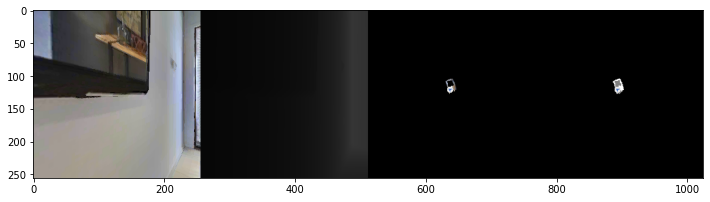

STEPS : 22 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


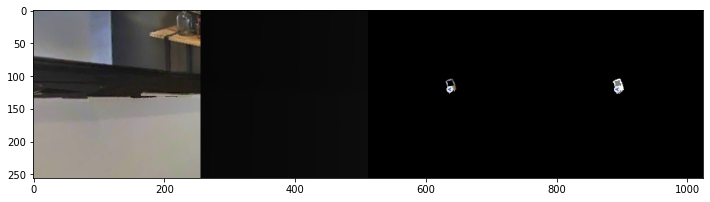

STEPS : 23 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


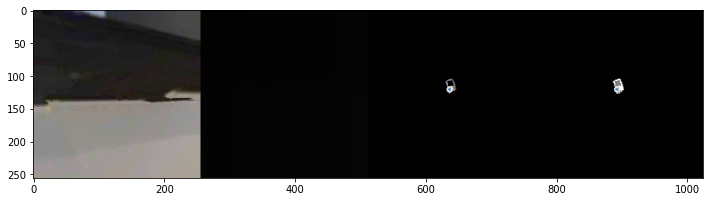

STEPS : 24 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


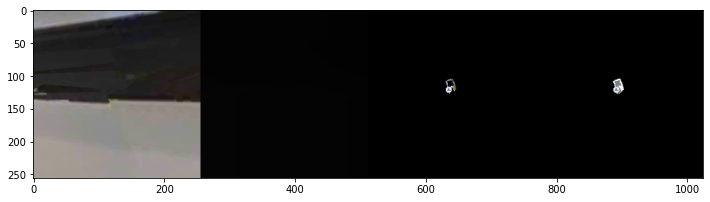

STEPS : 25 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


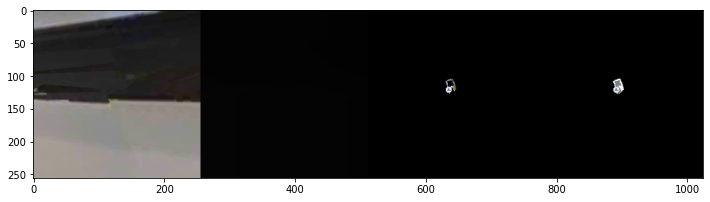

STEPS : 26 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


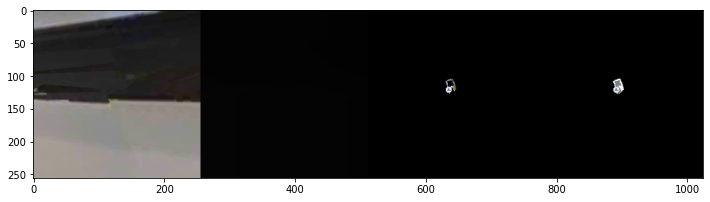

STEPS : 27 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


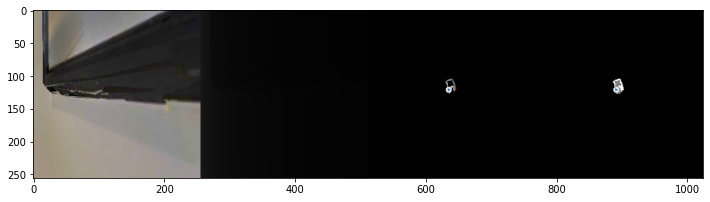

STEPS : 28 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


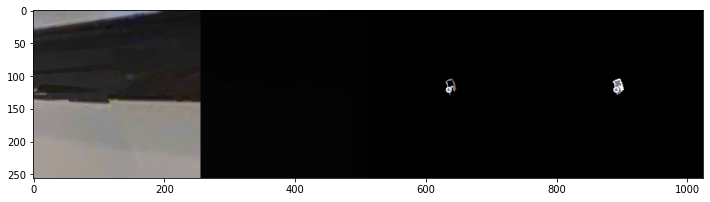

STEPS : 29 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


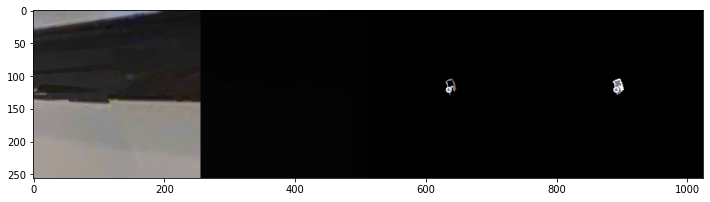

STEPS : 30 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


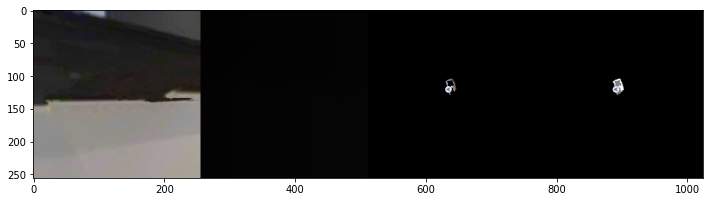

STEPS : 31 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


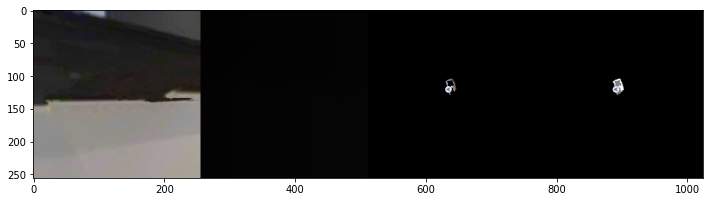

STEPS : 32 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


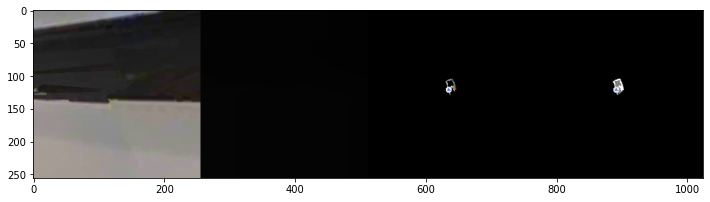

STEPS : 33 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


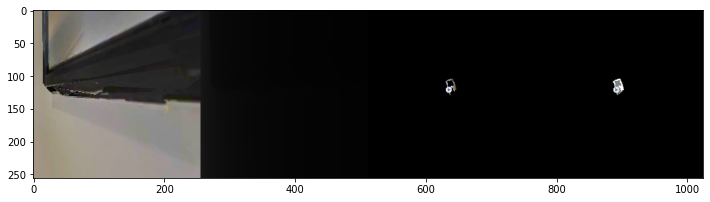

STEPS : 34 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


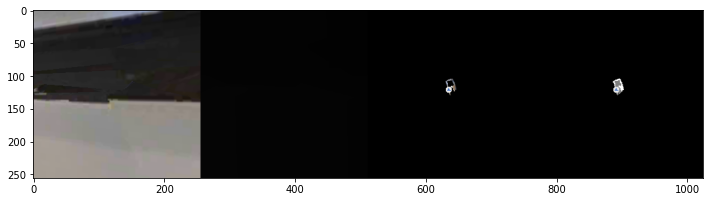

STEPS : 35 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


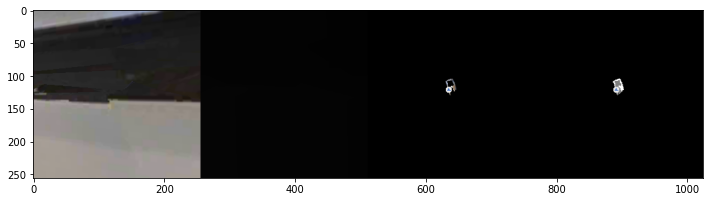

STEPS : 36 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


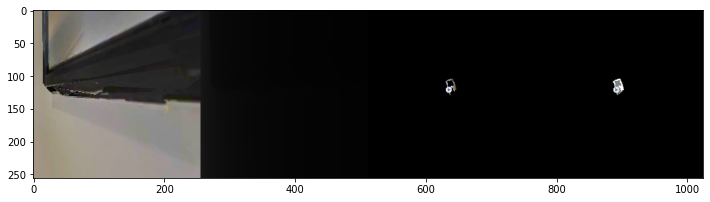

STEPS : 37 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


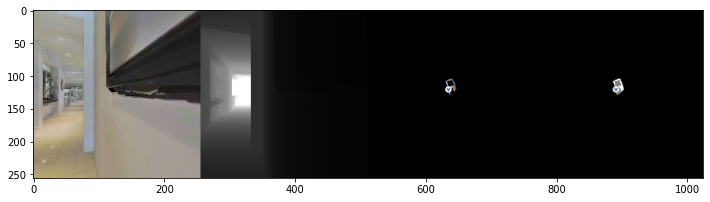

STEPS : 38 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


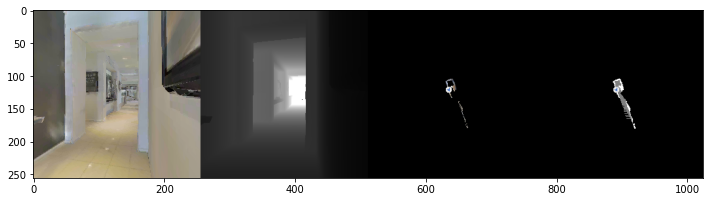

STEPS : 39 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


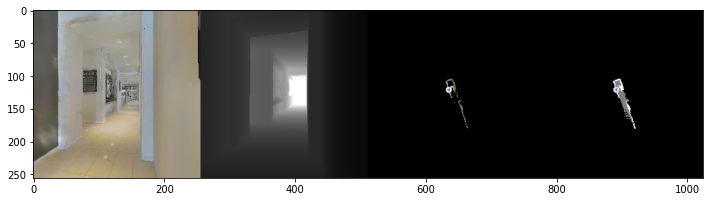

STEPS : 40 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


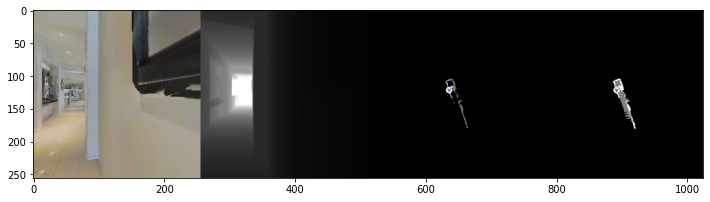

STEPS : 41 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


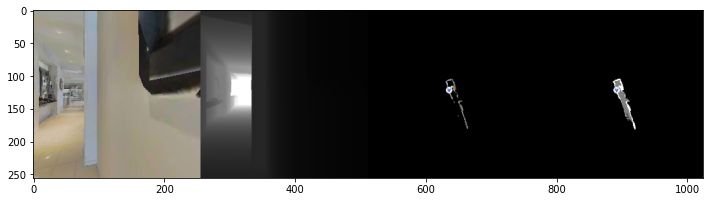

STEPS : 42 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


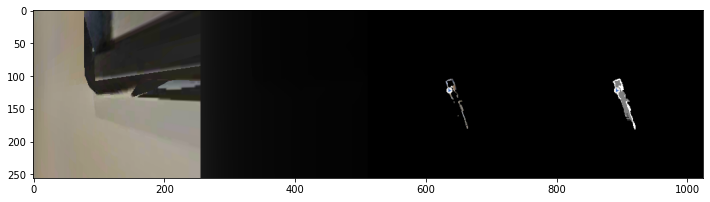

STEPS : 43 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


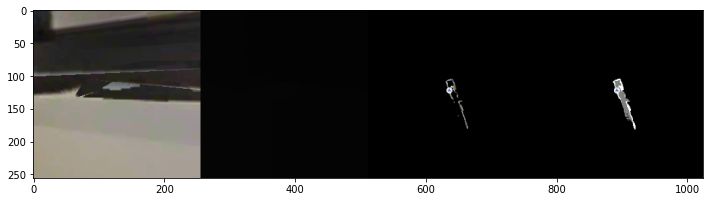

STEPS : 44 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


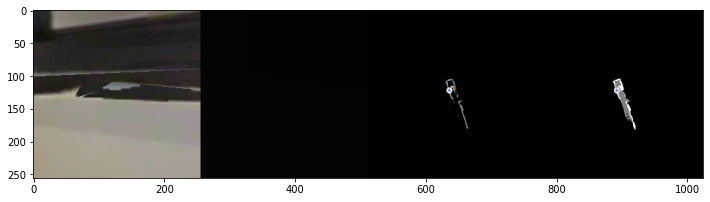

STEPS : 45 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


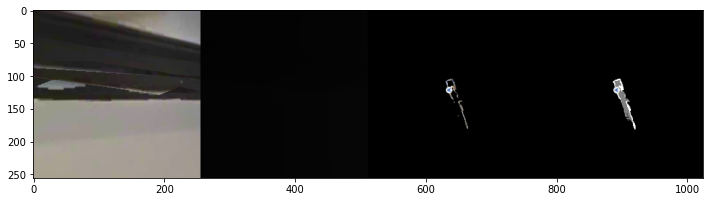

STEPS : 46 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


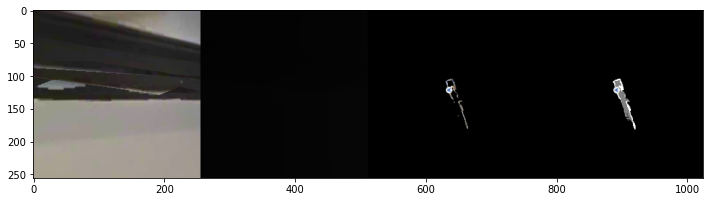

STEPS : 47 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


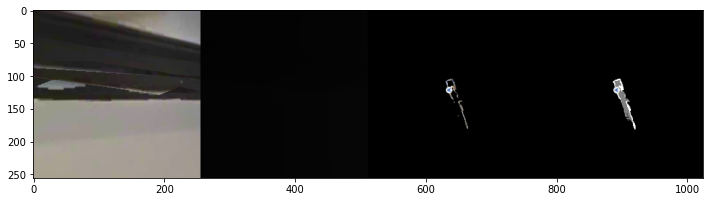

STEPS : 48 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


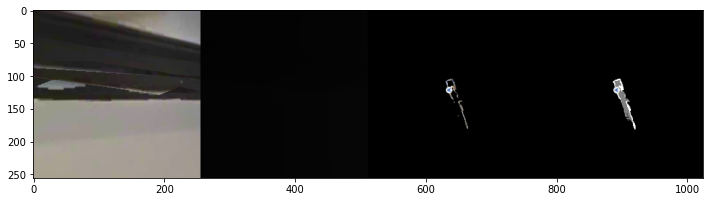

STEPS : 49 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


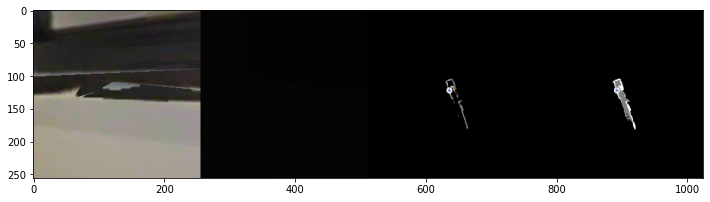

STEPS : 50 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


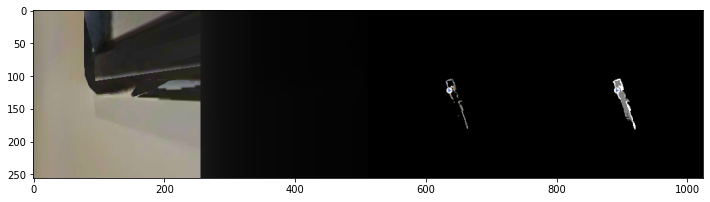

STEPS : 51 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


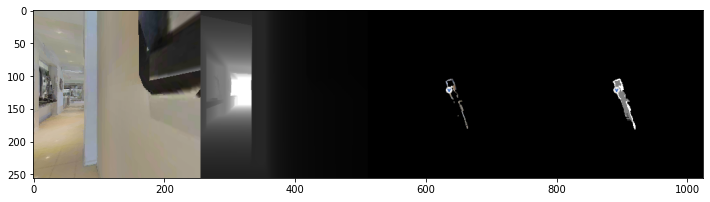

STEPS : 52 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


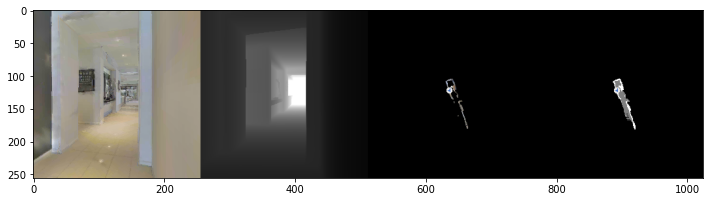

STEPS : 53 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


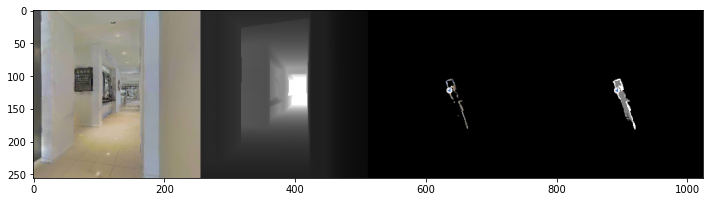

STEPS : 54 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


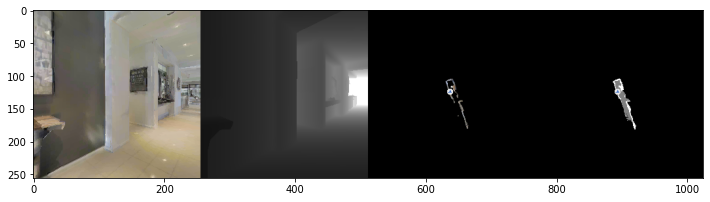

STEPS : 55 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


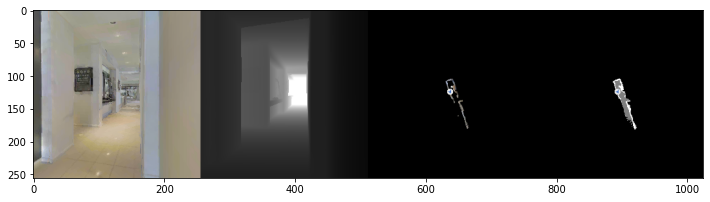

STEPS : 56 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


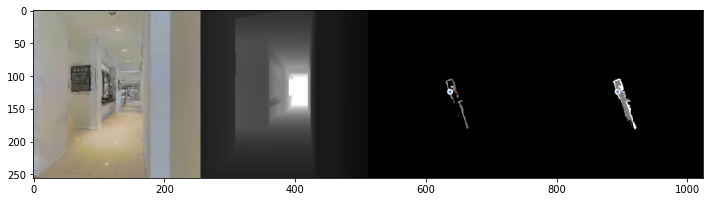

STEPS : 57 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


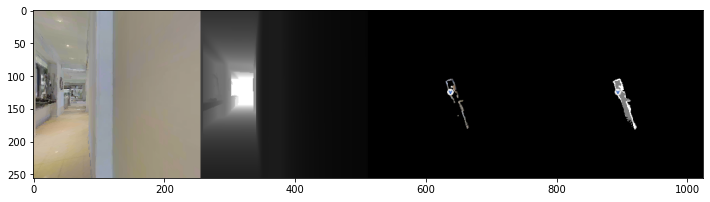

STEPS : 58 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


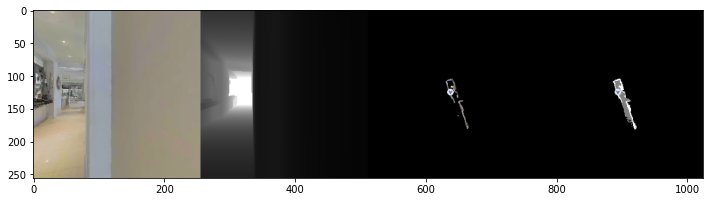

STEPS : 59 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


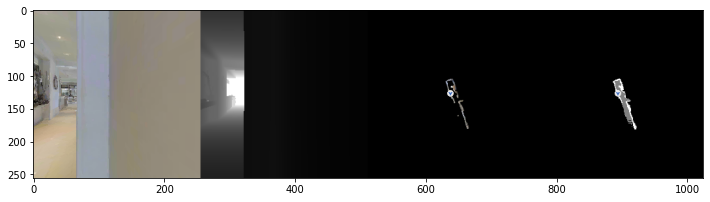

STEPS : 60 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


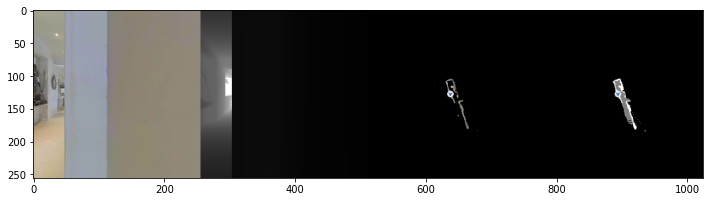

STEPS : 61 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


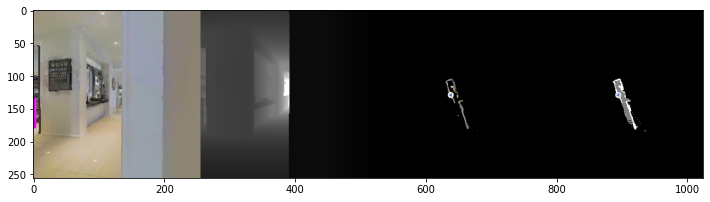

STEPS : 62 GOALS_FOUND : 1 GOALS : [4, 6, 7]
EXPLORE


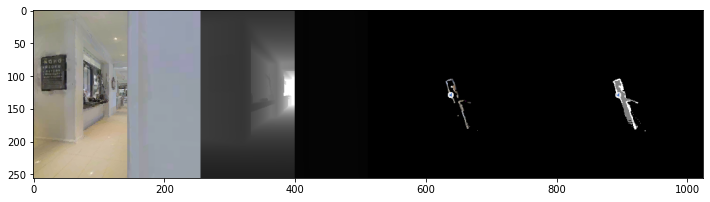

STEPS : 63 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


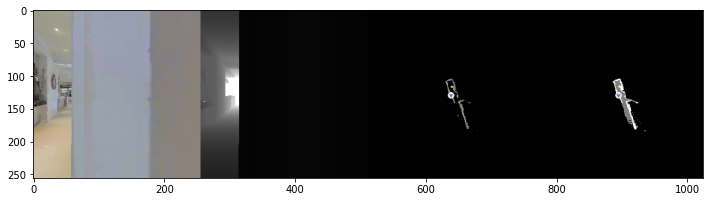

STEPS : 64 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


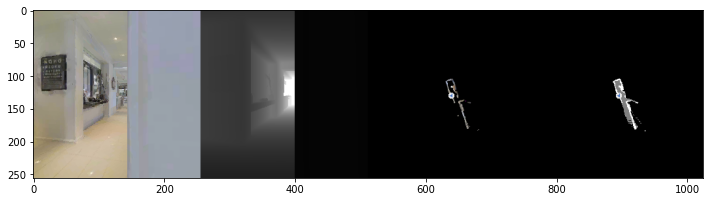

STEPS : 65 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


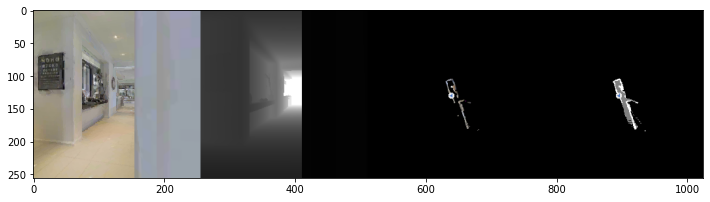

STEPS : 66 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


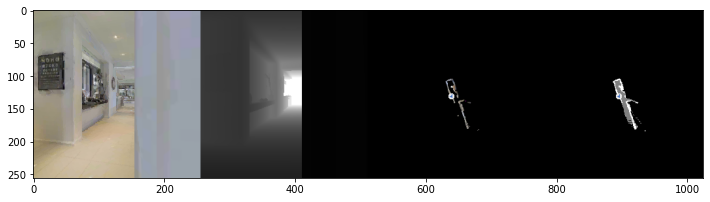

STEPS : 67 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


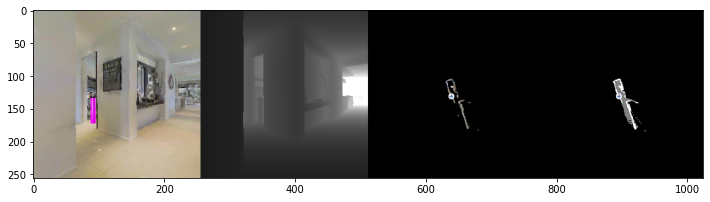

STEPS : 68 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


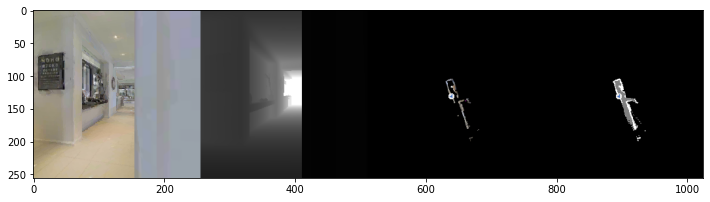

STEPS : 69 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


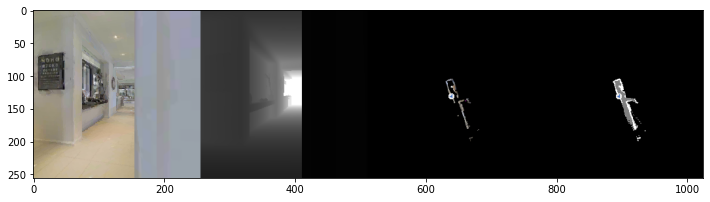

STEPS : 70 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


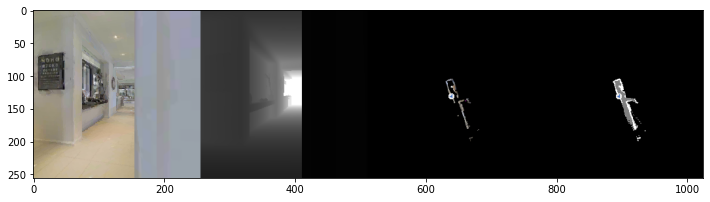

STEPS : 71 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


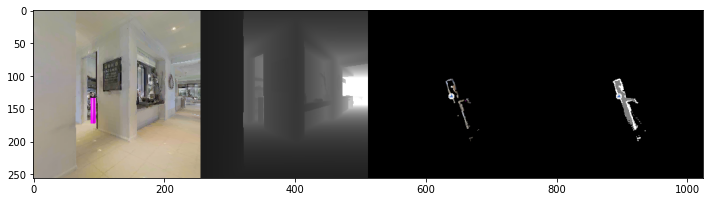

STEPS : 72 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


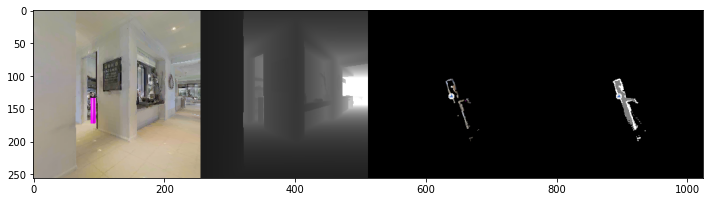

STEPS : 73 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


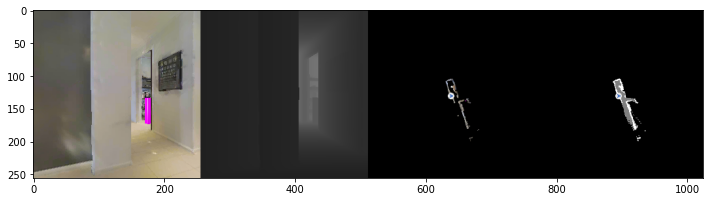

STEPS : 74 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


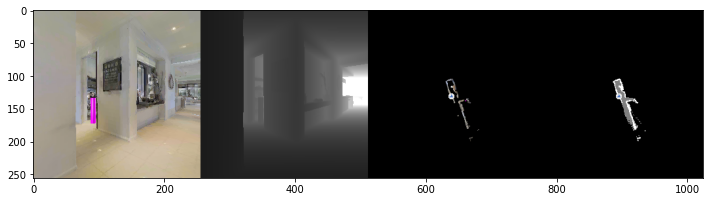

STEPS : 75 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


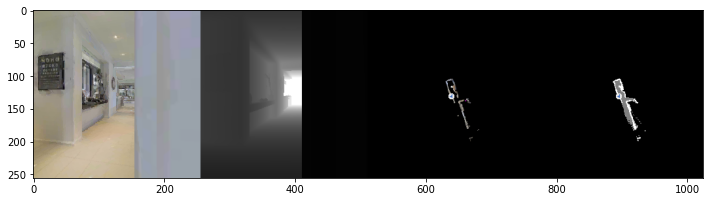

STEPS : 76 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


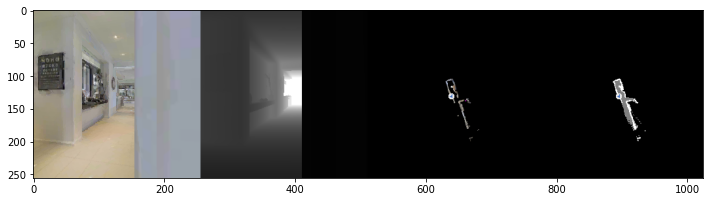

STEPS : 77 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


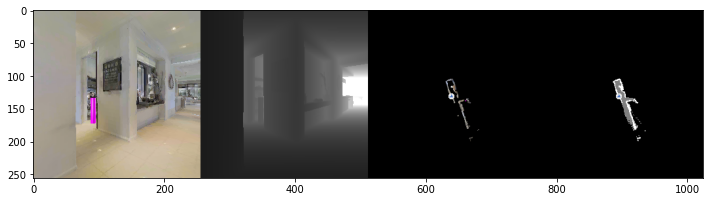

STEPS : 78 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


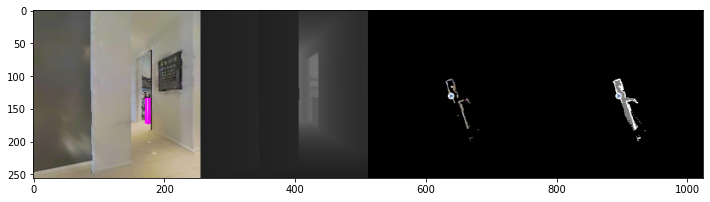

STEPS : 79 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


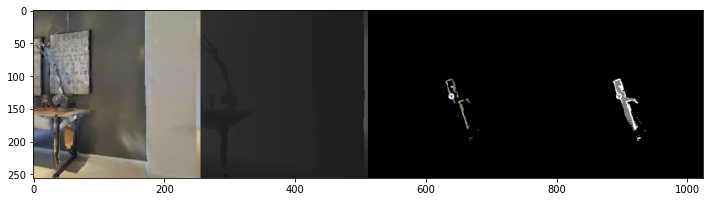

STEPS : 80 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


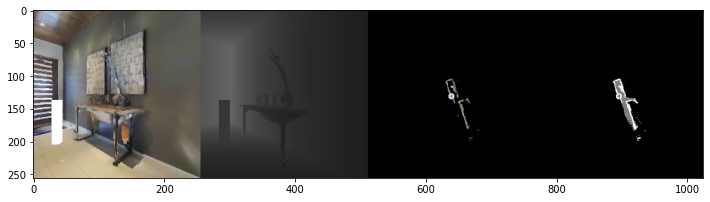

STEPS : 81 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


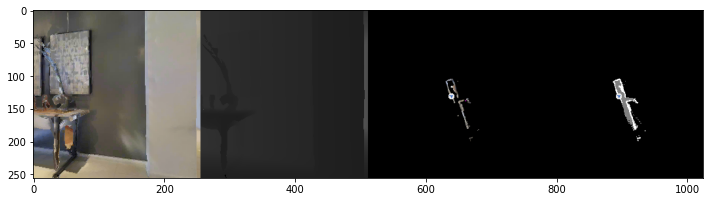

STEPS : 82 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


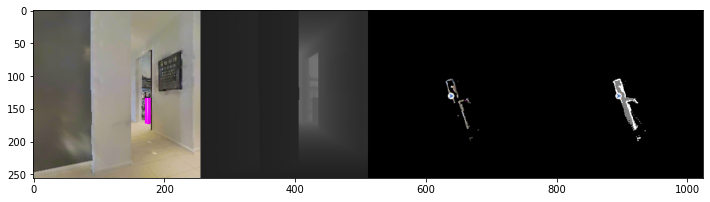

STEPS : 83 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


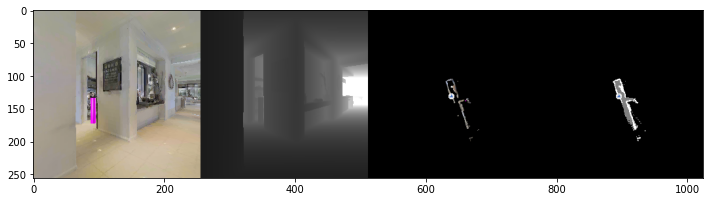

STEPS : 84 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


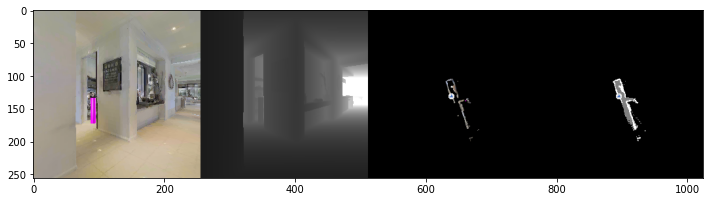

STEPS : 85 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


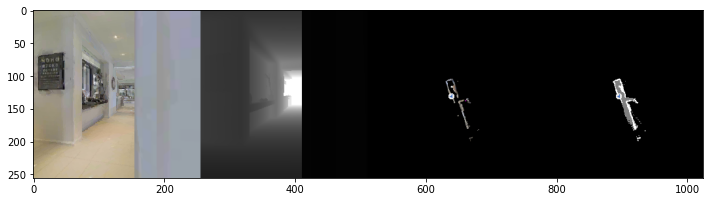

STEPS : 86 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


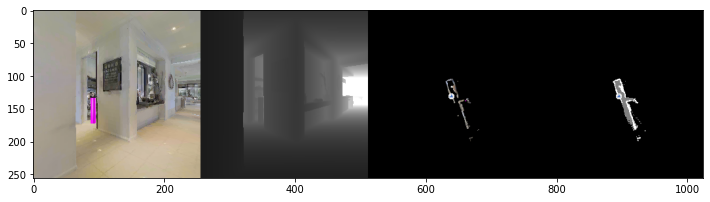

STEPS : 87 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


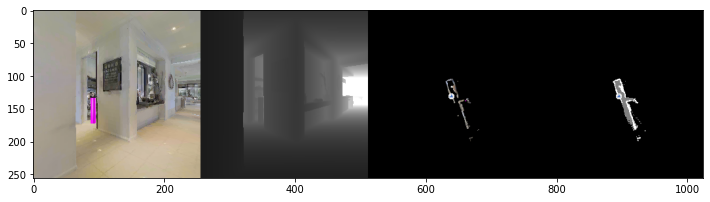

STEPS : 88 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


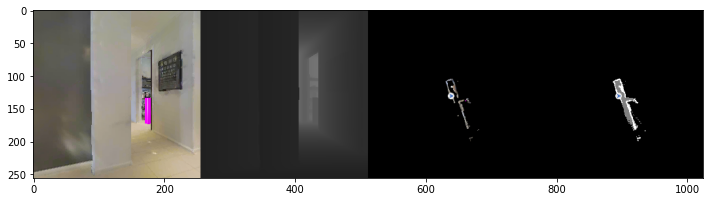

STEPS : 89 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


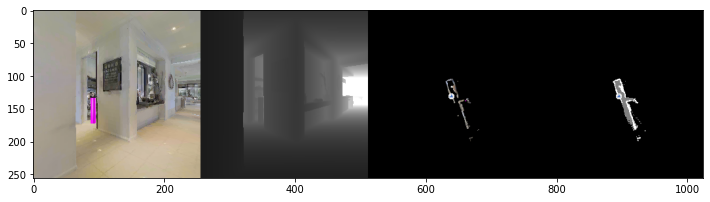

STEPS : 90 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


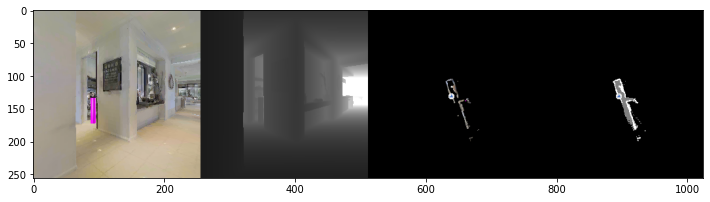

STEPS : 91 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


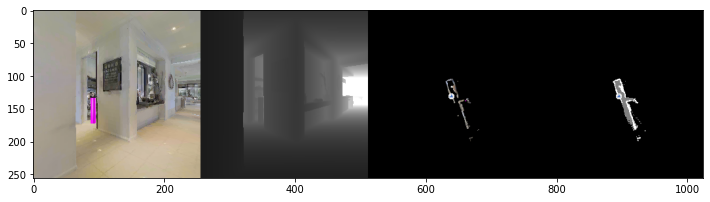

STEPS : 92 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


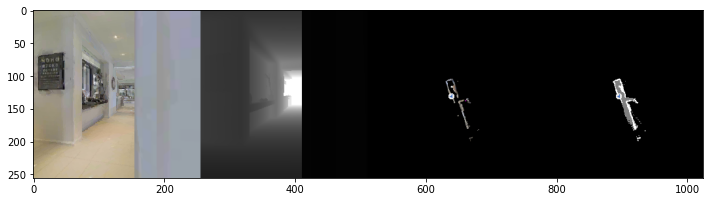

STEPS : 93 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


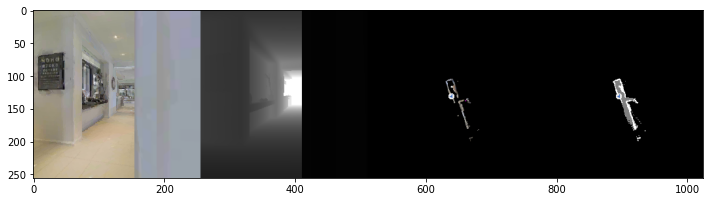

STEPS : 94 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


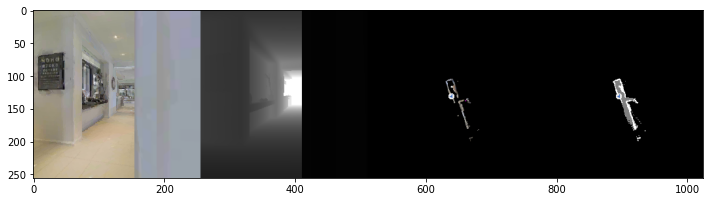

STEPS : 95 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


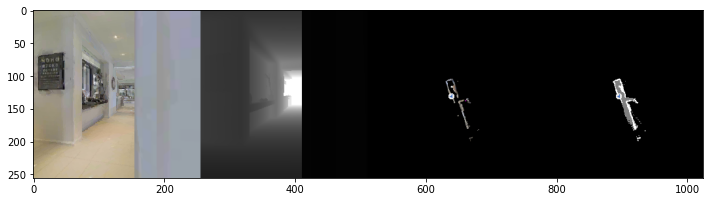

STEPS : 96 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


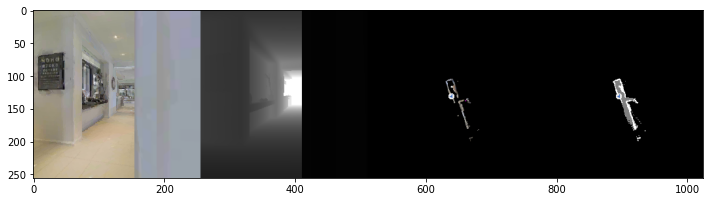

STEPS : 97 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


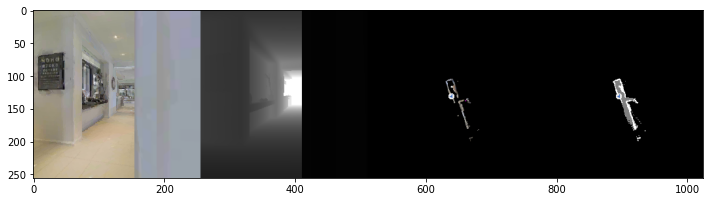

STEPS : 98 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


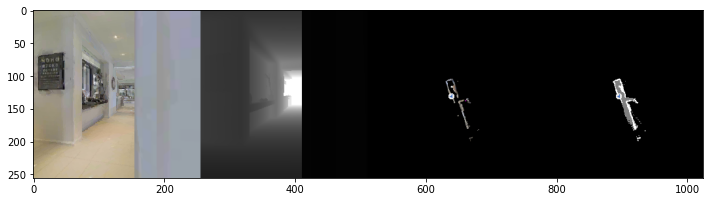

STEPS : 99 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


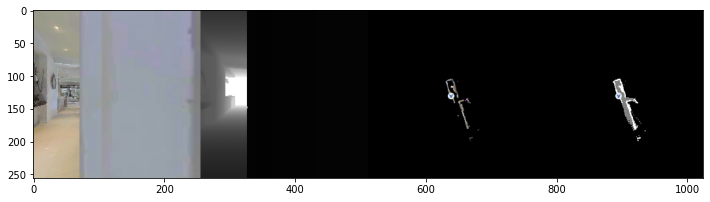

STEPS : 100 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


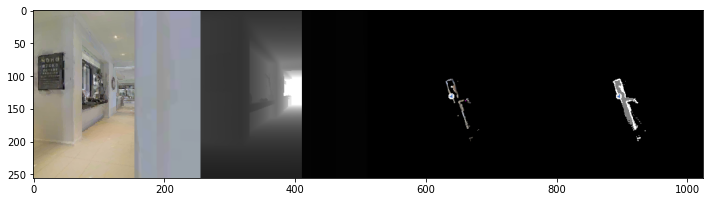

STEPS : 101 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


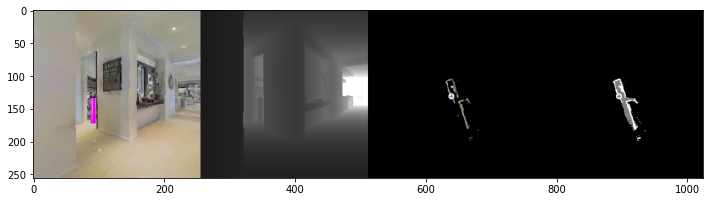

STEPS : 102 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


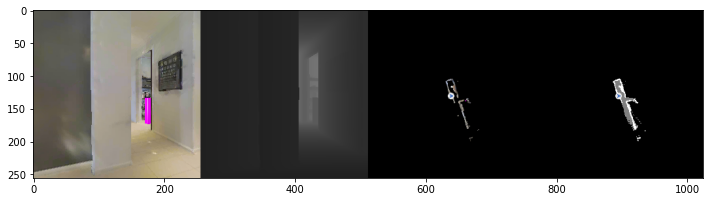

STEPS : 103 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


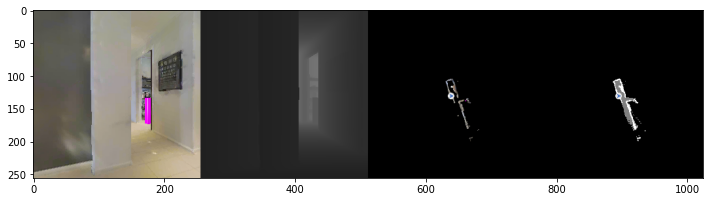

STEPS : 104 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


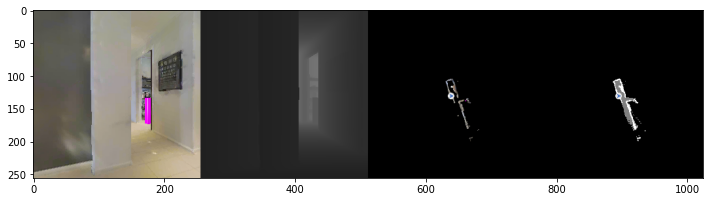

STEPS : 105 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


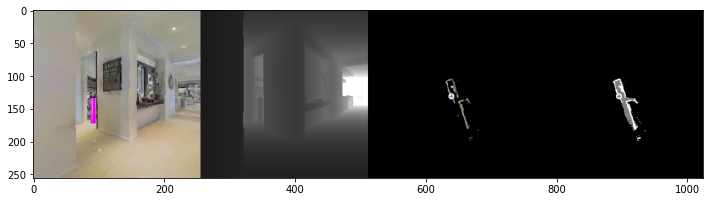

STEPS : 106 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


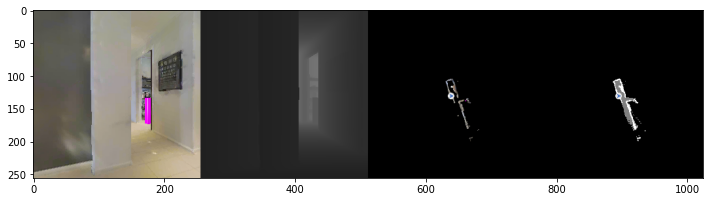

STEPS : 107 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


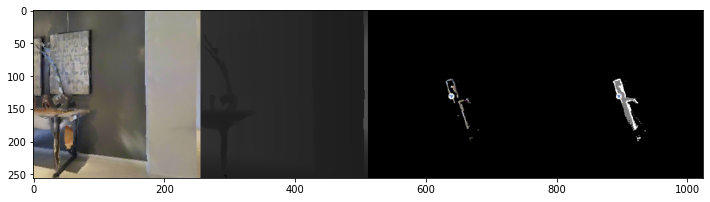

STEPS : 108 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


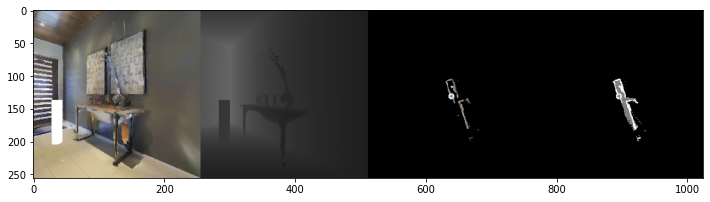

STEPS : 109 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


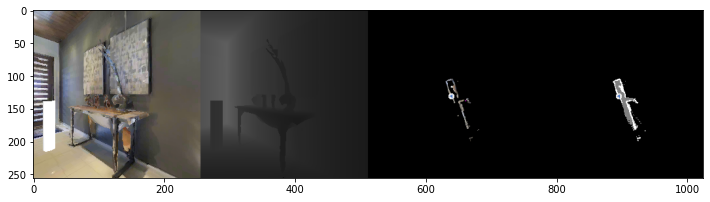

STEPS : 110 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


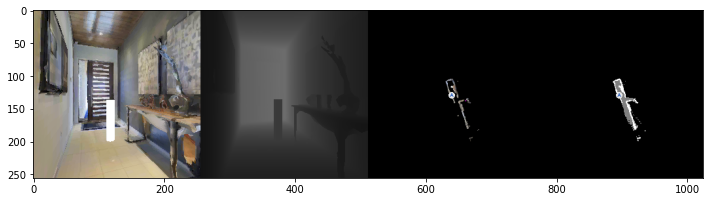

STEPS : 111 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


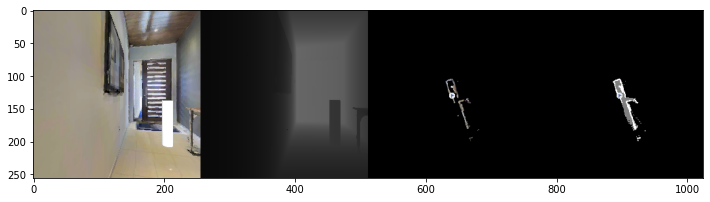

STEPS : 112 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


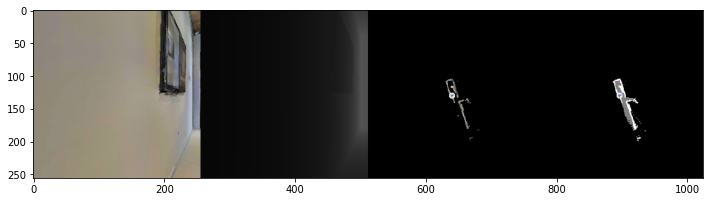

STEPS : 113 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


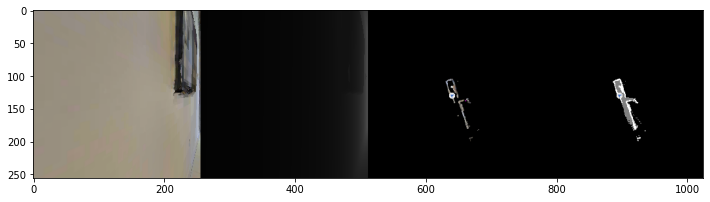

STEPS : 114 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


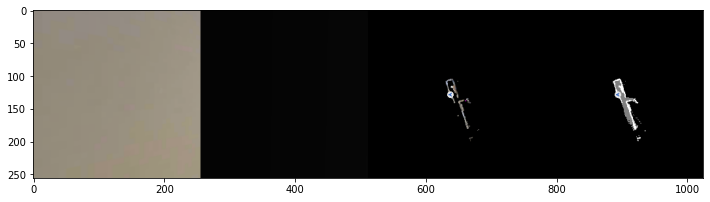

STEPS : 115 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


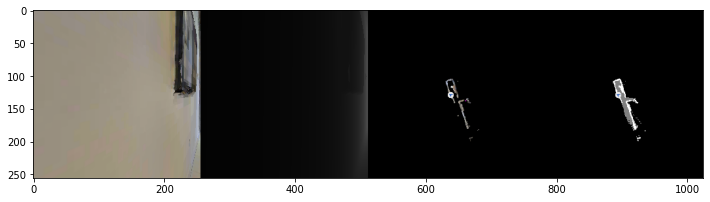

STEPS : 116 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


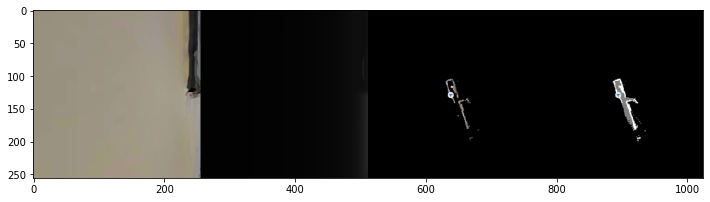

STEPS : 117 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


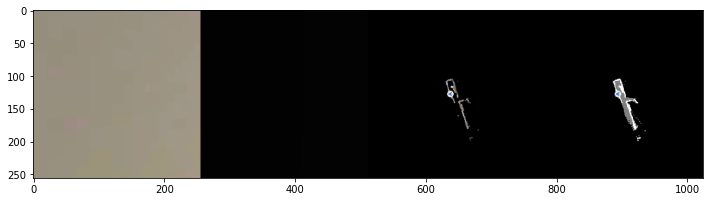

STEPS : 118 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


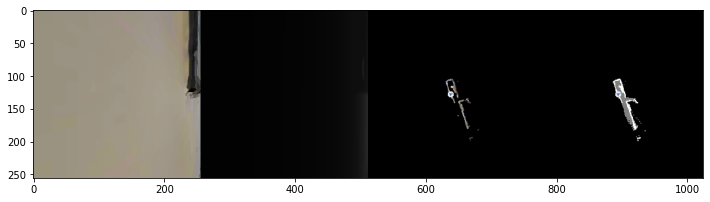

STEPS : 119 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


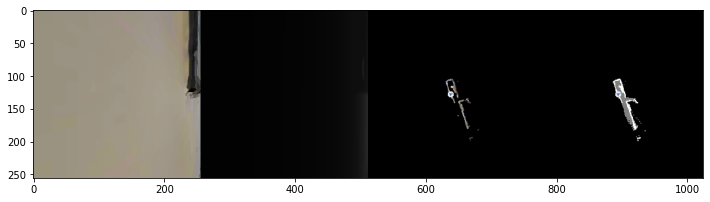

STEPS : 120 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


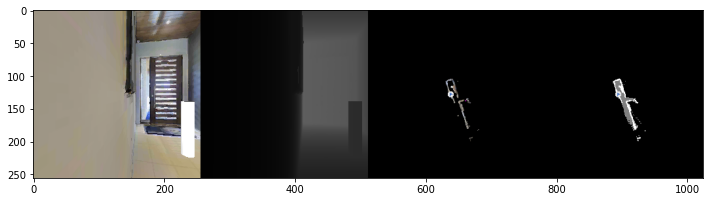

STEPS : 121 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


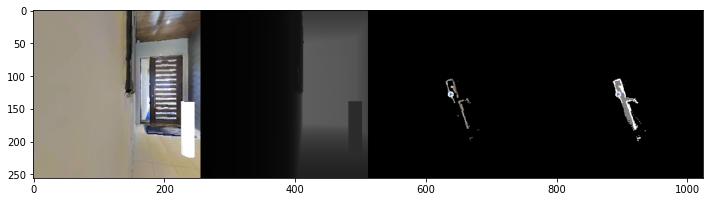

STEPS : 122 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


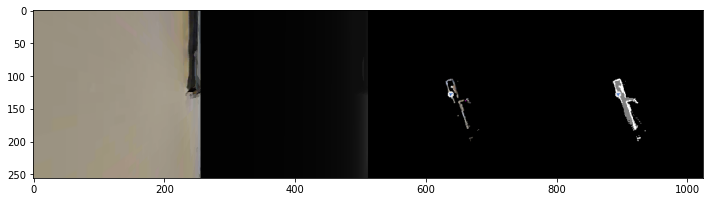

STEPS : 123 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


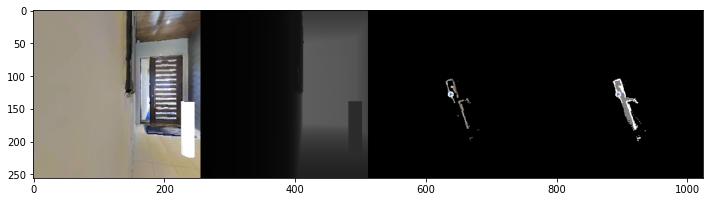

STEPS : 124 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


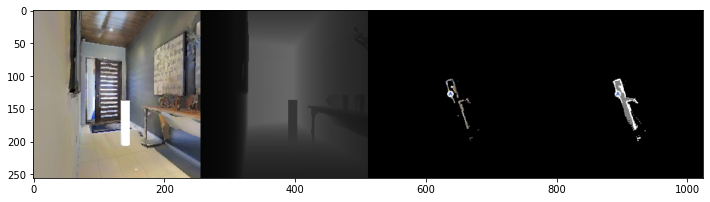

STEPS : 125 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


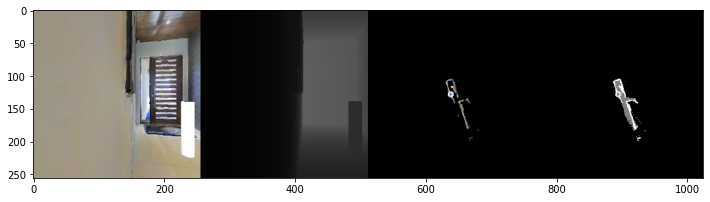

STEPS : 126 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


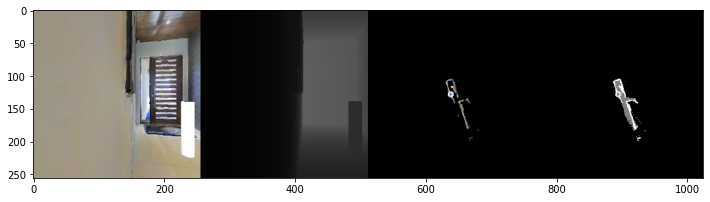

STEPS : 127 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


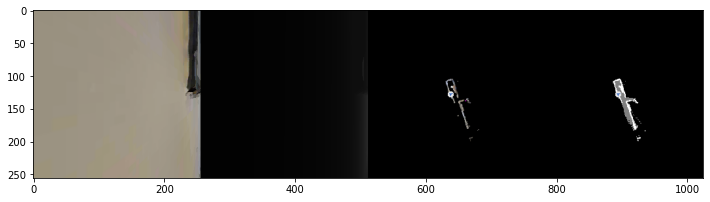

STEPS : 128 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


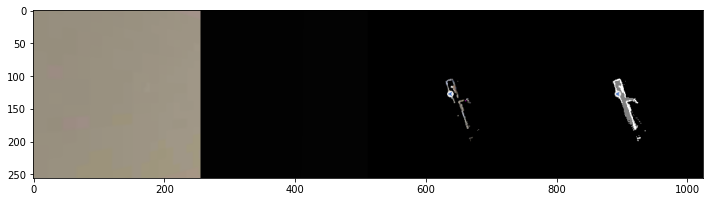

STEPS : 129 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


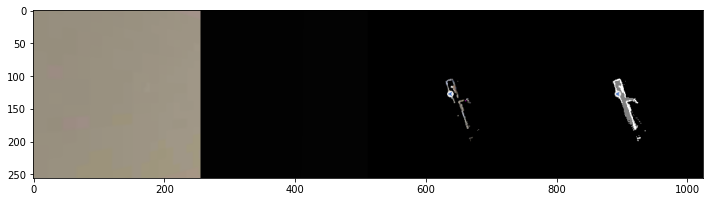

STEPS : 130 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


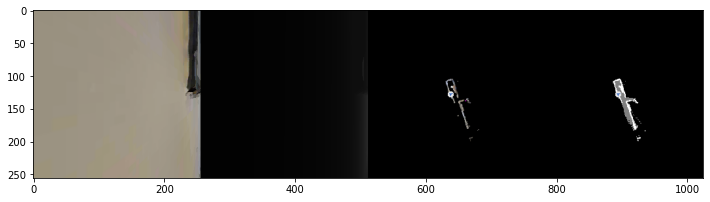

STEPS : 131 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


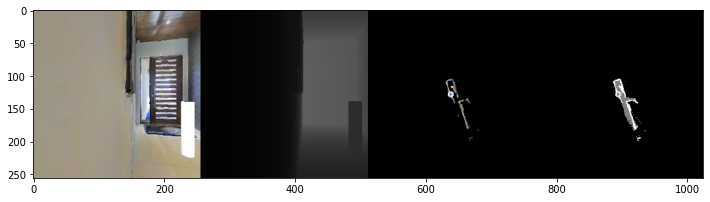

STEPS : 132 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


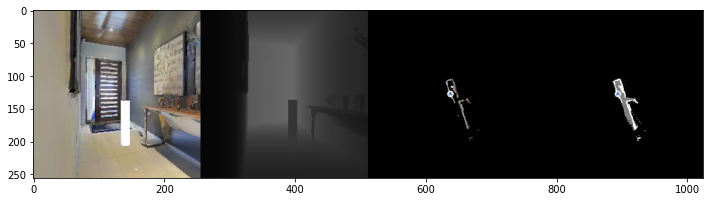

STEPS : 133 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


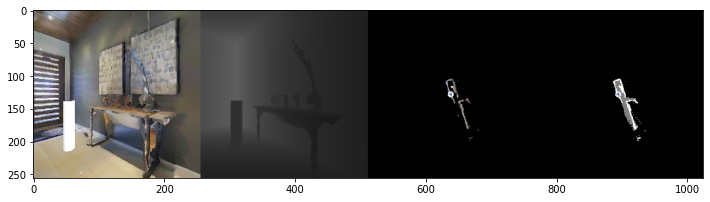

STEPS : 134 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


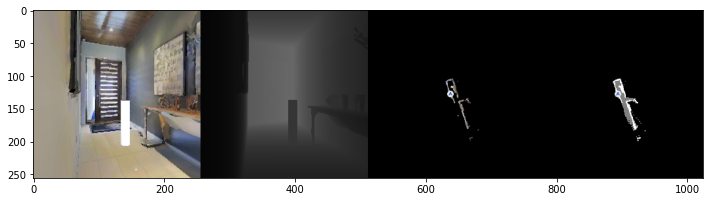

STEPS : 135 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


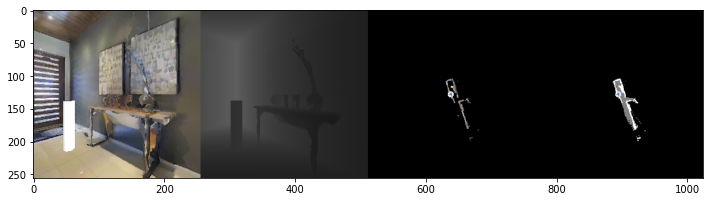

STEPS : 136 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


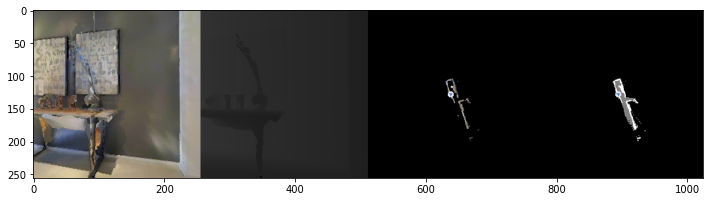

STEPS : 137 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


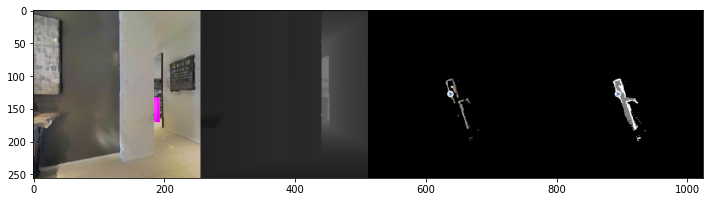

STEPS : 138 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


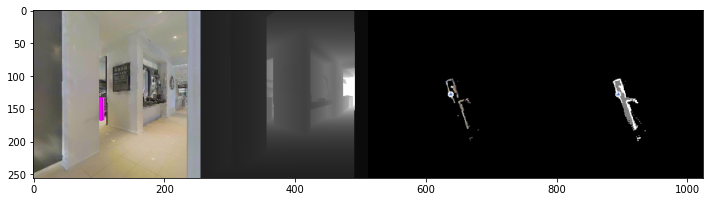

STEPS : 139 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


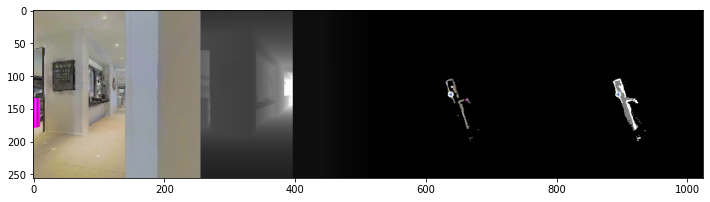

STEPS : 140 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


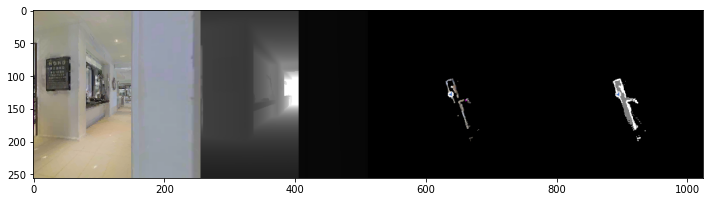

STEPS : 141 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


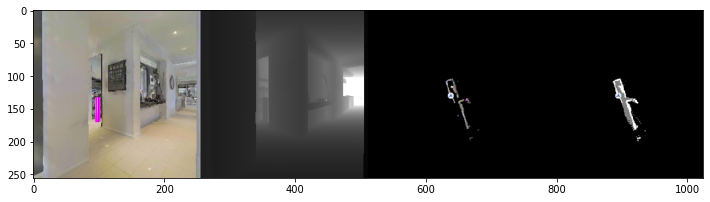

STEPS : 142 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


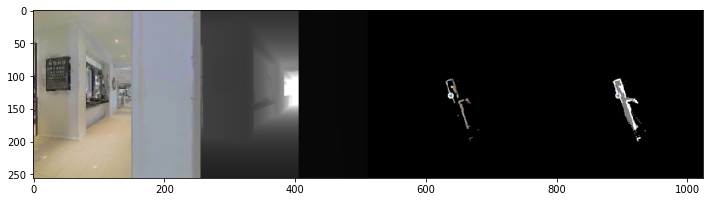

STEPS : 143 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


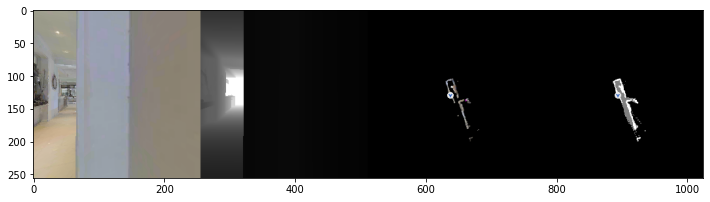

STEPS : 144 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


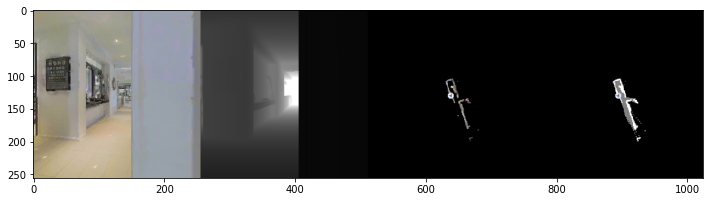

STEPS : 145 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


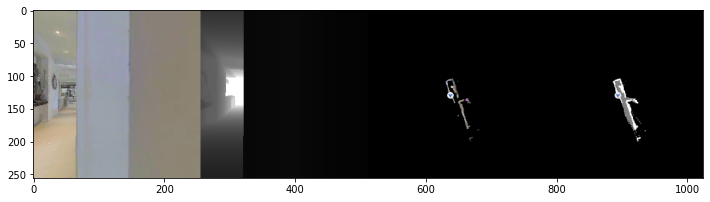

STEPS : 146 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


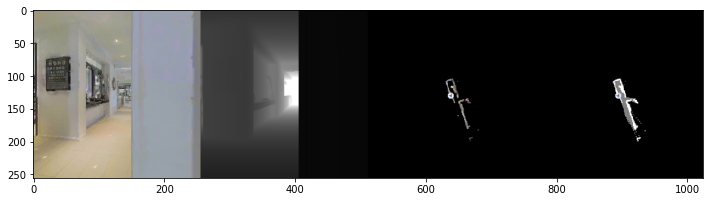

STEPS : 147 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


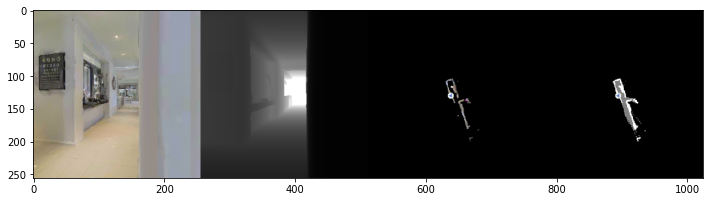

STEPS : 148 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


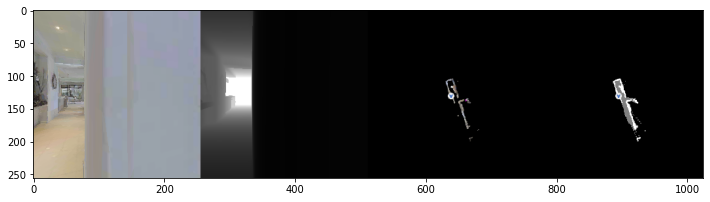

STEPS : 149 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


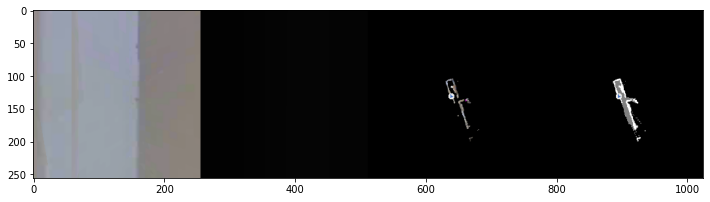

STEPS : 150 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


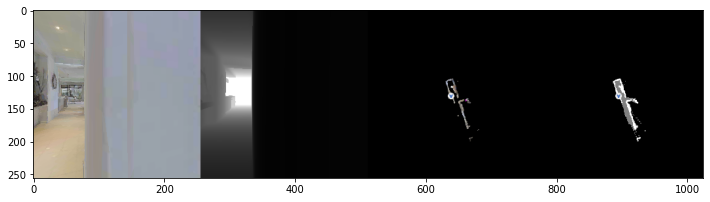

STEPS : 151 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


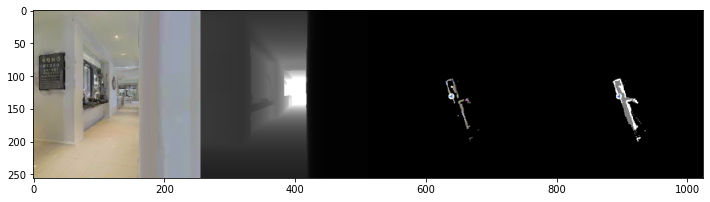

STEPS : 152 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


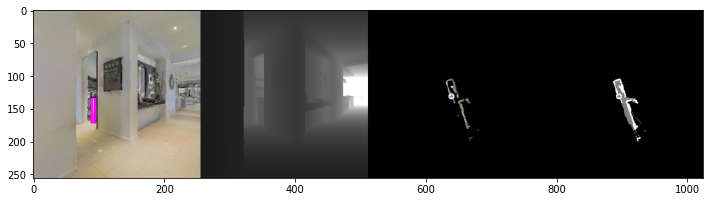

STEPS : 153 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


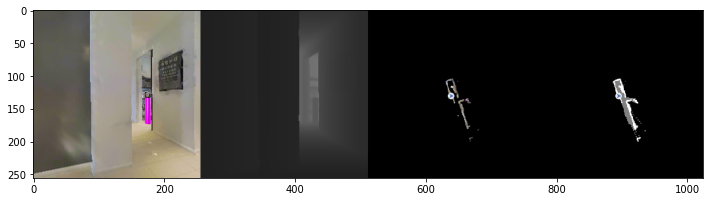

STEPS : 154 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


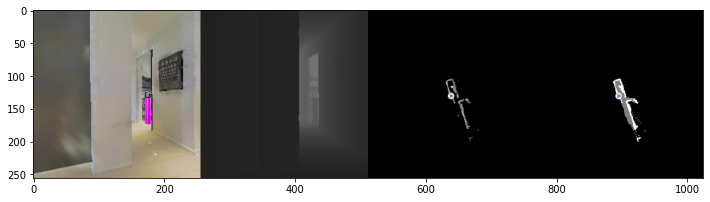

STEPS : 155 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


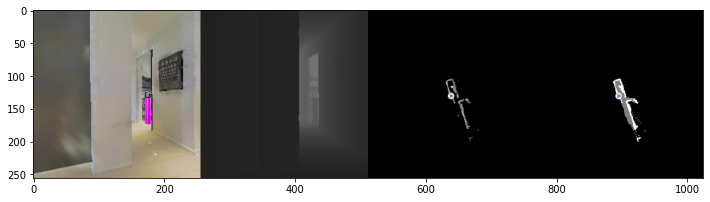

STEPS : 156 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


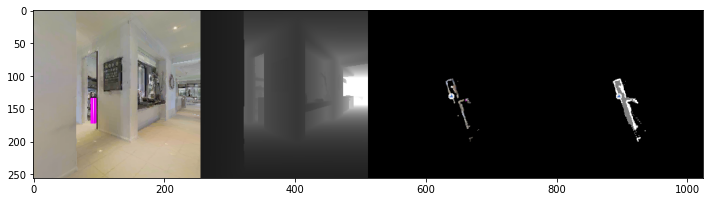

STEPS : 157 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


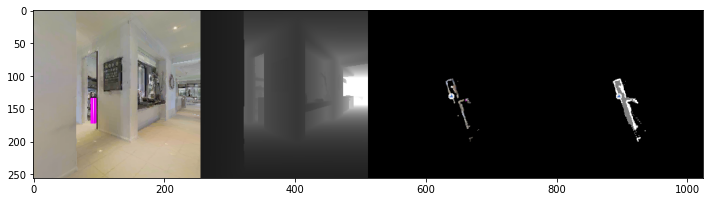

STEPS : 158 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


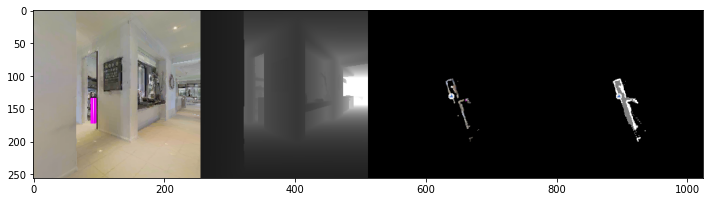

STEPS : 159 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


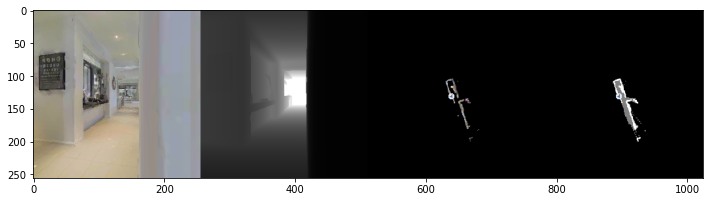

STEPS : 160 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


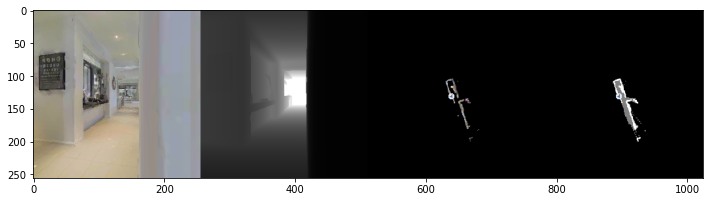

STEPS : 161 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


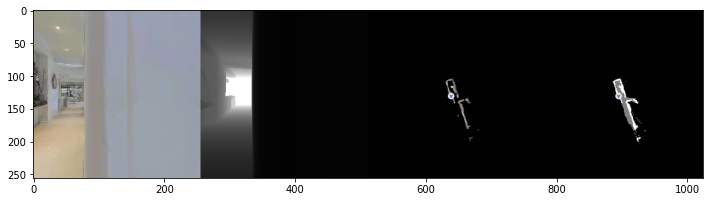

STEPS : 162 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


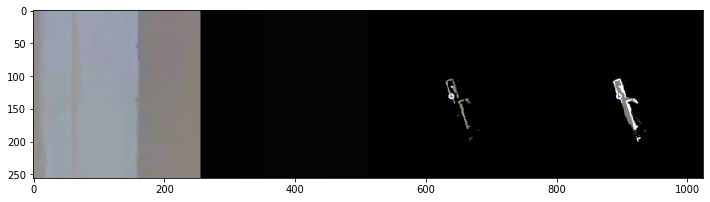

STEPS : 163 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


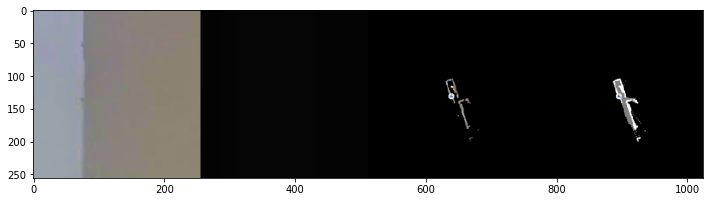

STEPS : 164 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


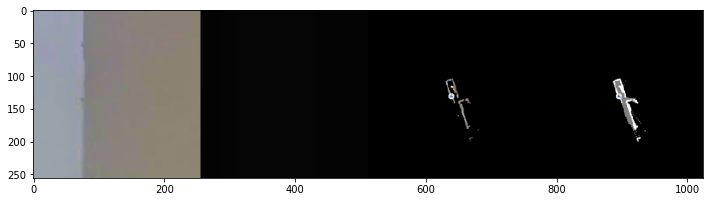

STEPS : 165 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


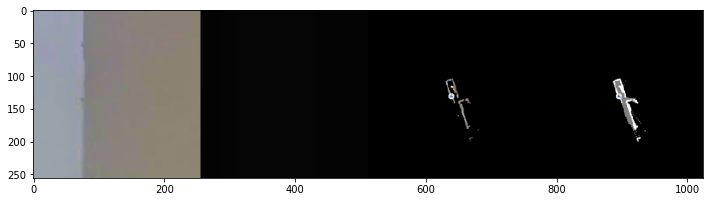

STEPS : 166 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


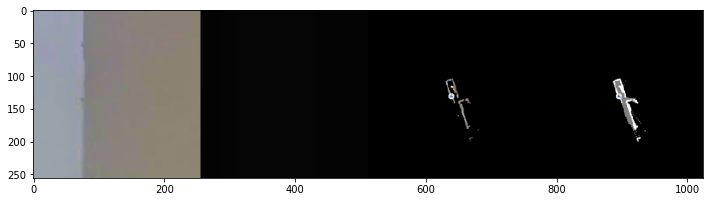

STEPS : 167 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


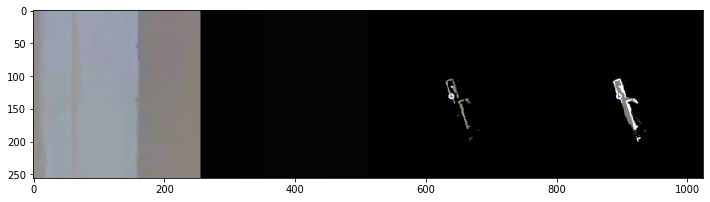

STEPS : 168 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


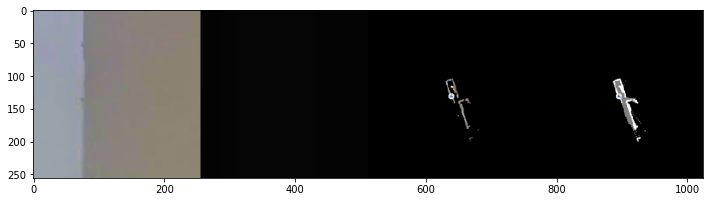

STEPS : 169 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


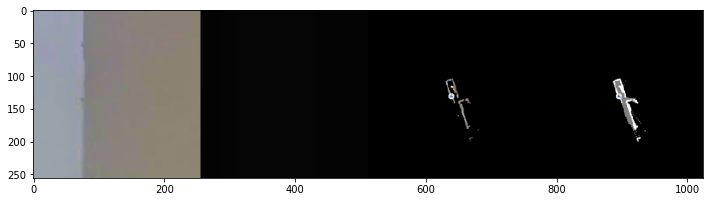

STEPS : 170 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


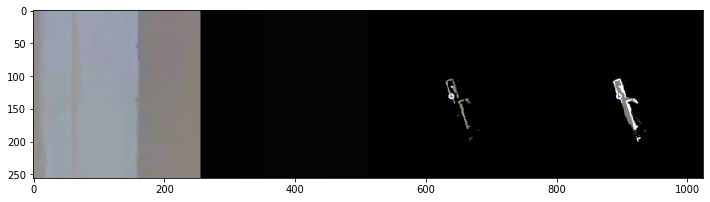

STEPS : 171 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


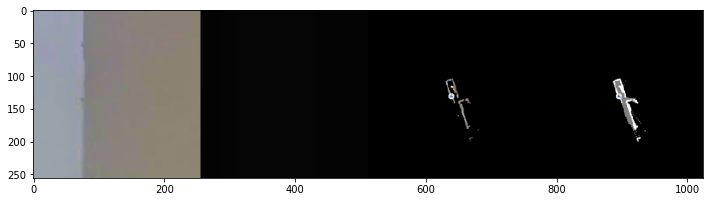

STEPS : 172 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


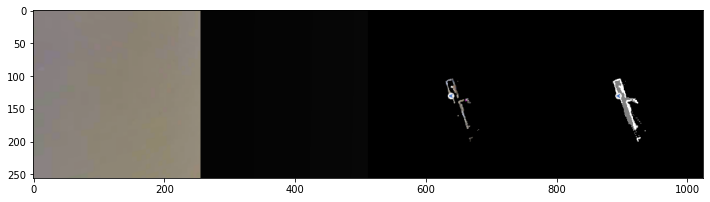

STEPS : 173 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


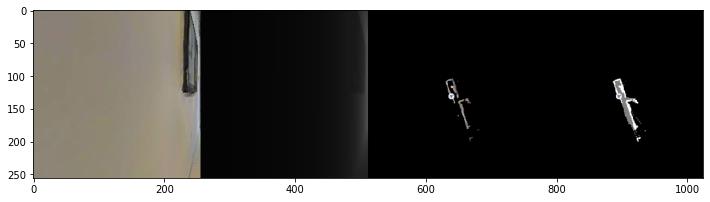

STEPS : 174 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


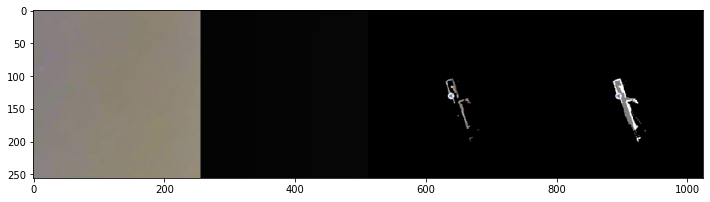

STEPS : 175 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


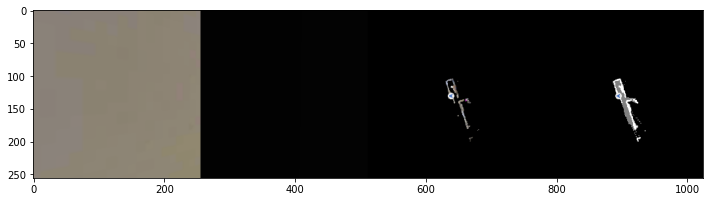

STEPS : 176 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


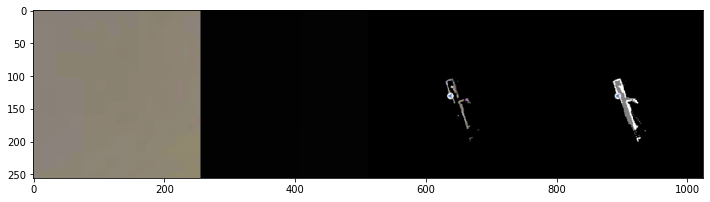

STEPS : 177 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


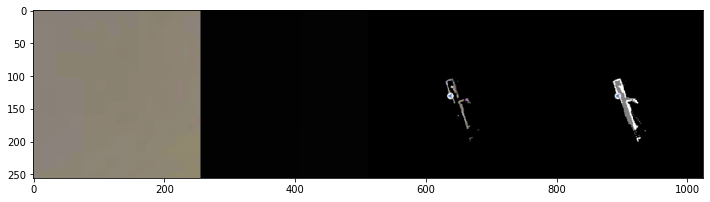

STEPS : 178 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


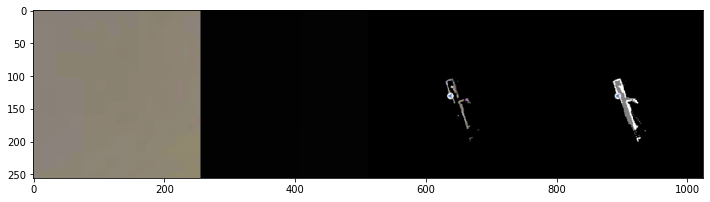

STEPS : 179 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


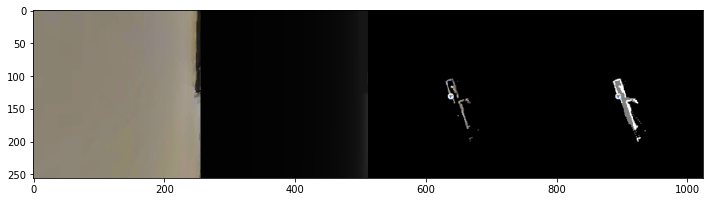

STEPS : 180 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


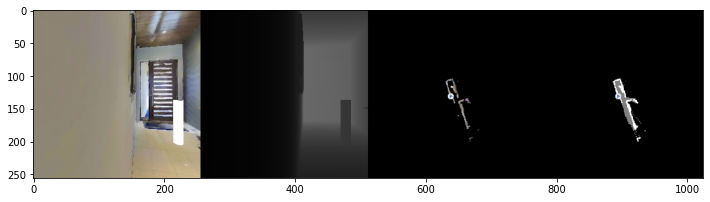

STEPS : 181 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


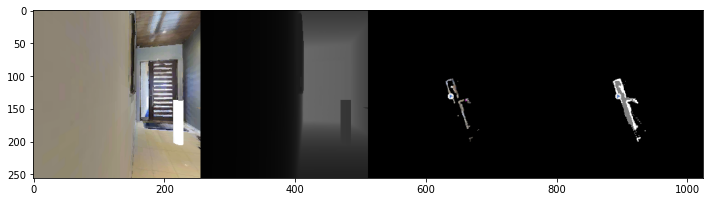

STEPS : 182 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


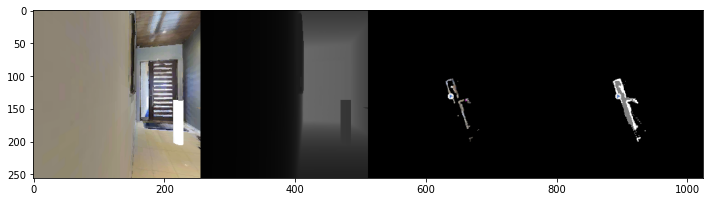

STEPS : 183 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


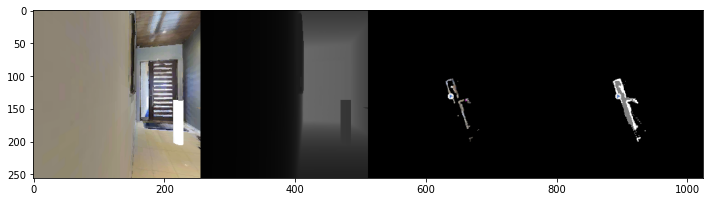

STEPS : 184 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


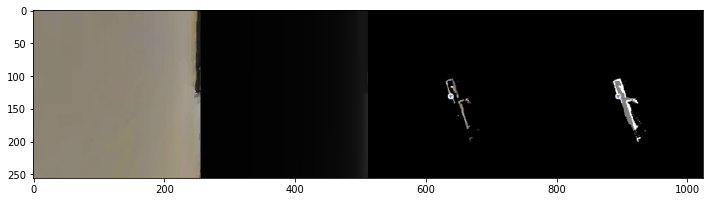

STEPS : 185 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


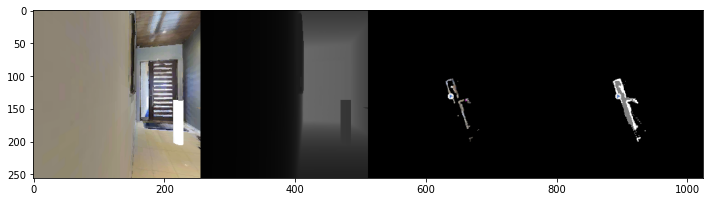

STEPS : 186 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


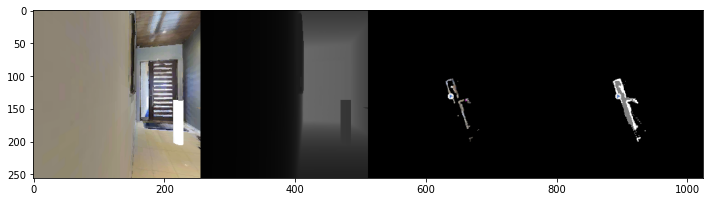

STEPS : 187 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


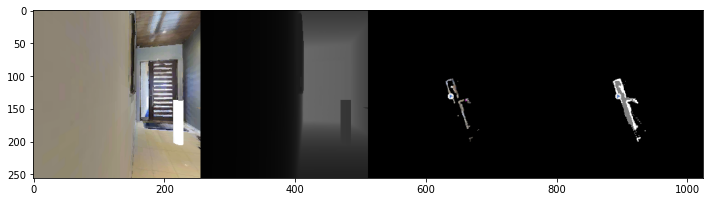

STEPS : 188 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


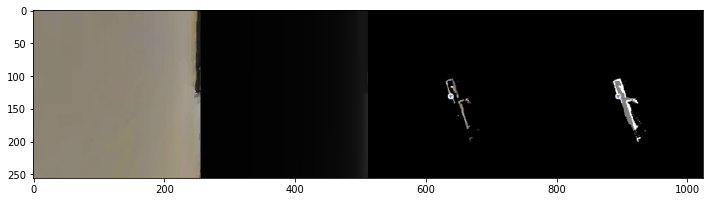

STEPS : 189 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


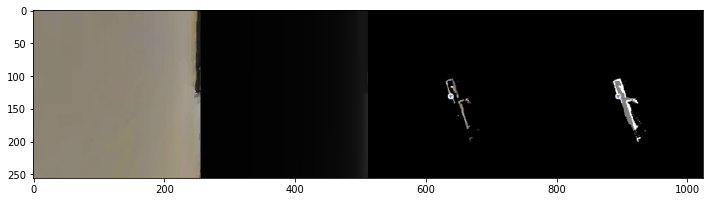

STEPS : 190 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


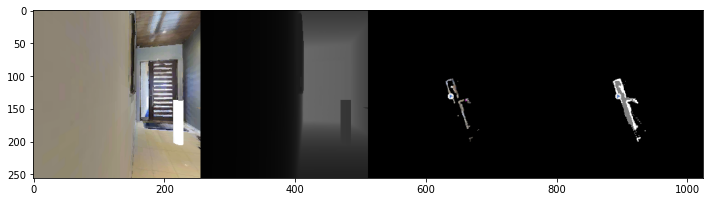

STEPS : 191 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


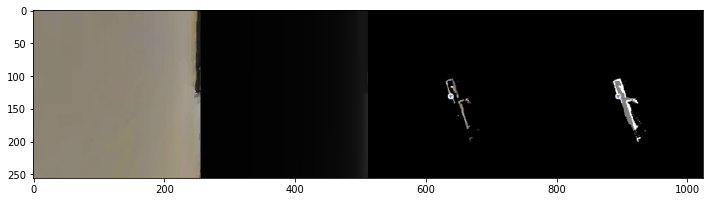

STEPS : 192 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


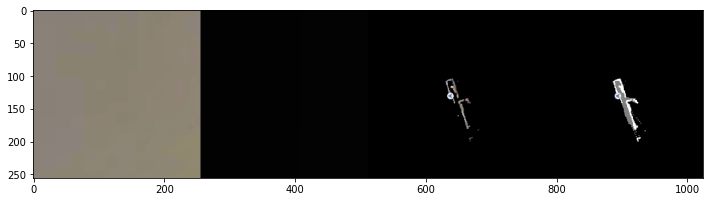

STEPS : 193 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


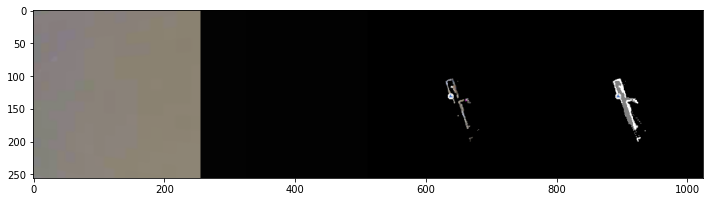

STEPS : 194 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


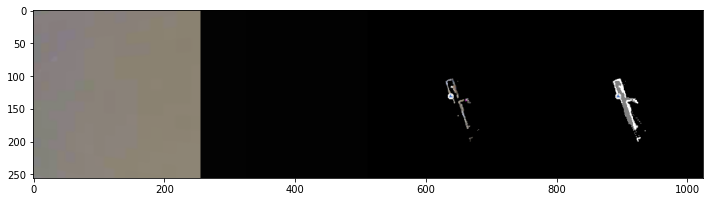

STEPS : 195 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


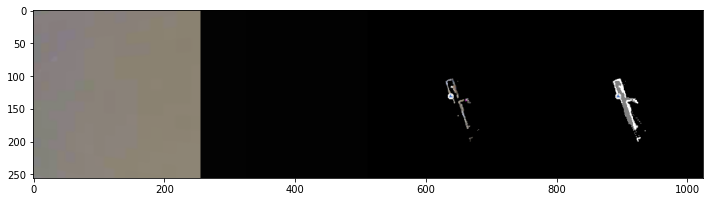

STEPS : 196 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


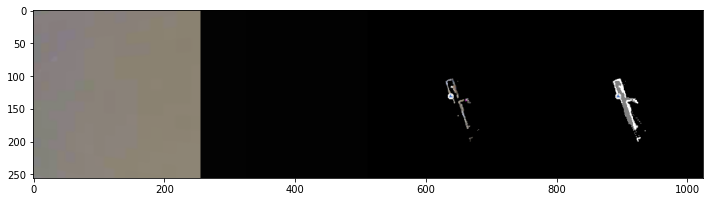

STEPS : 197 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


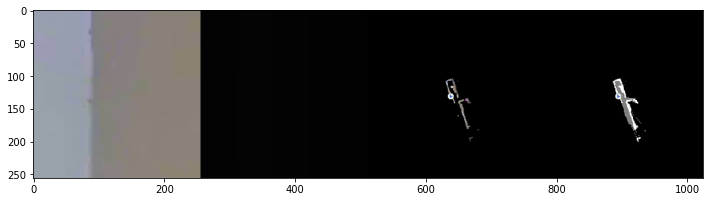

STEPS : 198 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


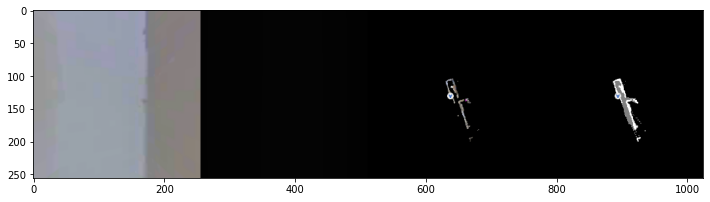

STEPS : 199 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


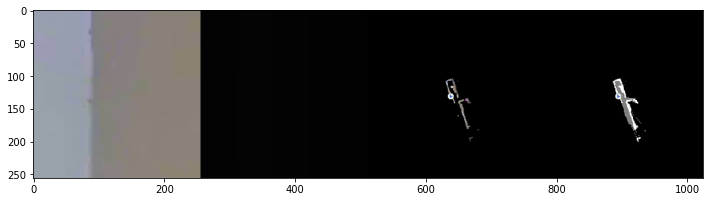

STEPS : 200 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


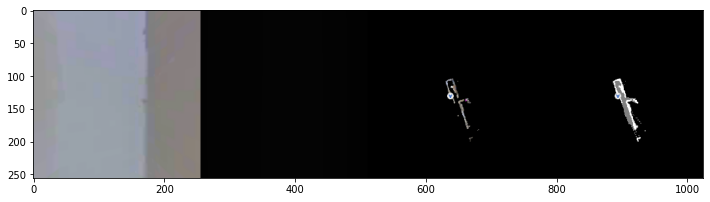

STEPS : 201 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


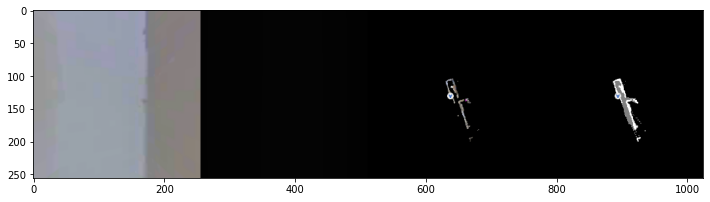

STEPS : 202 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


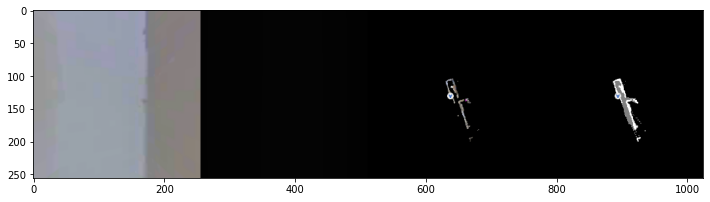

STEPS : 203 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


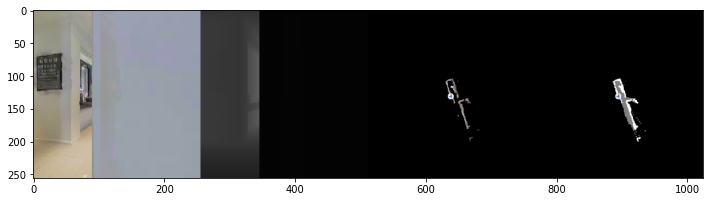

STEPS : 204 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


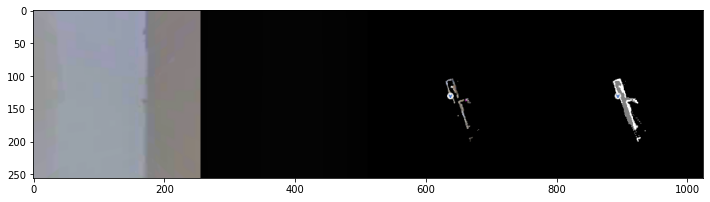

STEPS : 205 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


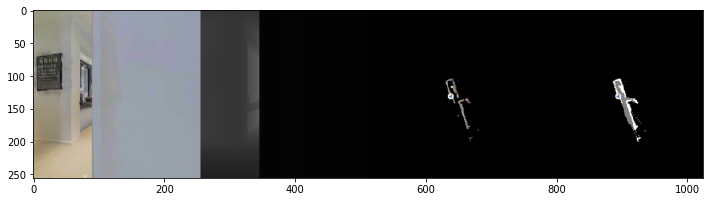

STEPS : 206 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


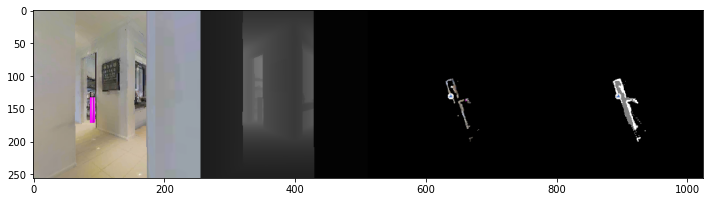

STEPS : 207 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


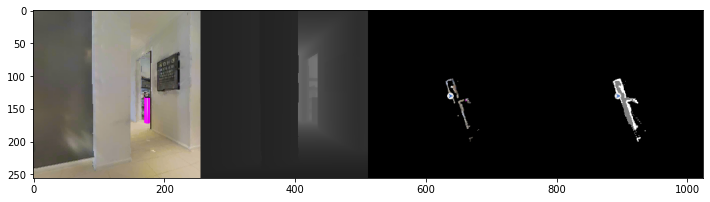

STEPS : 208 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


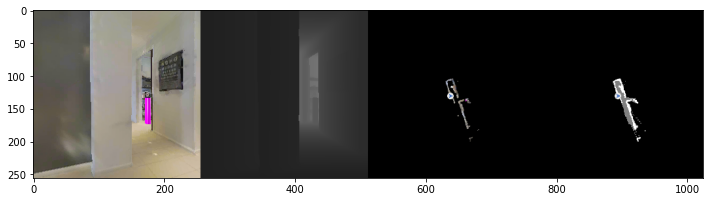

STEPS : 209 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


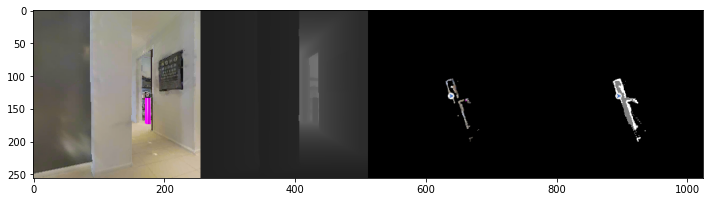

STEPS : 210 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


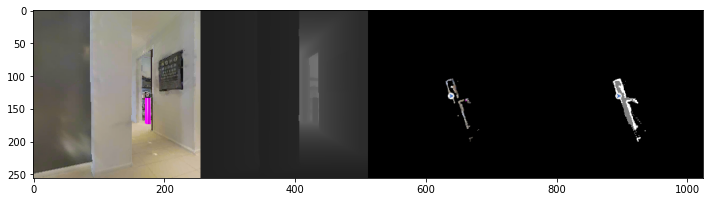

STEPS : 211 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


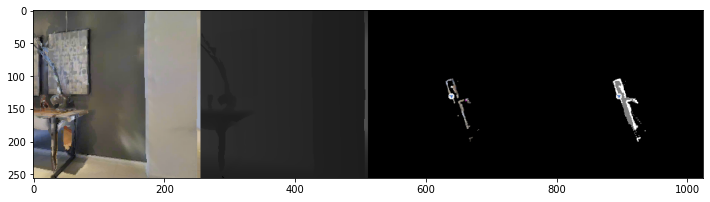

STEPS : 212 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


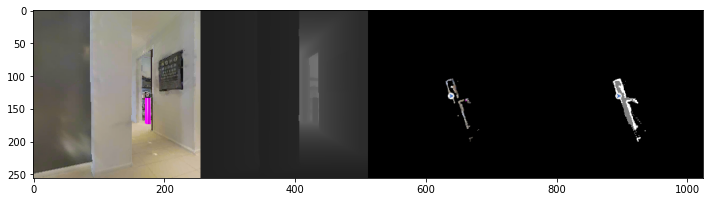

STEPS : 213 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


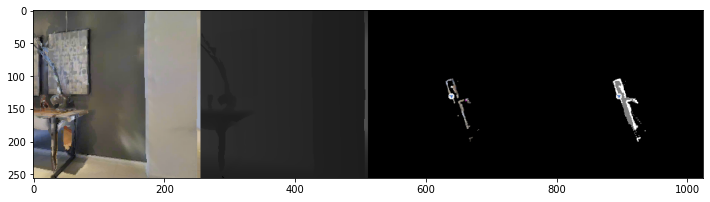

STEPS : 214 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


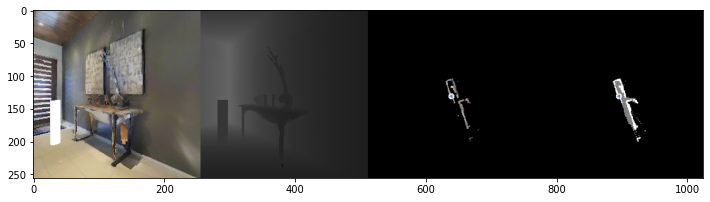

STEPS : 215 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


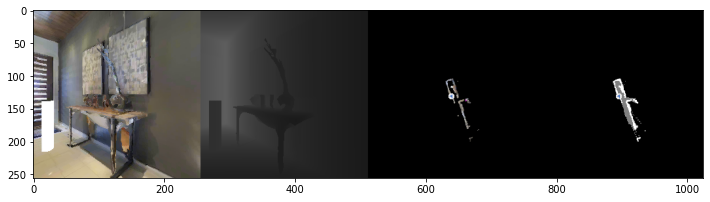

STEPS : 216 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


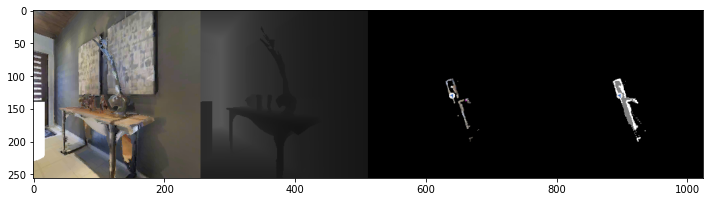

STEPS : 217 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


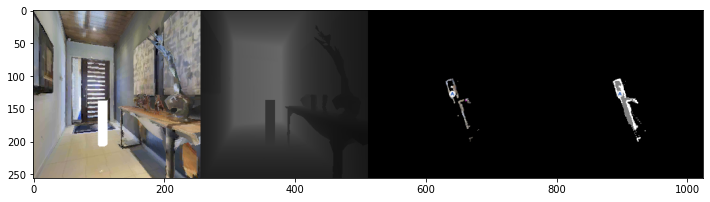

STEPS : 218 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


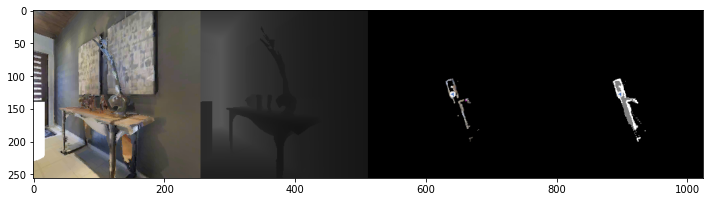

STEPS : 219 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


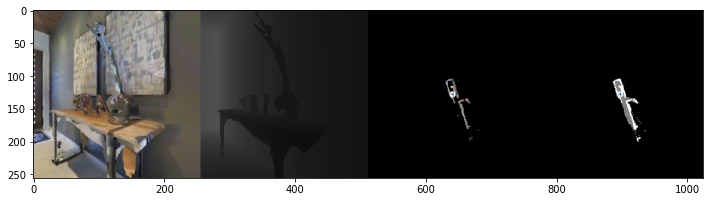

STEPS : 220 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


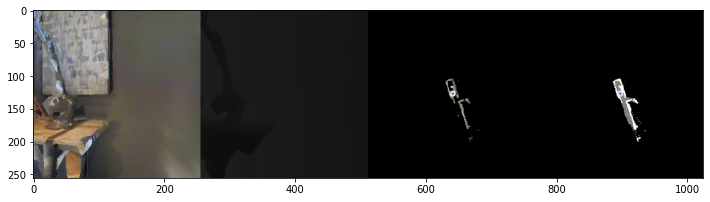

STEPS : 221 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


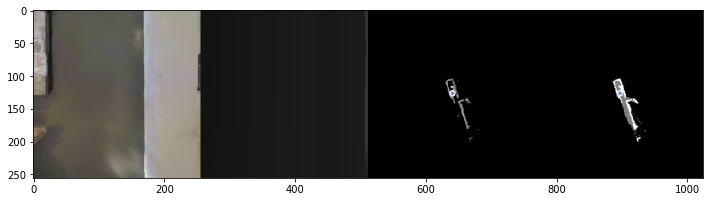

STEPS : 222 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


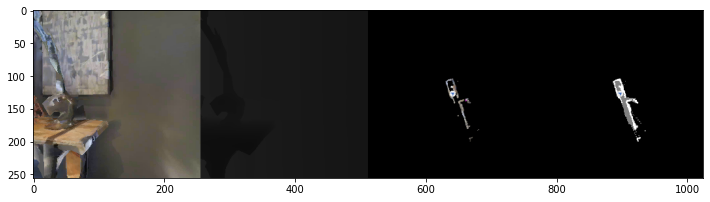

STEPS : 223 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


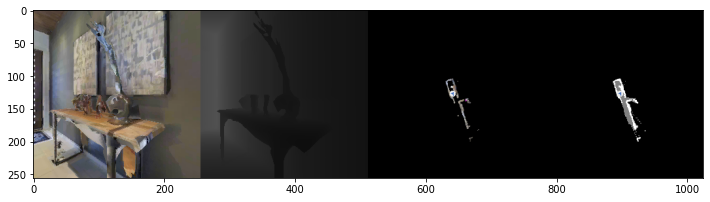

STEPS : 224 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


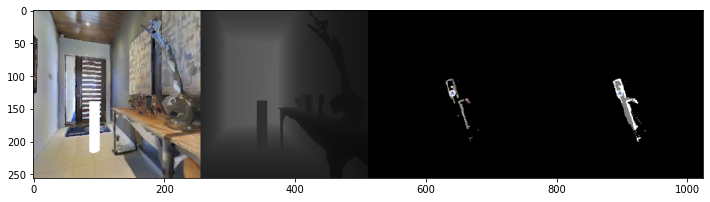

STEPS : 225 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


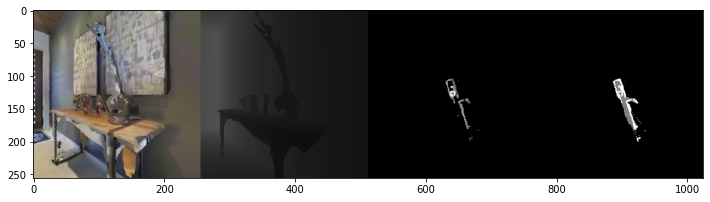

STEPS : 226 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


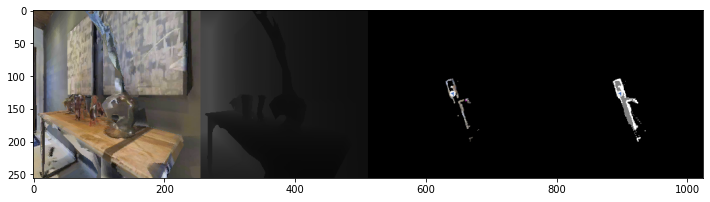

STEPS : 227 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


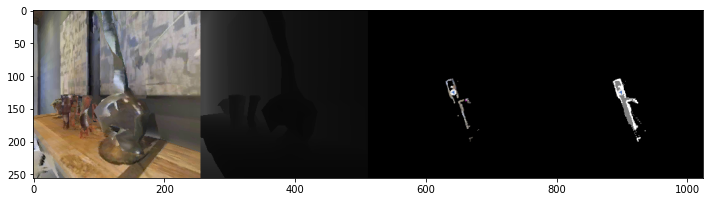

STEPS : 228 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


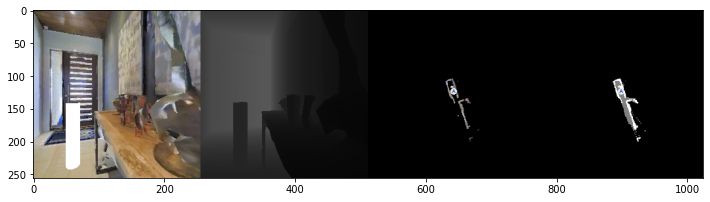

STEPS : 229 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


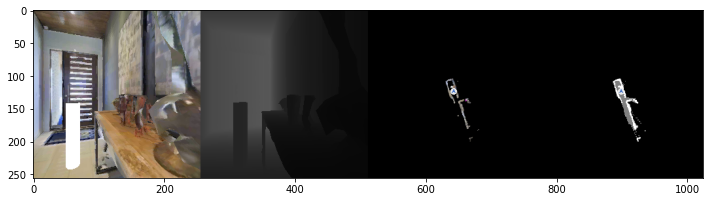

STEPS : 230 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


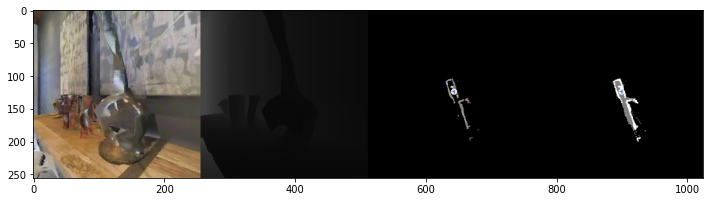

STEPS : 231 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


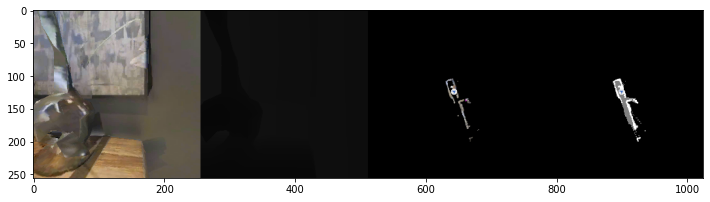

STEPS : 232 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


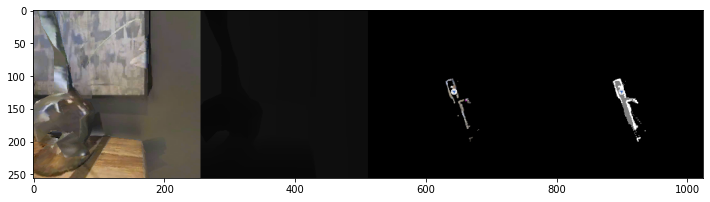

STEPS : 233 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


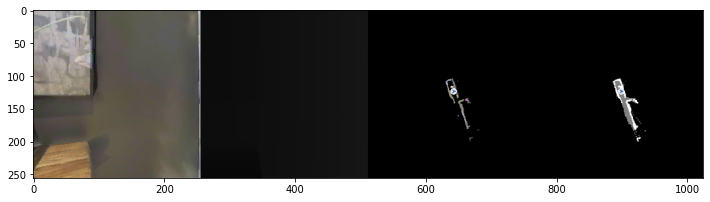

STEPS : 234 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


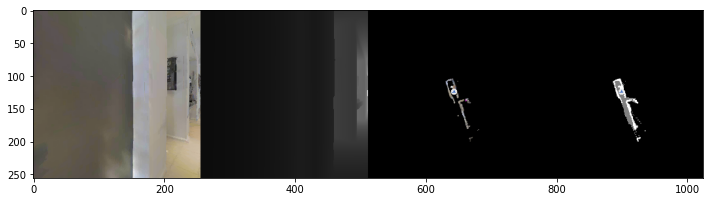

STEPS : 235 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


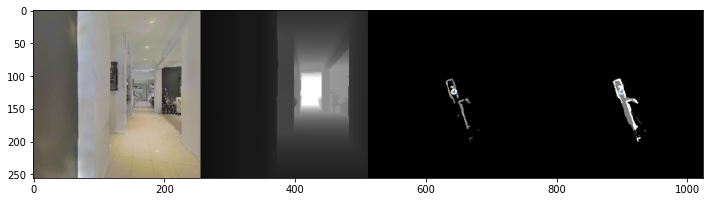

STEPS : 236 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


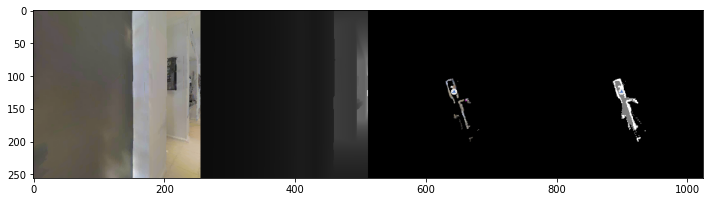

STEPS : 237 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


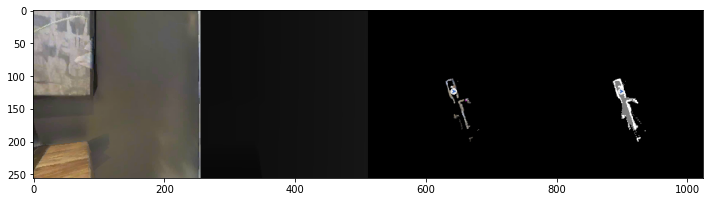

STEPS : 238 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


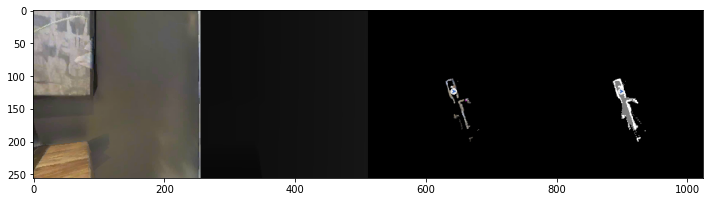

STEPS : 239 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


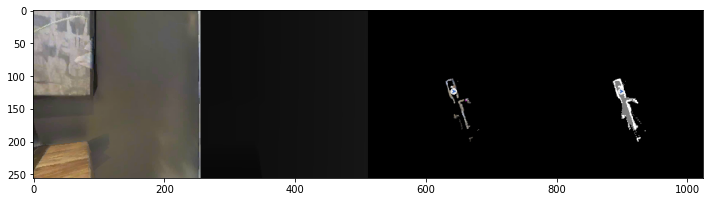

STEPS : 240 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


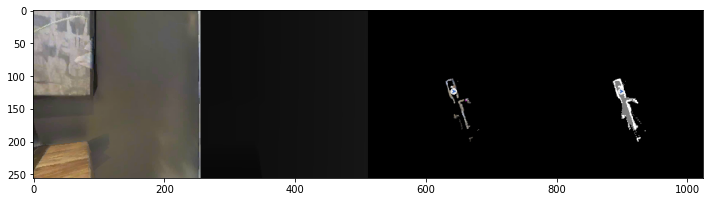

STEPS : 241 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


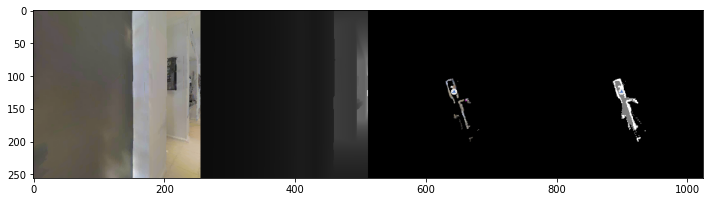

STEPS : 242 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


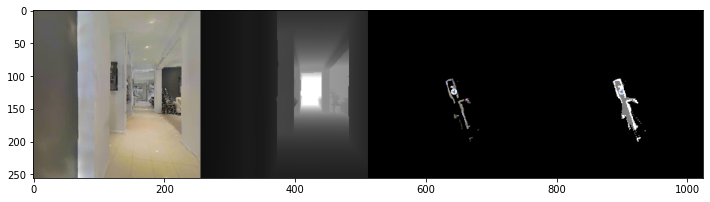

STEPS : 243 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


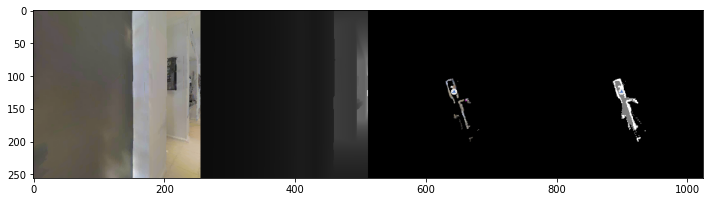

STEPS : 244 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


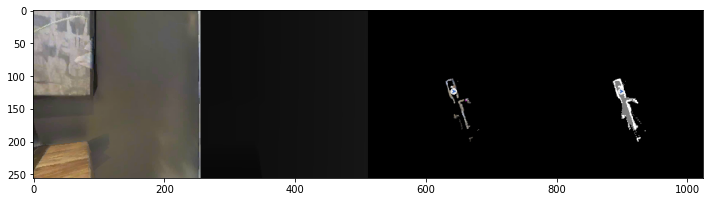

STEPS : 245 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


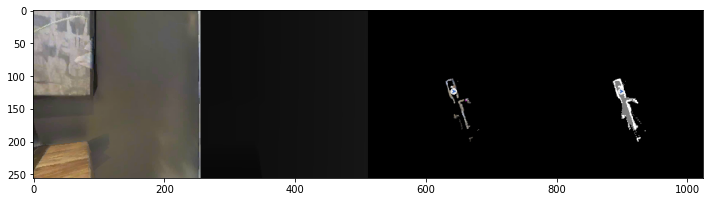

STEPS : 246 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


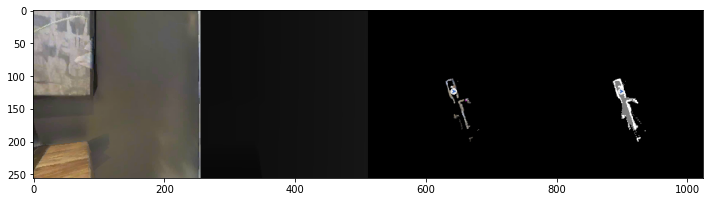

STEPS : 247 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


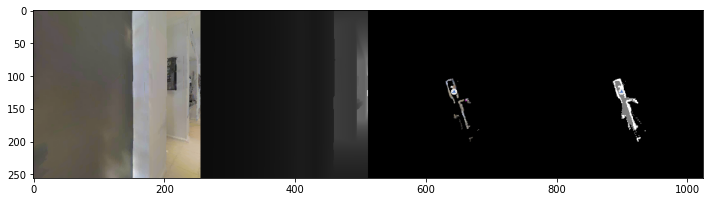

STEPS : 248 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


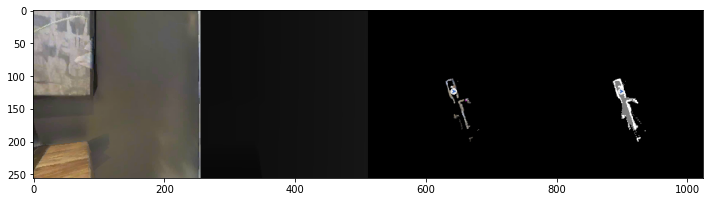

STEPS : 249 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


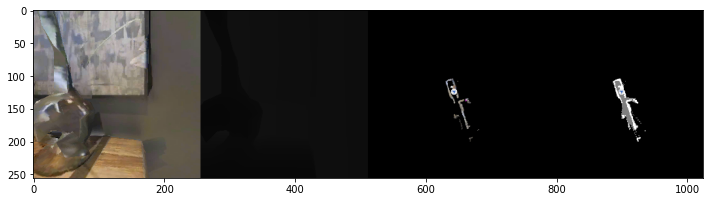

STEPS : 250 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


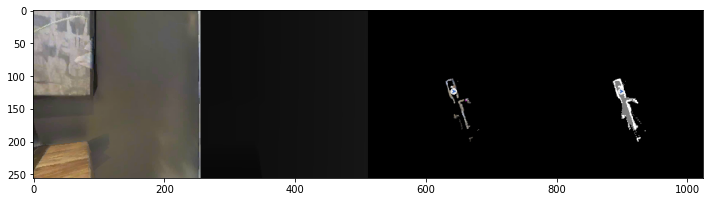

STEPS : 251 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


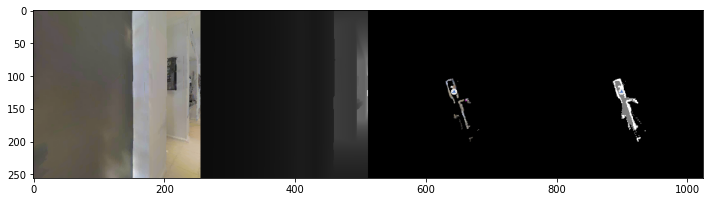

STEPS : 252 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


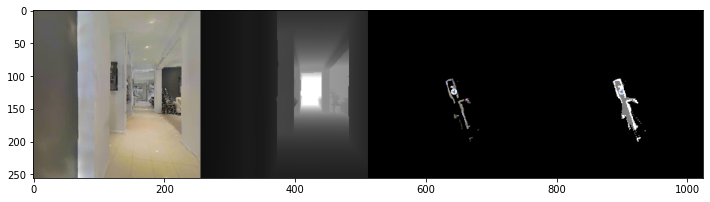

STEPS : 253 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


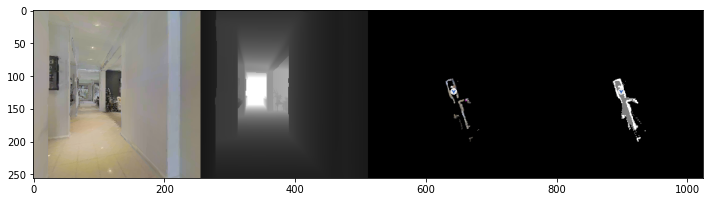

STEPS : 254 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


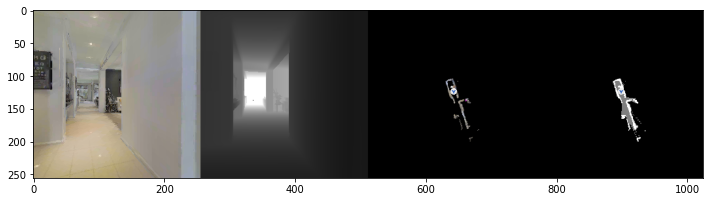

STEPS : 255 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


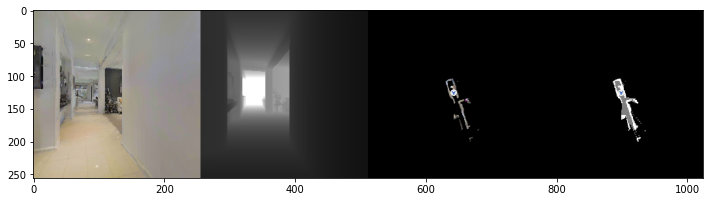

STEPS : 256 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


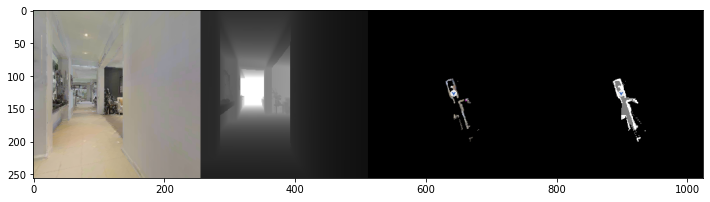

STEPS : 257 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


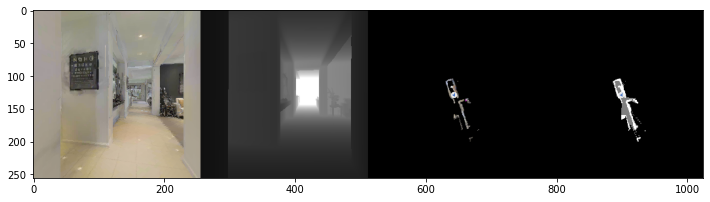

STEPS : 258 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


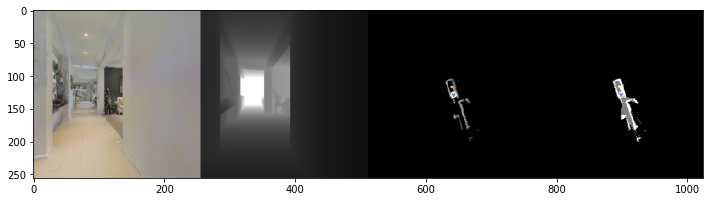

STEPS : 259 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


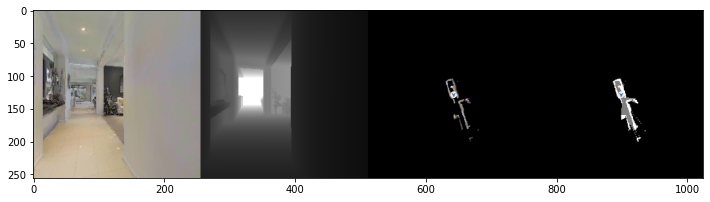

STEPS : 260 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


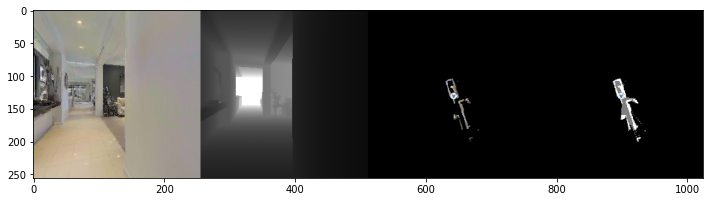

STEPS : 261 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


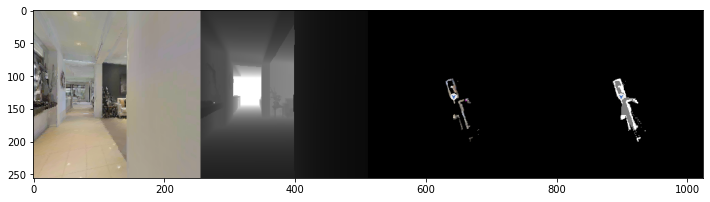

STEPS : 262 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


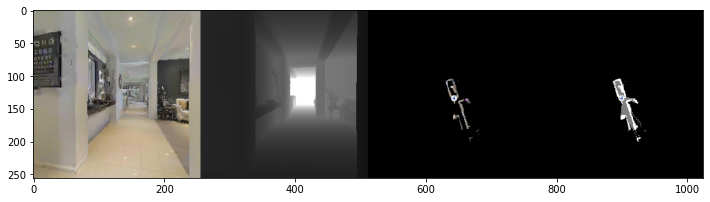

STEPS : 263 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


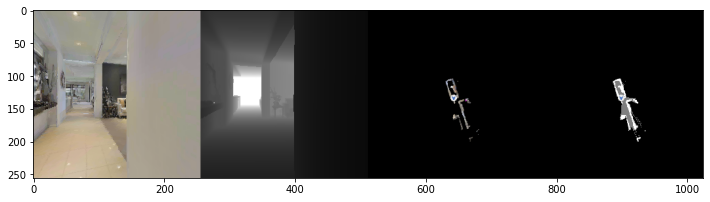

STEPS : 264 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


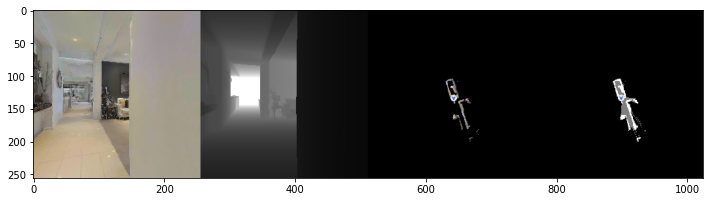

STEPS : 265 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


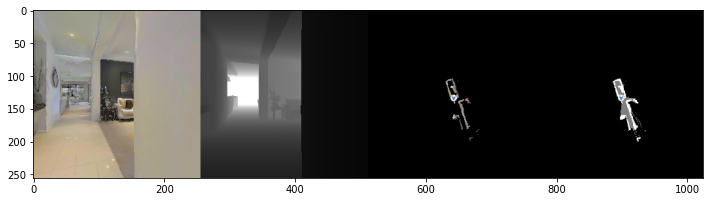

STEPS : 266 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


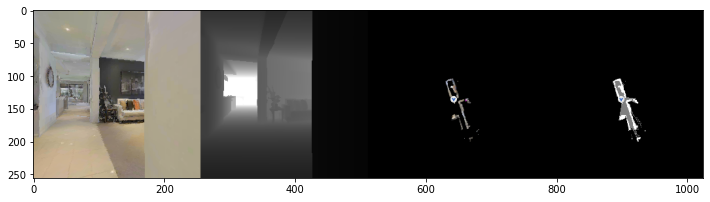

STEPS : 267 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


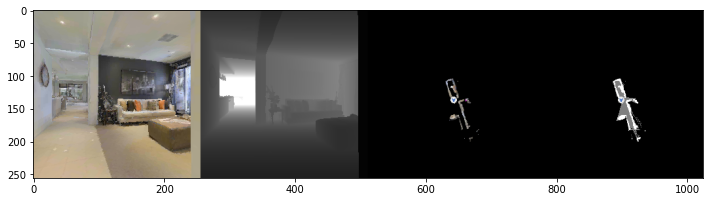

STEPS : 268 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


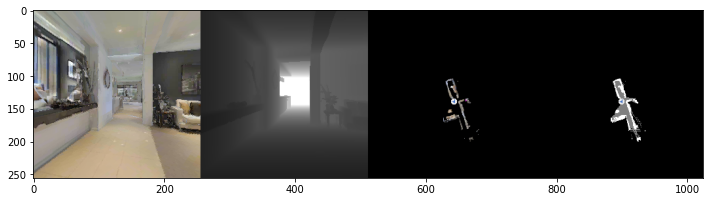

STEPS : 269 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


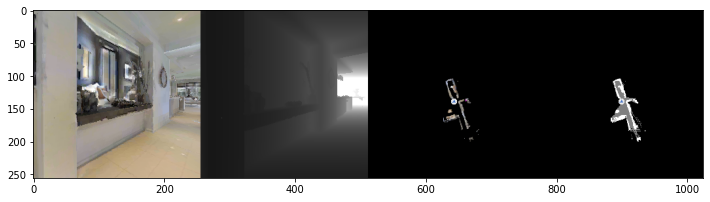

STEPS : 270 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


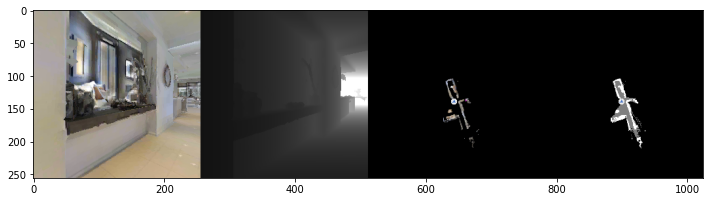

STEPS : 271 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


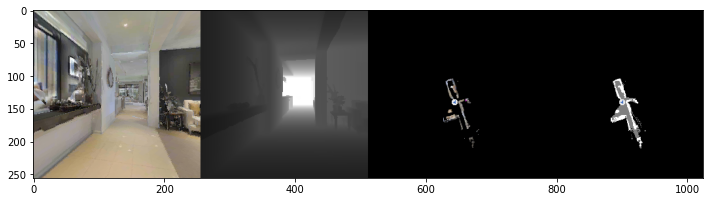

STEPS : 272 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


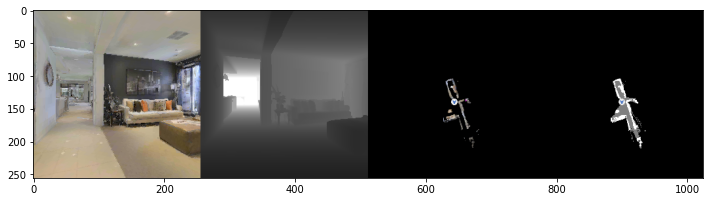

STEPS : 273 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


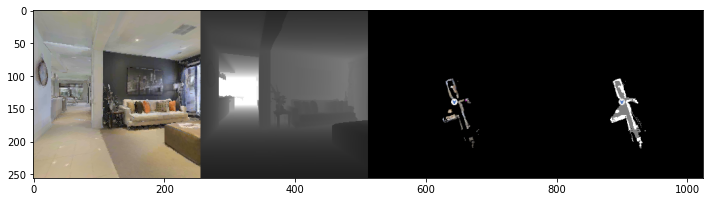

STEPS : 274 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


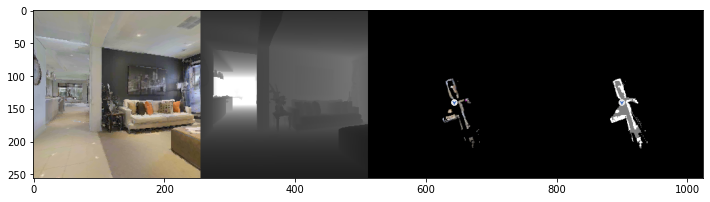

STEPS : 275 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


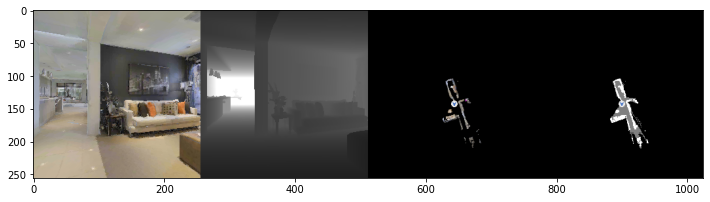

STEPS : 276 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


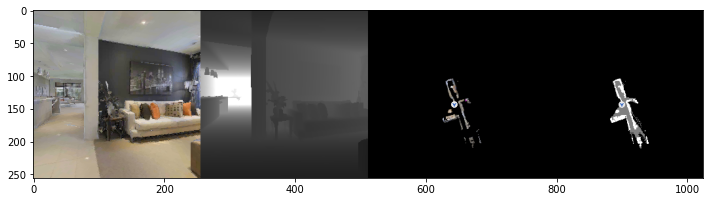

STEPS : 277 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


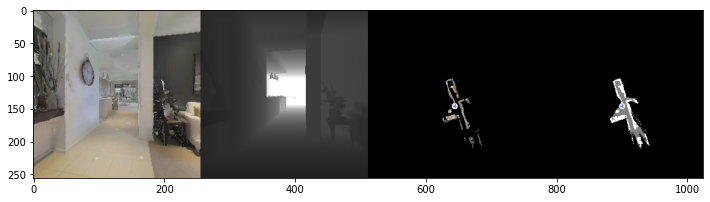

STEPS : 278 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


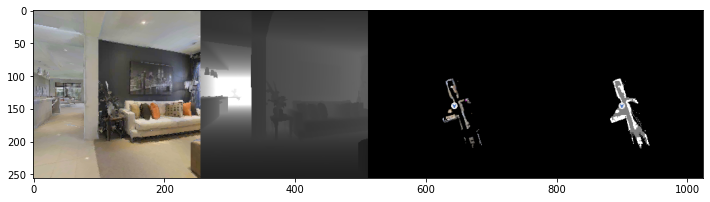

STEPS : 279 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


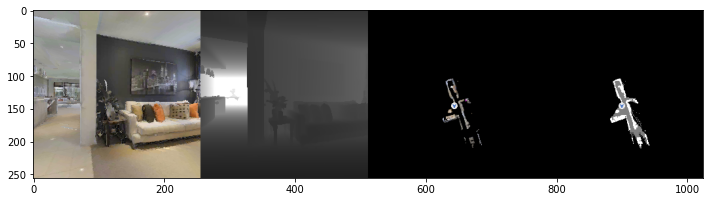

STEPS : 280 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


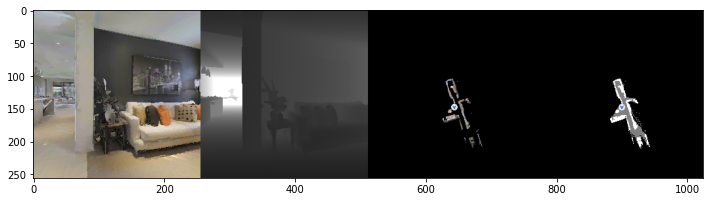

STEPS : 281 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


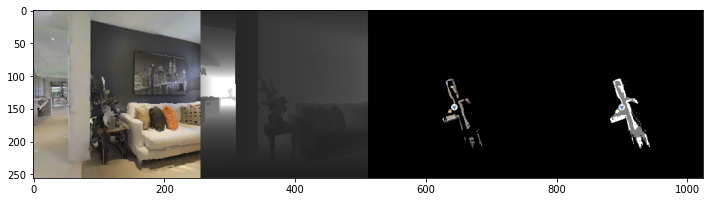

STEPS : 282 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


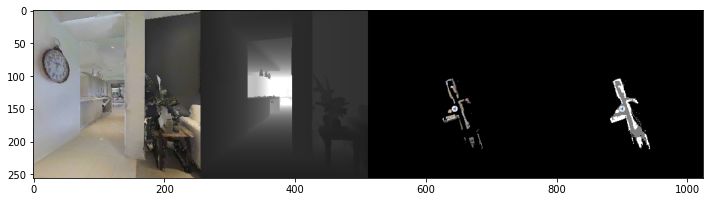

STEPS : 283 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


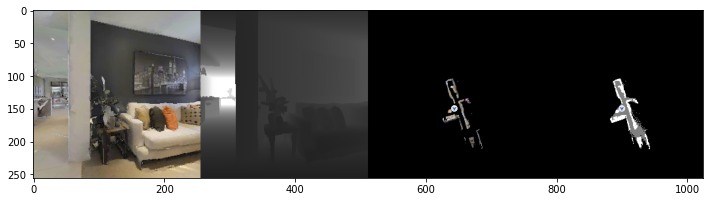

STEPS : 284 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


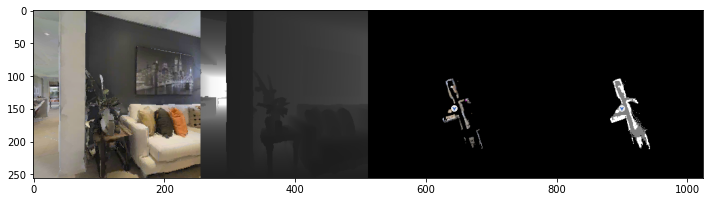

STEPS : 285 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


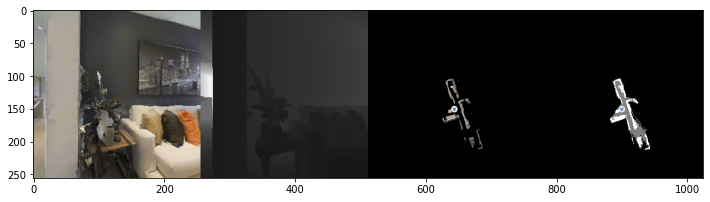

STEPS : 286 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


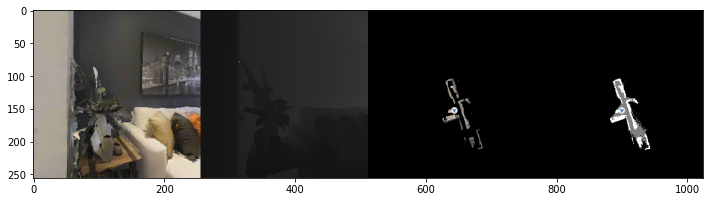

STEPS : 287 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


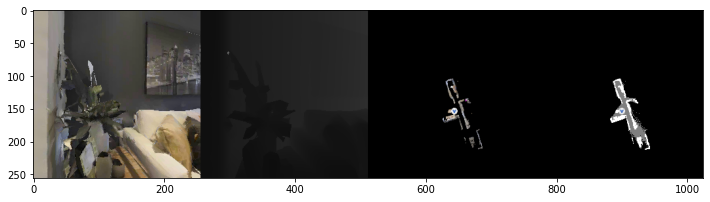

STEPS : 288 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


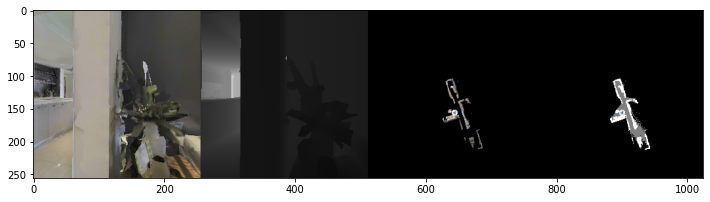

STEPS : 289 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


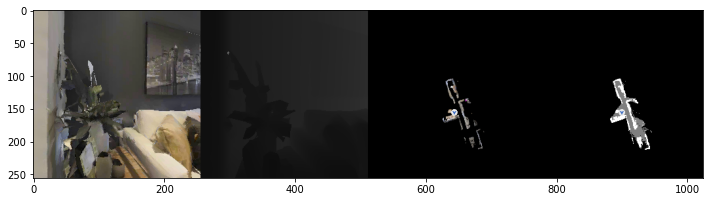

STEPS : 290 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


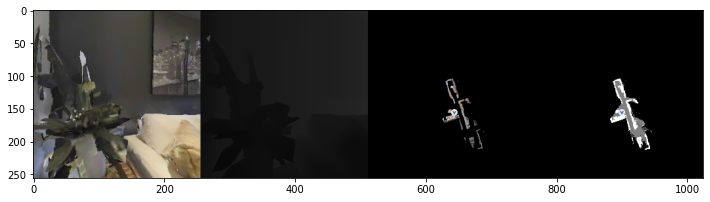

STEPS : 291 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


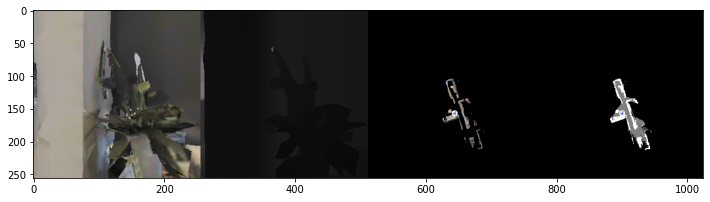

STEPS : 292 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


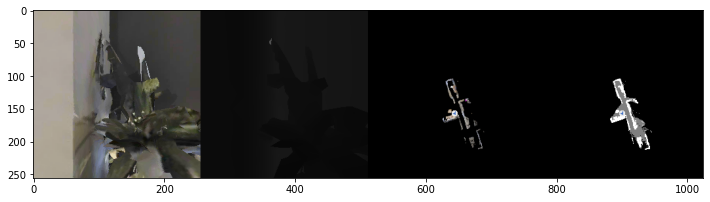

STEPS : 293 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


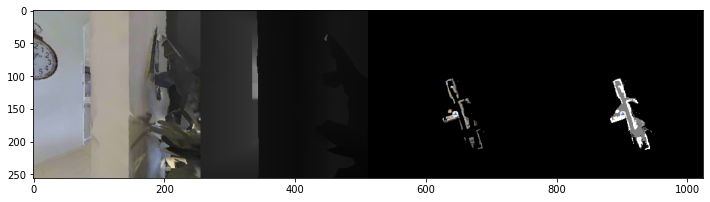

STEPS : 294 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


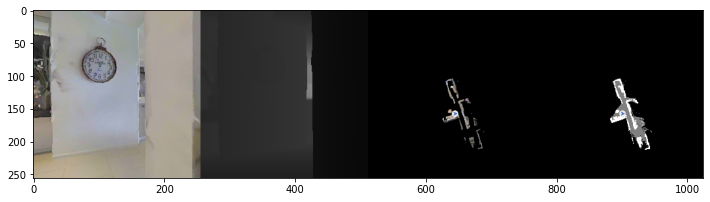

STEPS : 295 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


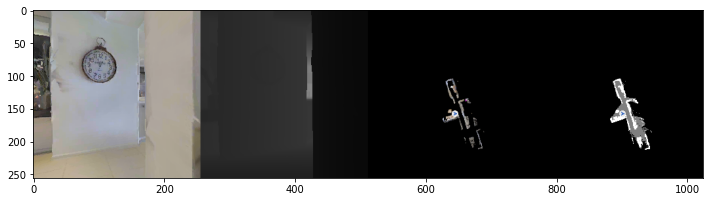

STEPS : 296 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


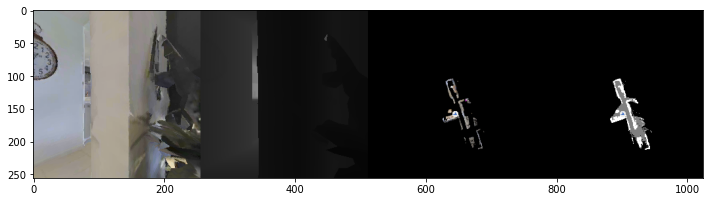

STEPS : 297 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


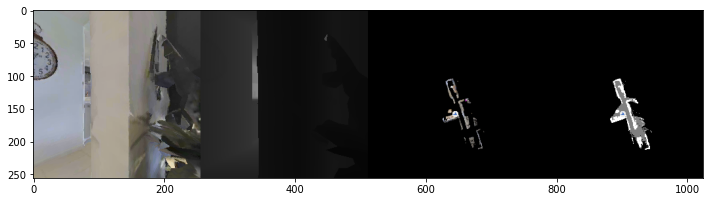

STEPS : 298 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


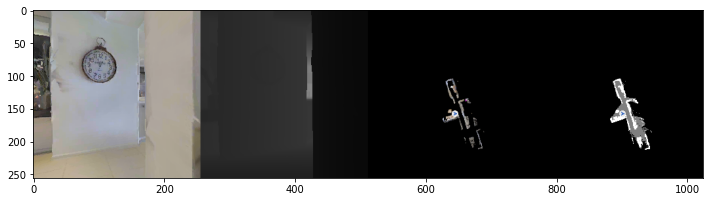

STEPS : 299 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


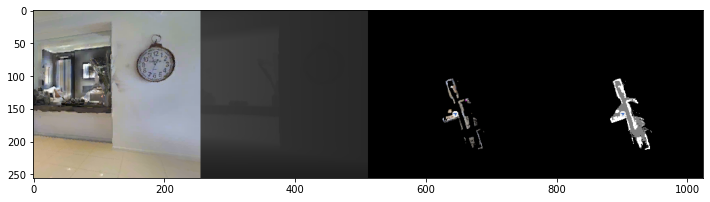

STEPS : 300 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


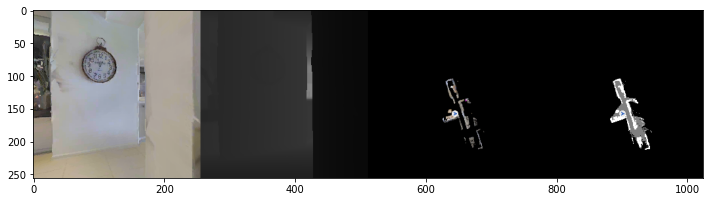

STEPS : 301 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


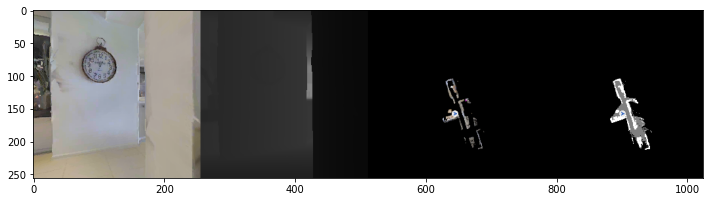

STEPS : 302 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


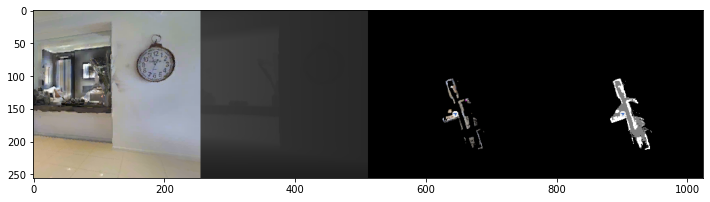

STEPS : 303 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


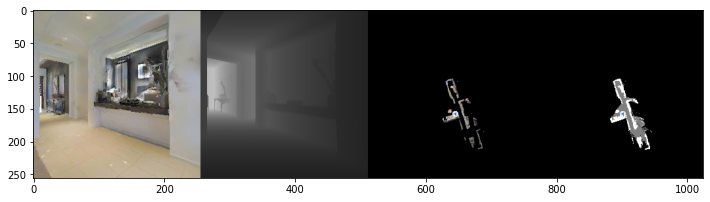

STEPS : 304 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


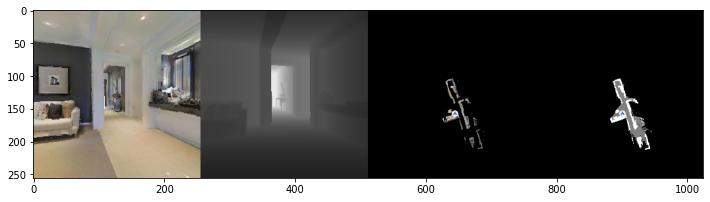

STEPS : 305 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


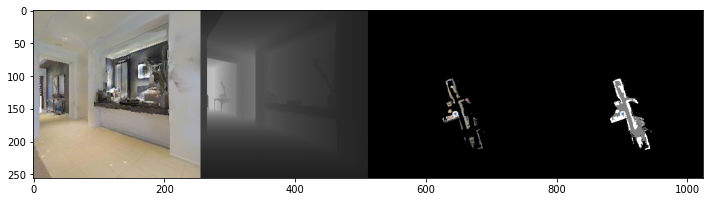

STEPS : 306 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


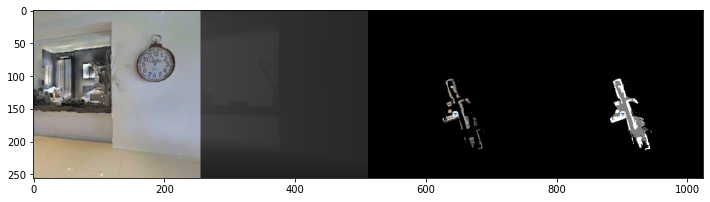

STEPS : 307 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


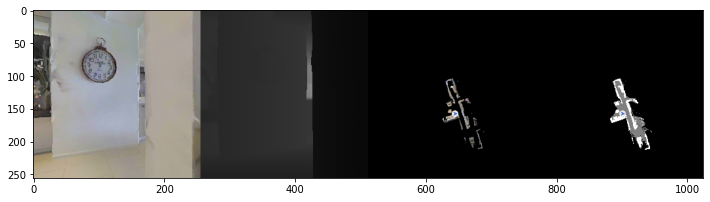

STEPS : 308 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


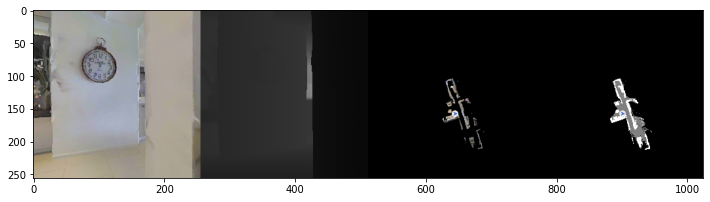

STEPS : 309 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


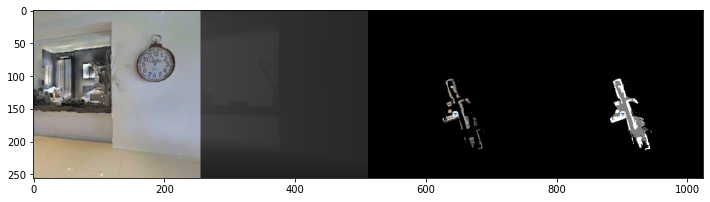

STEPS : 310 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


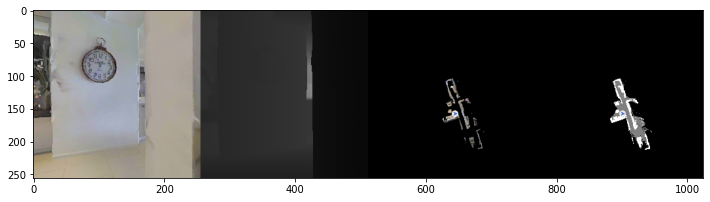

STEPS : 311 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


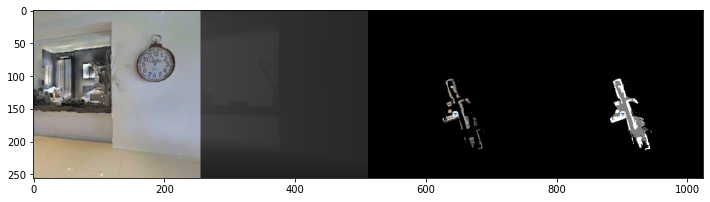

STEPS : 312 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


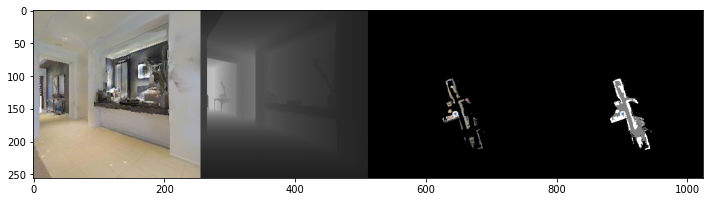

STEPS : 313 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


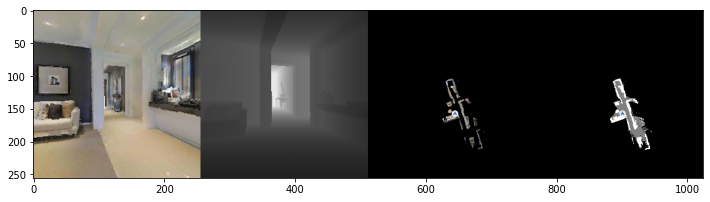

STEPS : 314 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


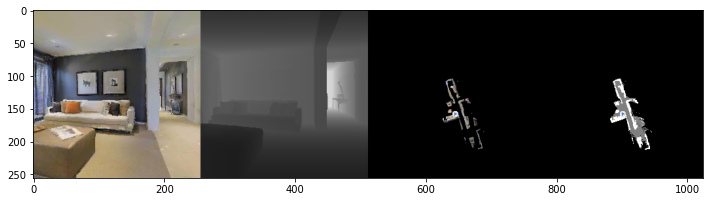

STEPS : 315 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


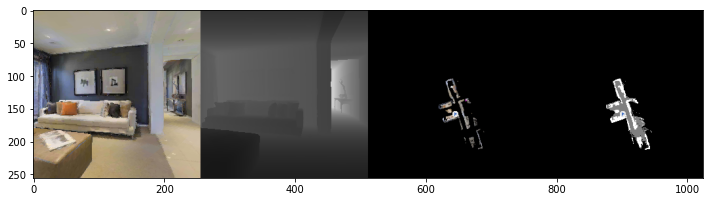

STEPS : 316 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


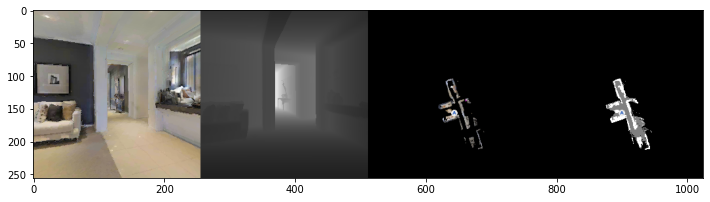

STEPS : 317 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


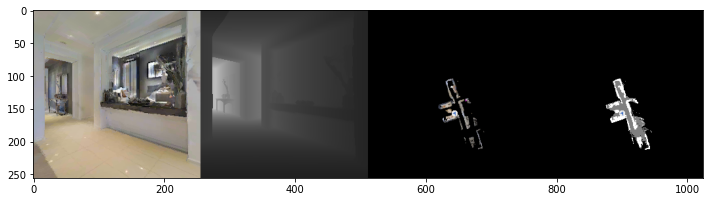

STEPS : 318 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


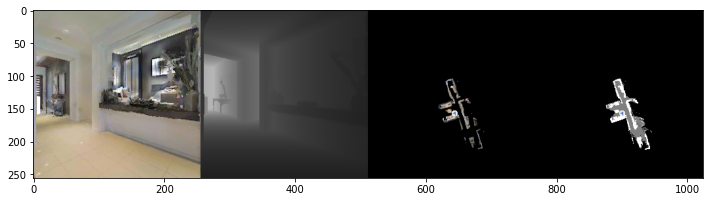

STEPS : 319 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


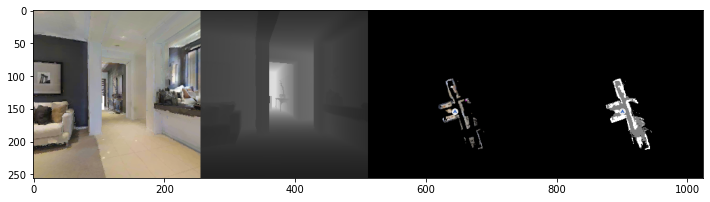

STEPS : 320 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


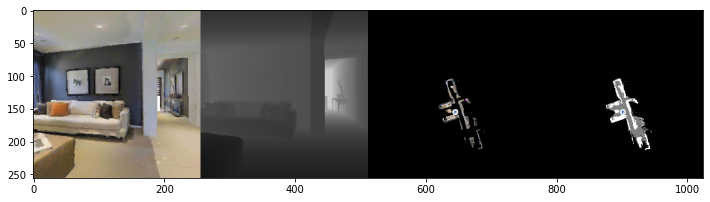

STEPS : 321 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


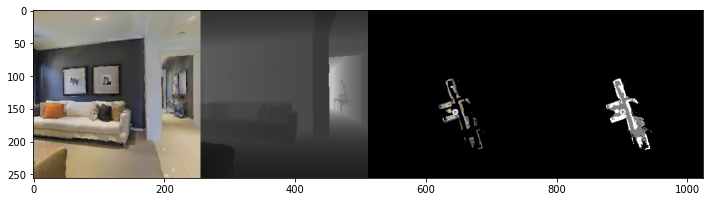

STEPS : 322 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


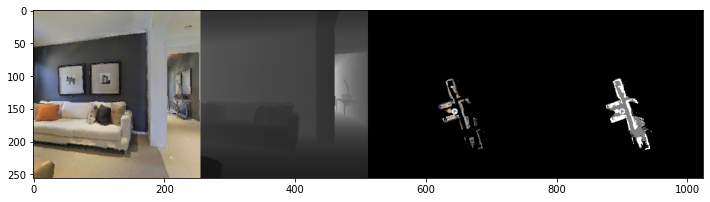

STEPS : 323 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


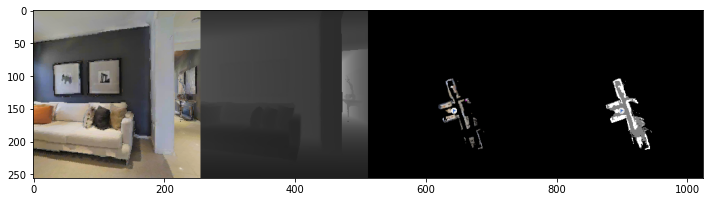

STEPS : 324 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


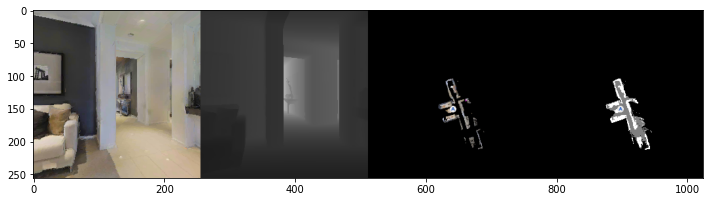

STEPS : 325 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


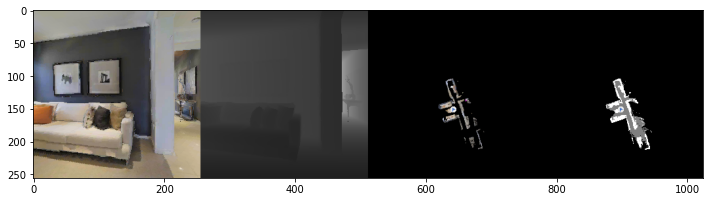

STEPS : 326 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


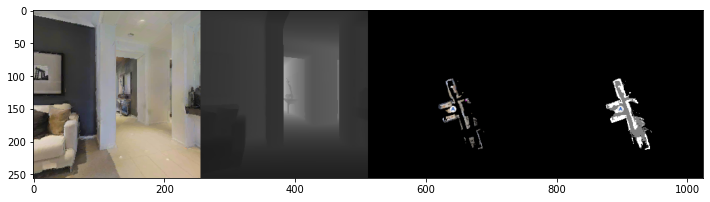

STEPS : 327 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


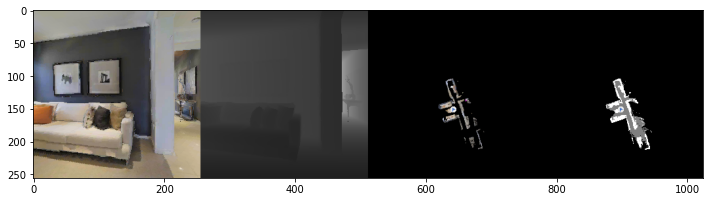

STEPS : 328 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


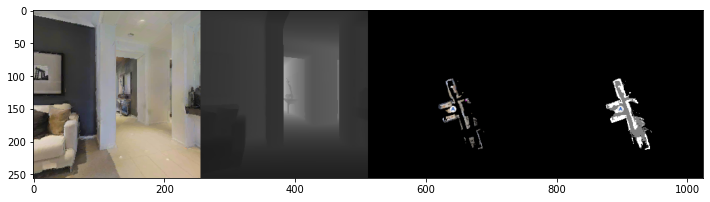

STEPS : 329 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


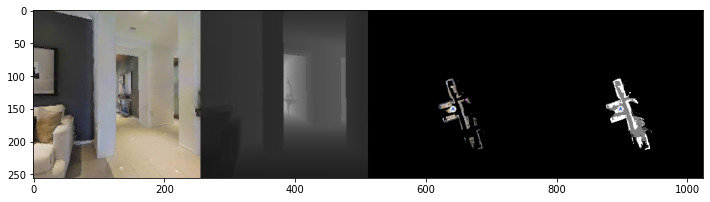

STEPS : 330 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


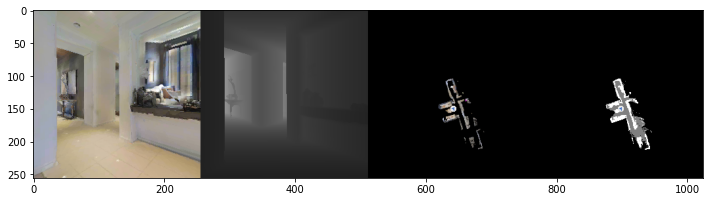

STEPS : 331 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


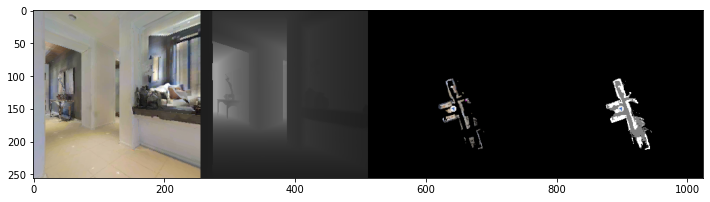

STEPS : 332 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


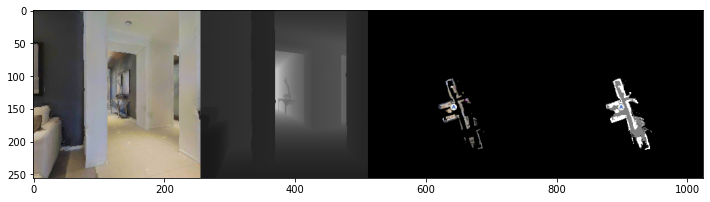

STEPS : 333 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


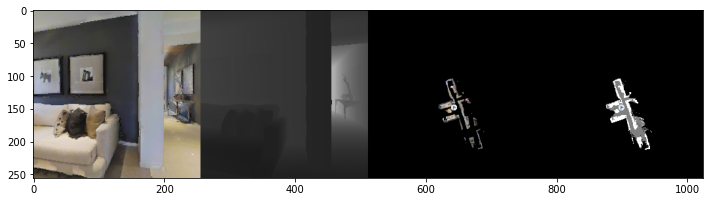

STEPS : 334 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


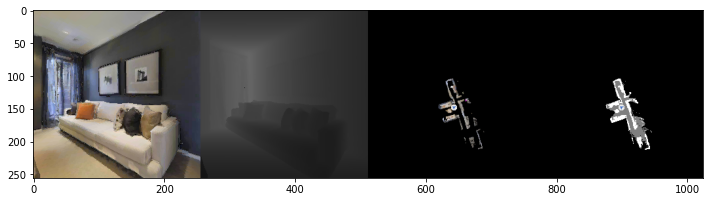

STEPS : 335 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


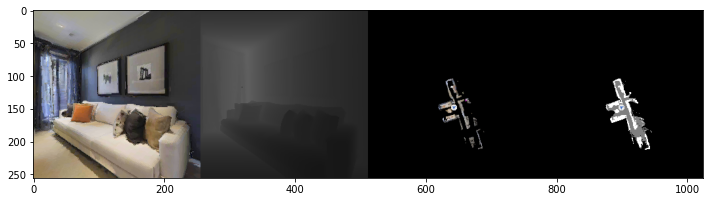

STEPS : 336 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


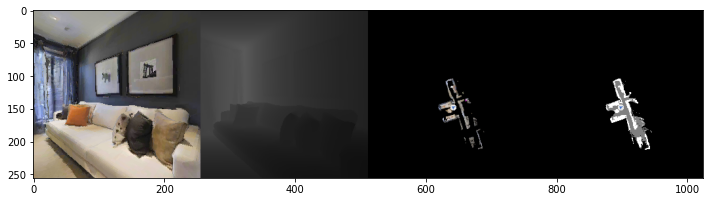

STEPS : 337 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


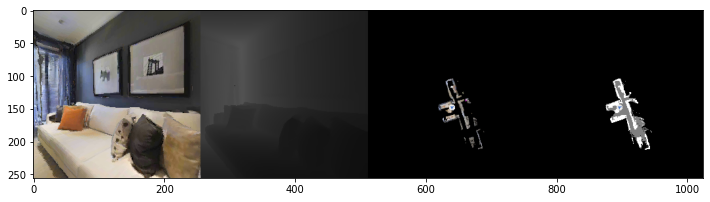

STEPS : 338 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


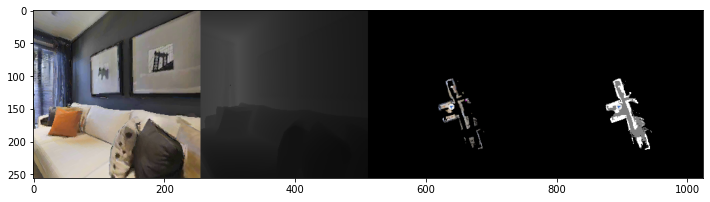

STEPS : 339 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


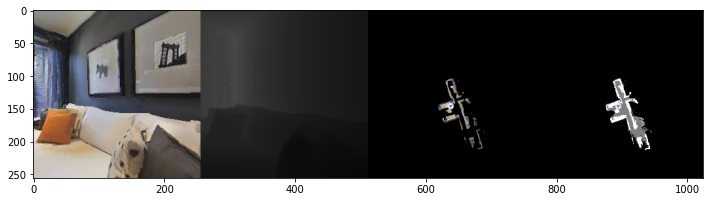

STEPS : 340 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


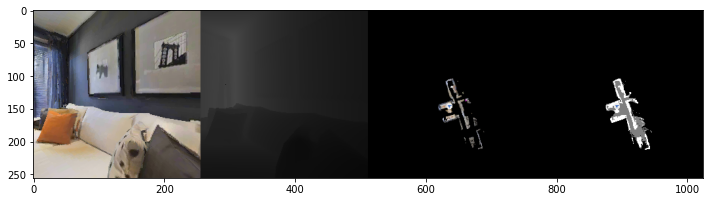

STEPS : 341 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


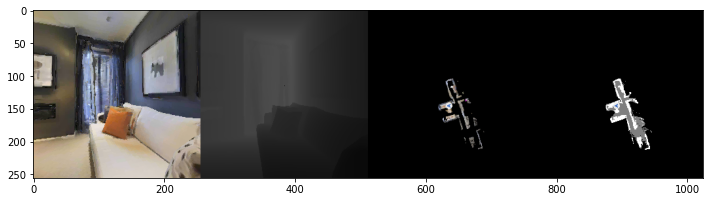

STEPS : 342 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


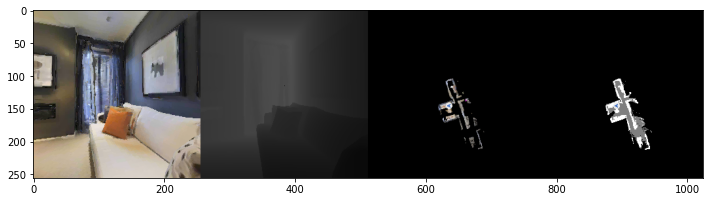

STEPS : 343 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


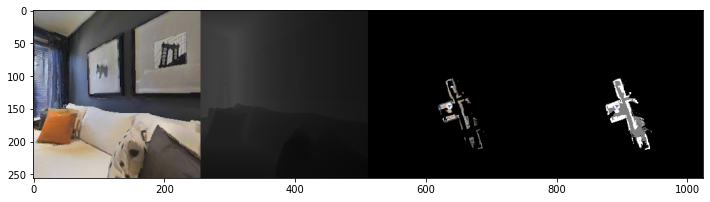

STEPS : 344 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


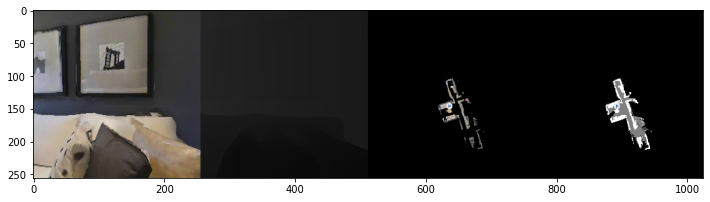

STEPS : 345 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


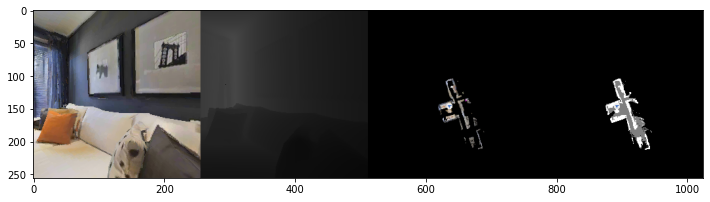

STEPS : 346 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


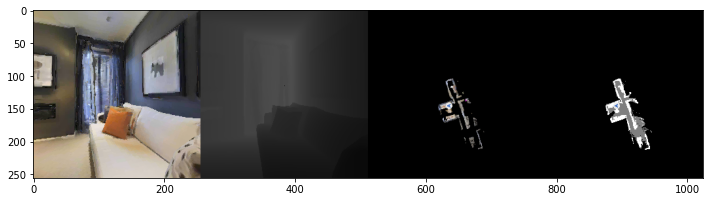

STEPS : 347 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


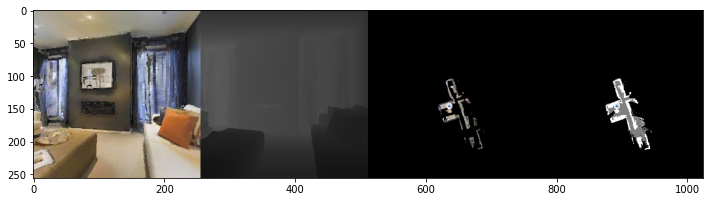

STEPS : 348 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


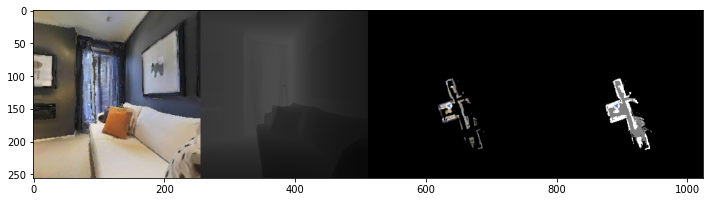

STEPS : 349 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


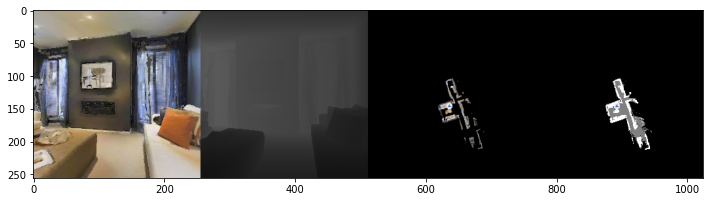

STEPS : 350 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


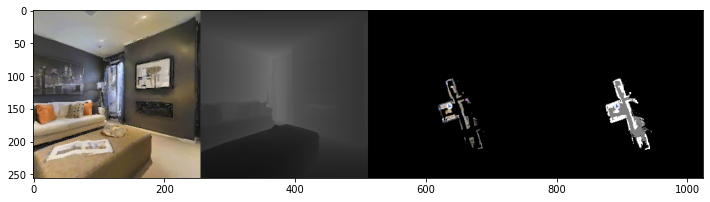

STEPS : 351 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


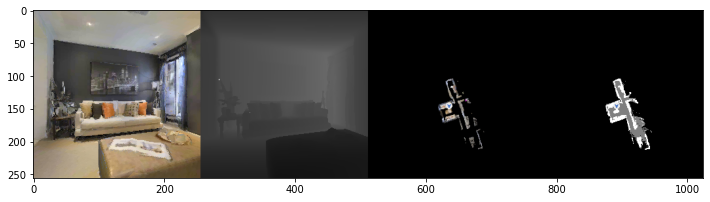

STEPS : 352 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


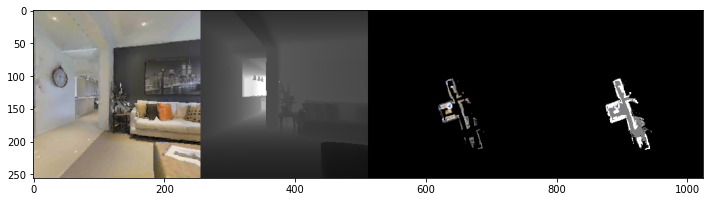

STEPS : 353 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


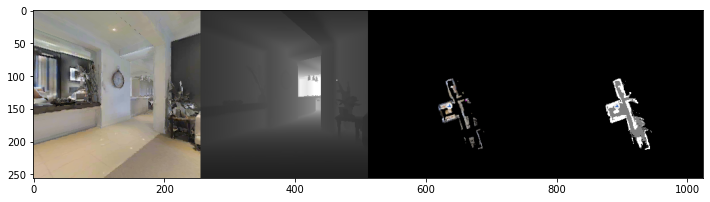

STEPS : 354 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


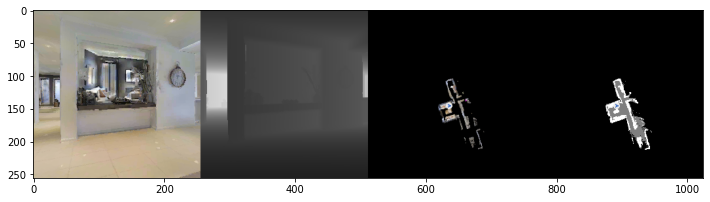

STEPS : 355 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


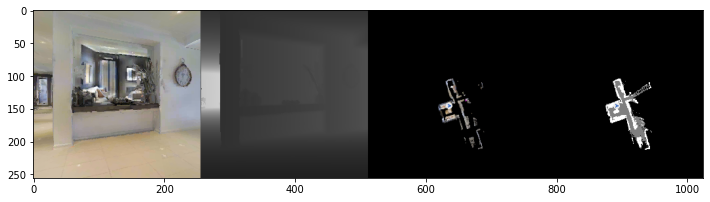

STEPS : 356 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


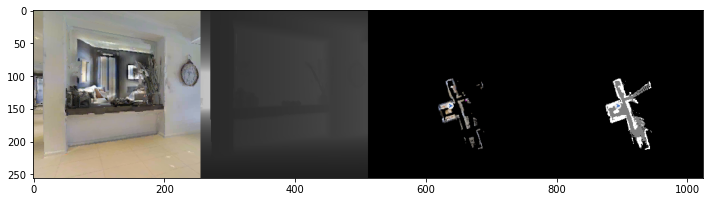

STEPS : 357 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


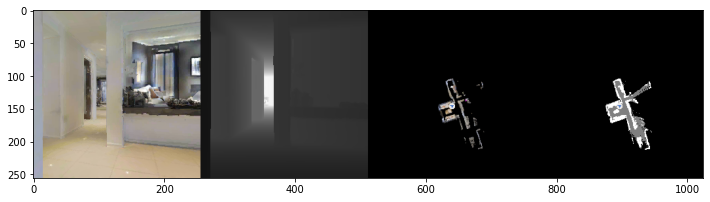

STEPS : 358 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


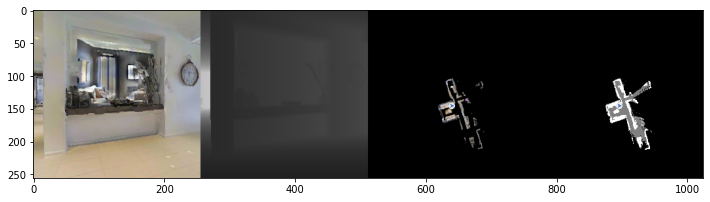

STEPS : 359 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


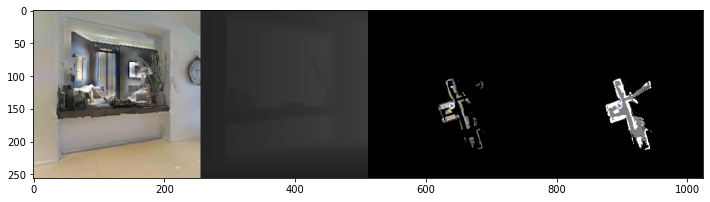

STEPS : 360 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


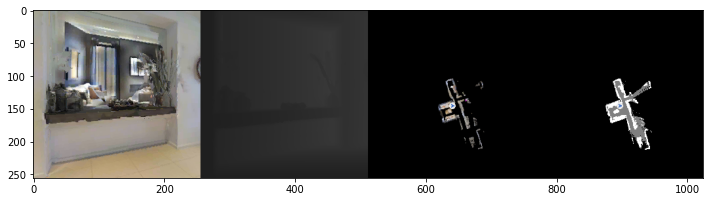

STEPS : 361 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


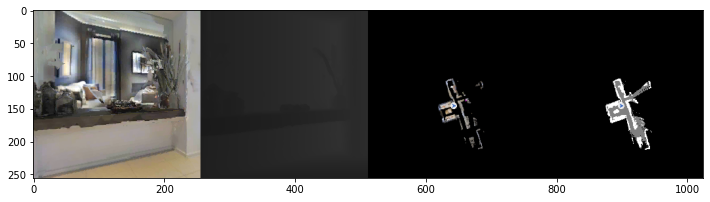

STEPS : 362 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


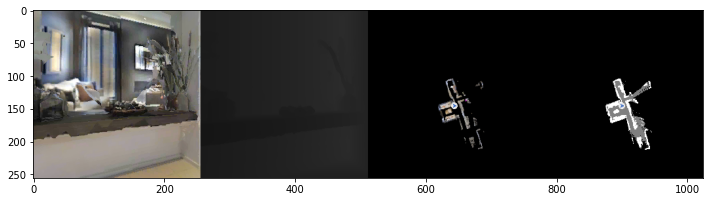

STEPS : 363 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


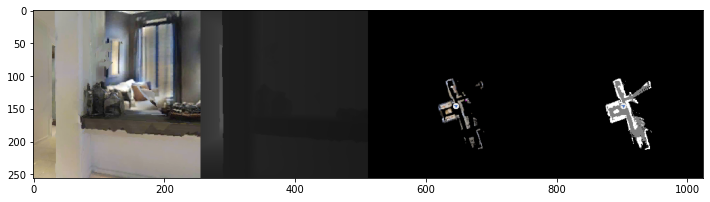

STEPS : 364 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


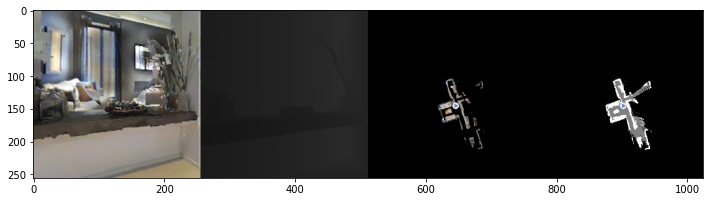

STEPS : 365 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


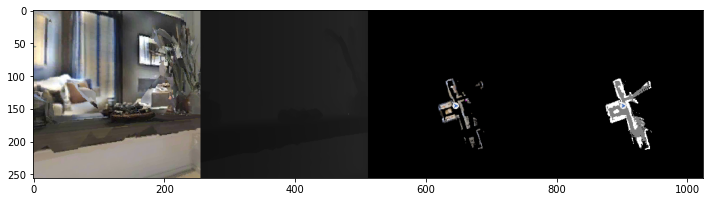

STEPS : 366 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


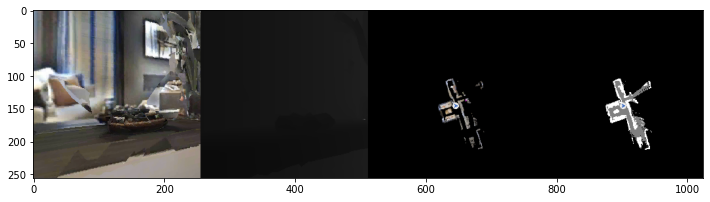

STEPS : 367 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


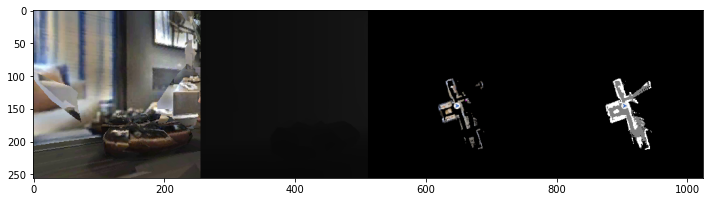

STEPS : 368 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


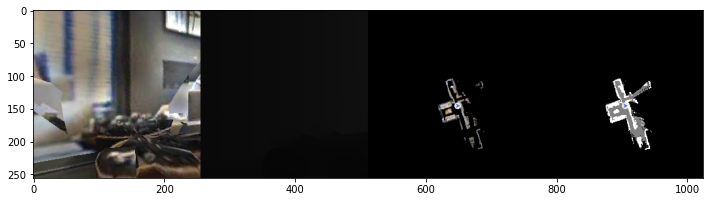

STEPS : 369 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


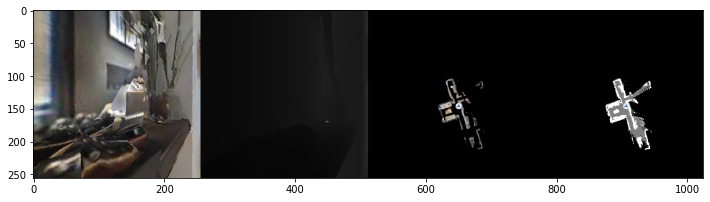

STEPS : 370 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


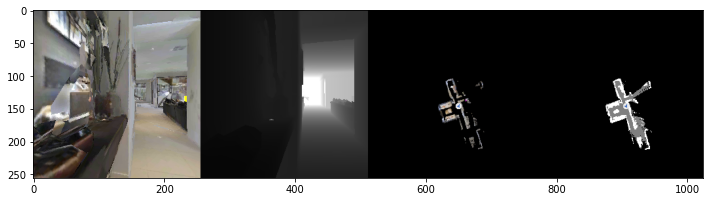

STEPS : 371 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


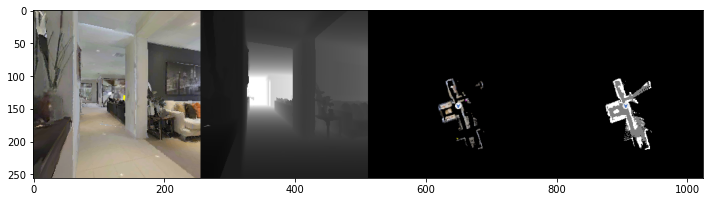

STEPS : 372 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


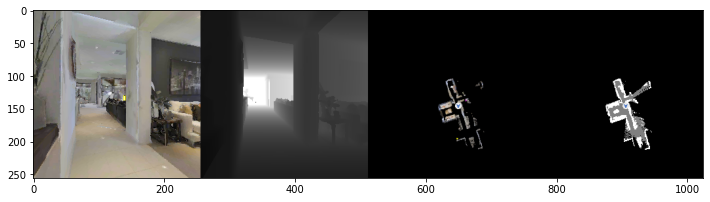

STEPS : 373 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


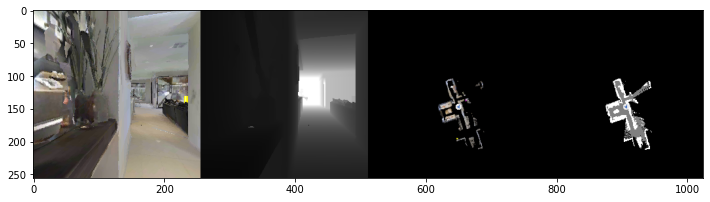

STEPS : 374 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


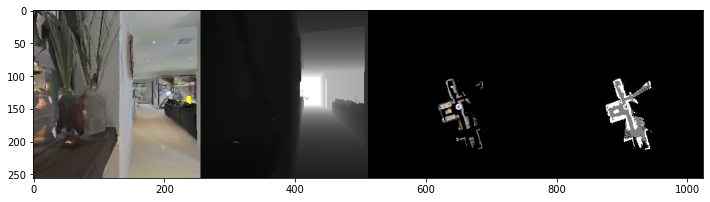

STEPS : 375 GOALS_FOUND : 2 GOALS : [4, 6, 7]
EXPLORE


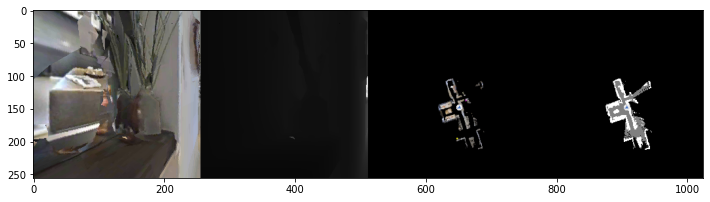

STEPS : 376 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


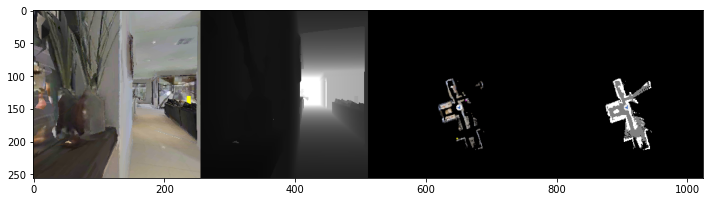

STEPS : 377 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


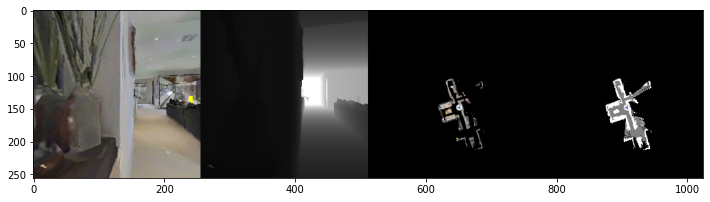

STEPS : 378 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


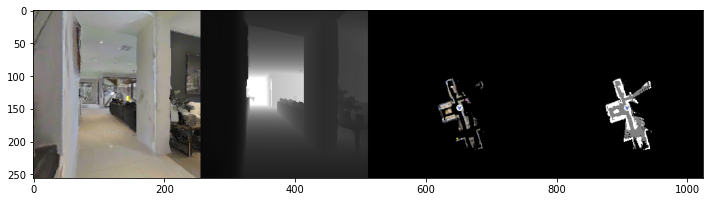

STEPS : 379 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


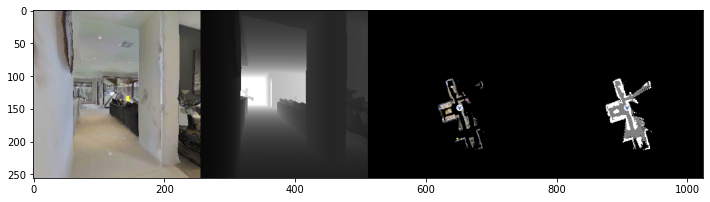

STEPS : 380 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


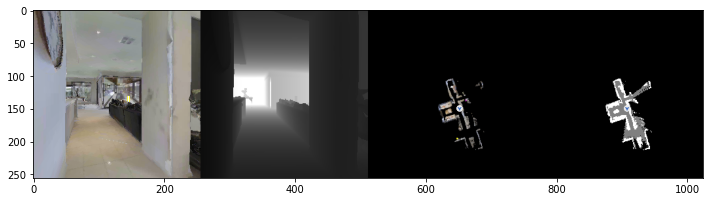

STEPS : 381 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


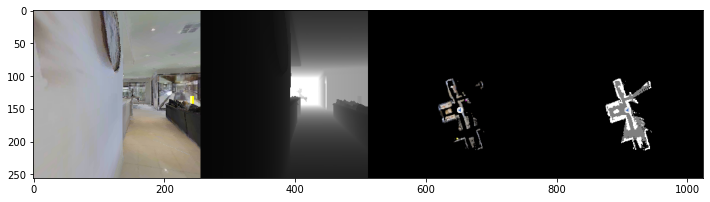

STEPS : 382 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


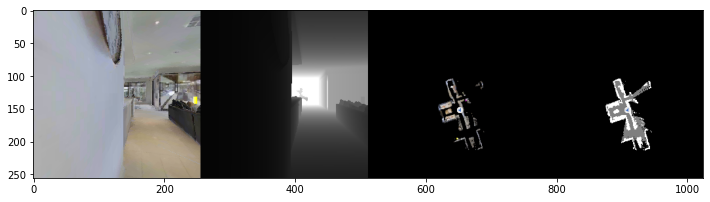

STEPS : 383 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


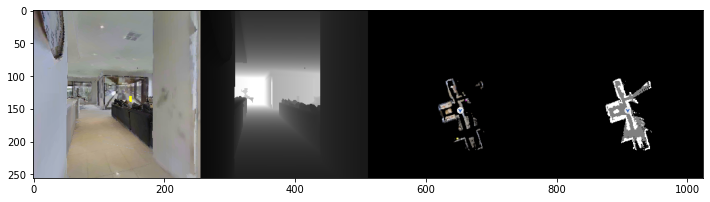

STEPS : 384 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


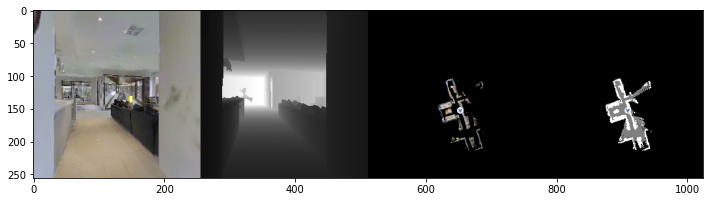

STEPS : 385 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


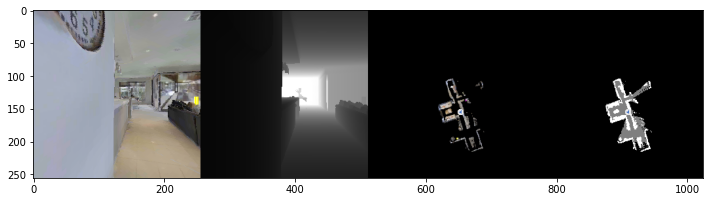

STEPS : 386 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


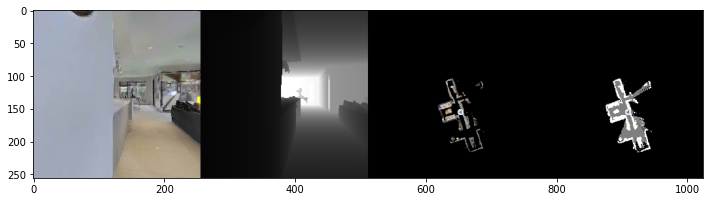

STEPS : 387 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


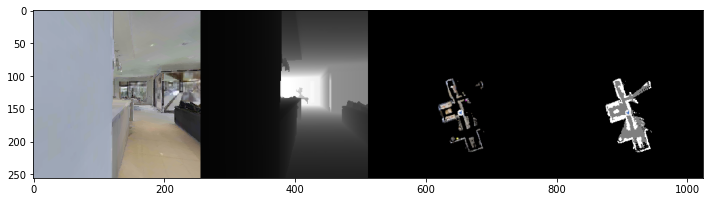

STEPS : 388 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


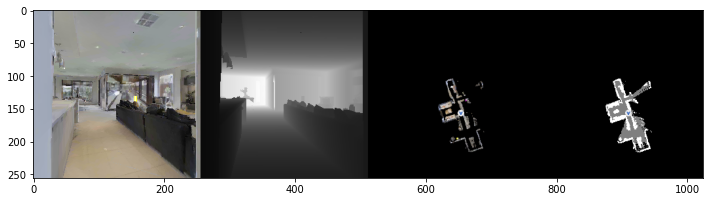

STEPS : 389 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


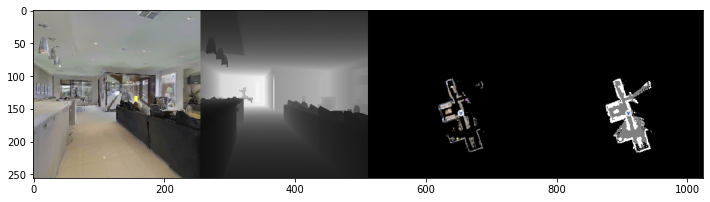

STEPS : 390 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


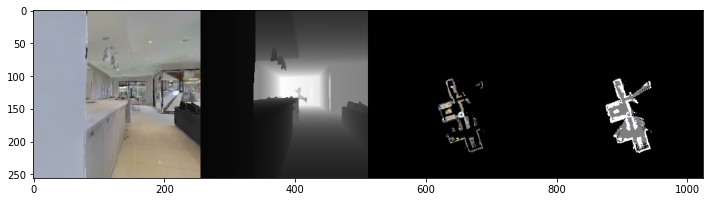

STEPS : 391 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


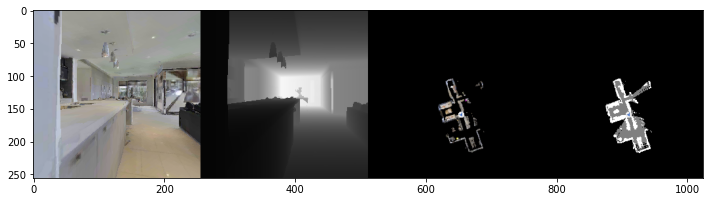

STEPS : 392 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


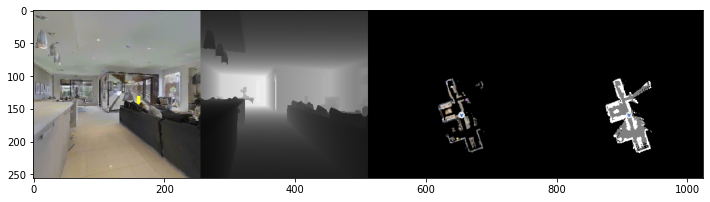

STEPS : 393 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


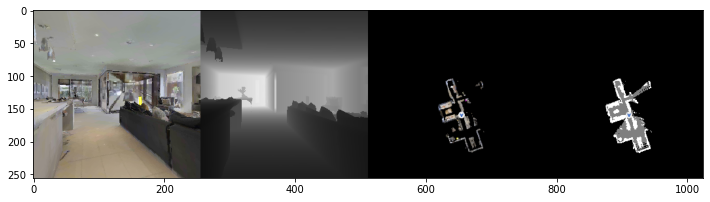

STEPS : 394 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


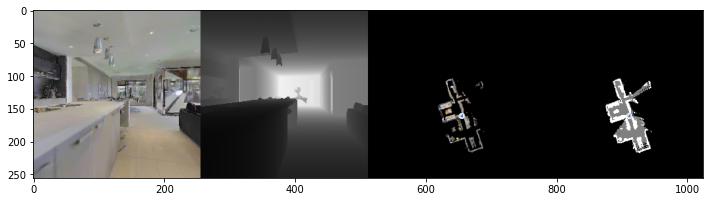

STEPS : 395 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


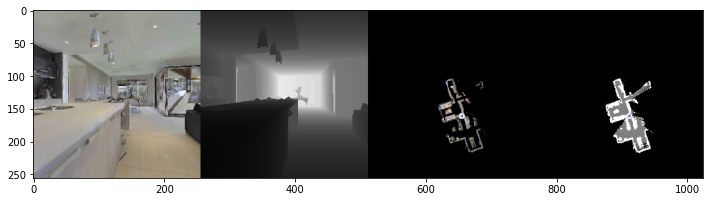

STEPS : 396 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


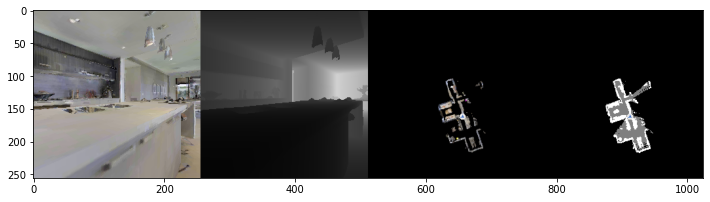

STEPS : 397 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


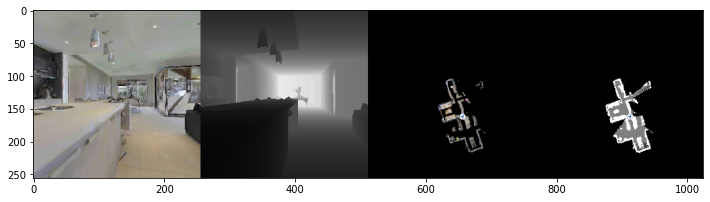

STEPS : 398 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


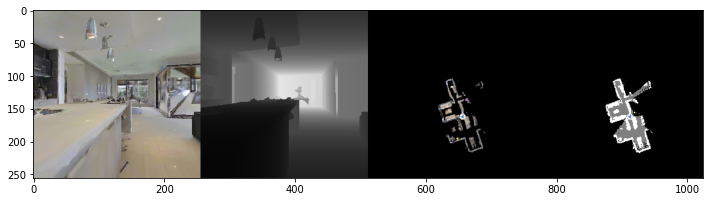

STEPS : 399 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


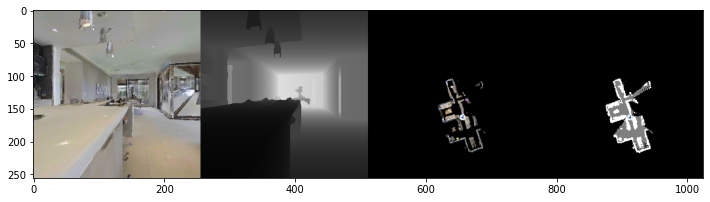

STEPS : 400 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


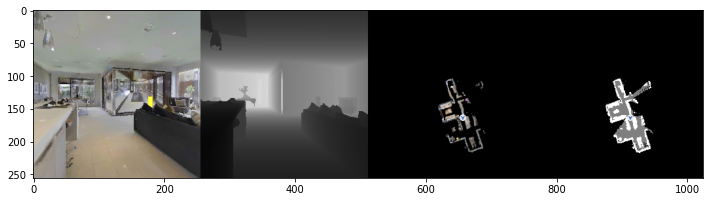

STEPS : 401 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


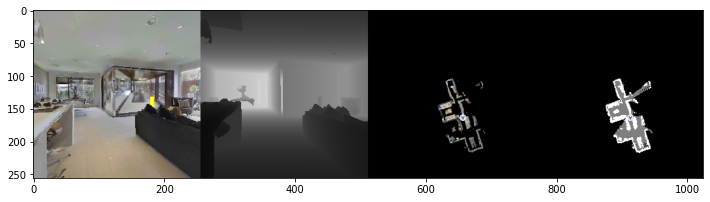

STEPS : 402 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


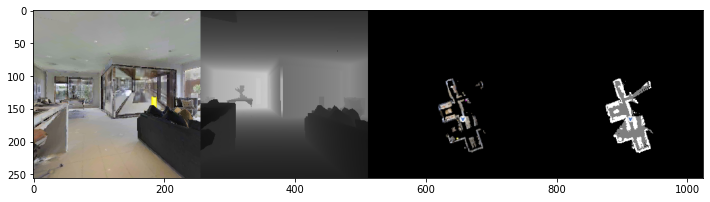

STEPS : 403 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


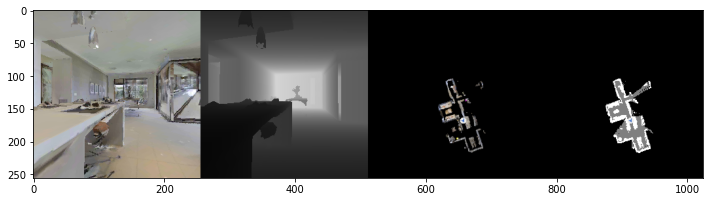

STEPS : 404 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


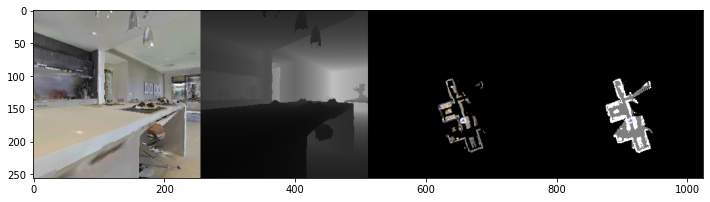

STEPS : 405 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


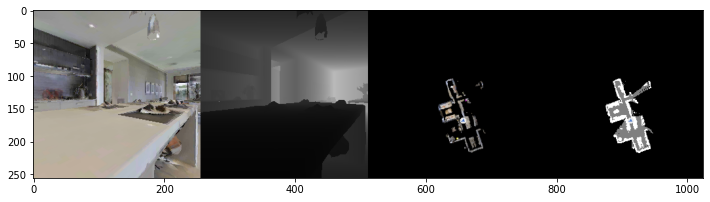

STEPS : 406 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


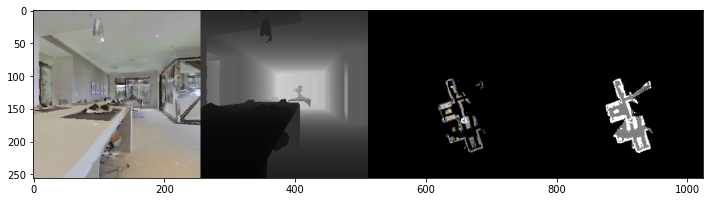

STEPS : 407 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


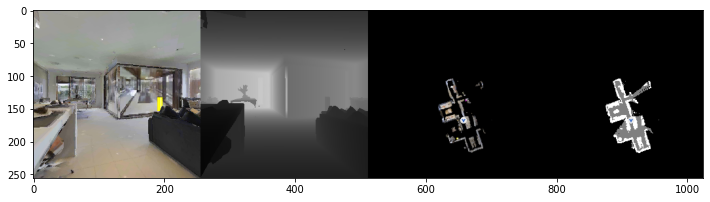

STEPS : 408 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


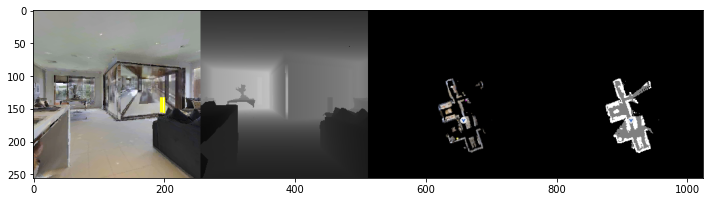

STEPS : 409 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


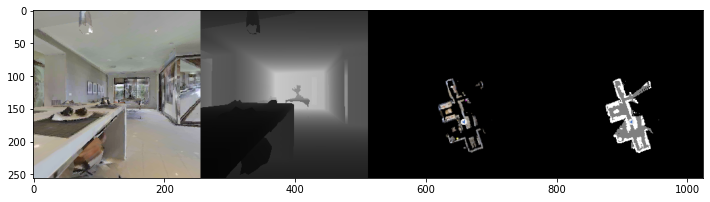

STEPS : 410 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


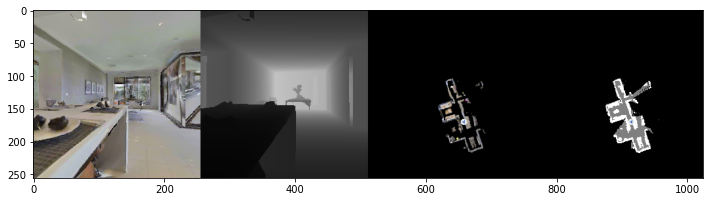

STEPS : 411 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


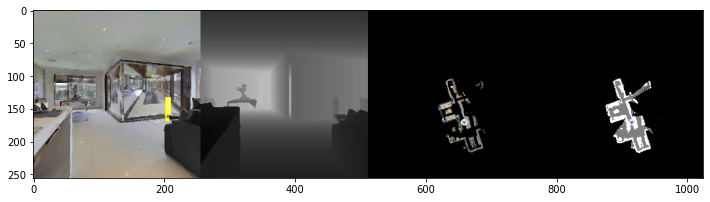

STEPS : 412 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


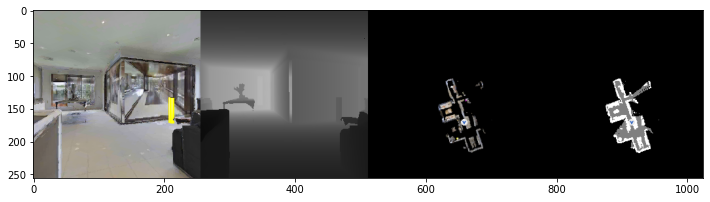

STEPS : 413 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


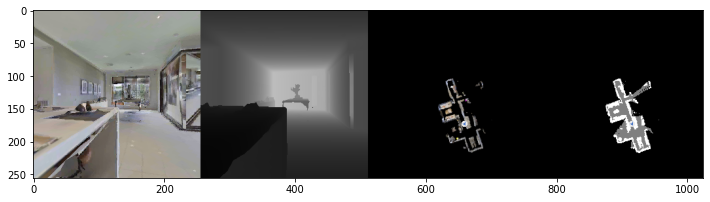

STEPS : 414 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


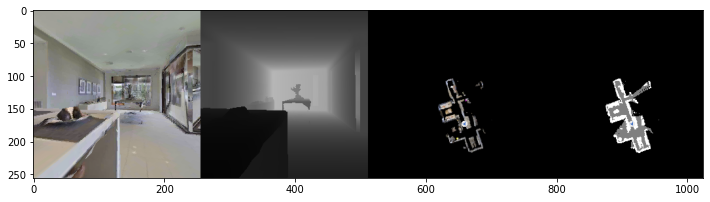

STEPS : 415 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


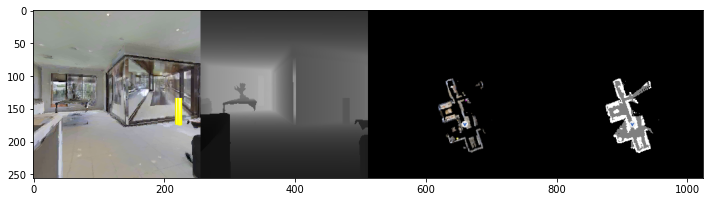

STEPS : 416 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


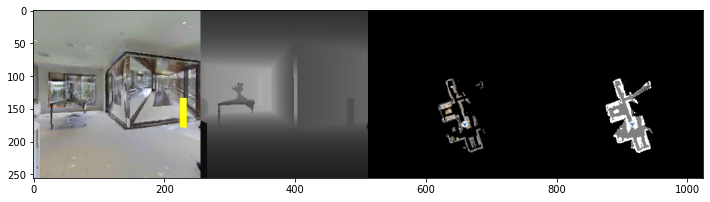

STEPS : 417 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


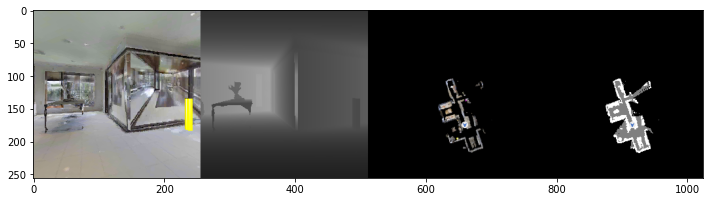

STEPS : 418 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


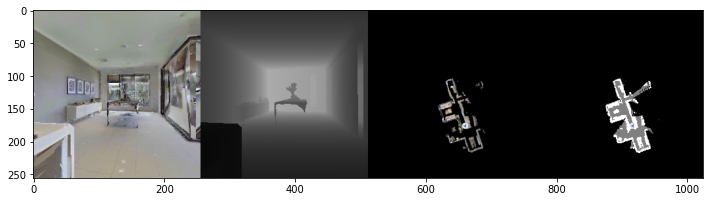

STEPS : 419 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


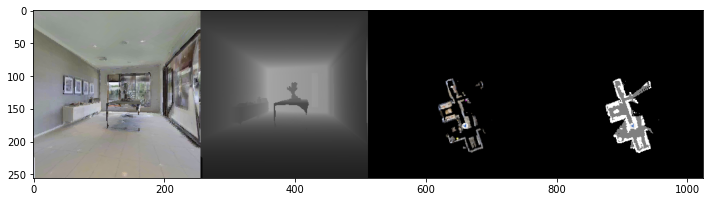

STEPS : 420 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


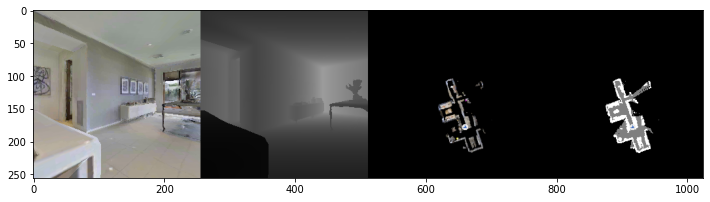

STEPS : 421 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


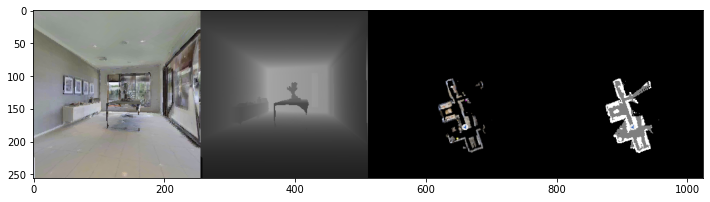

STEPS : 422 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


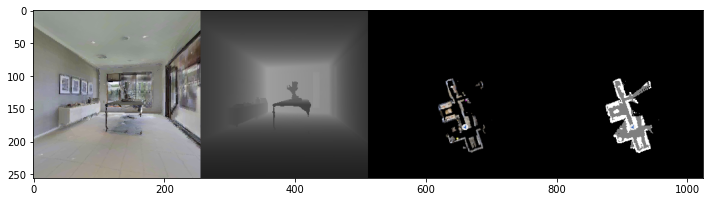

STEPS : 423 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


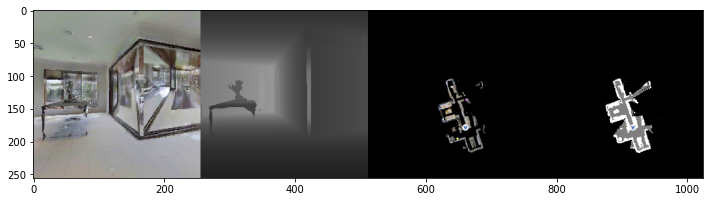

STEPS : 424 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


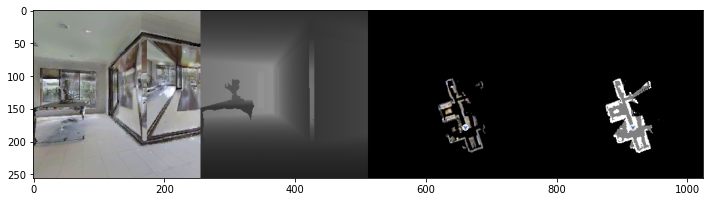

STEPS : 425 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


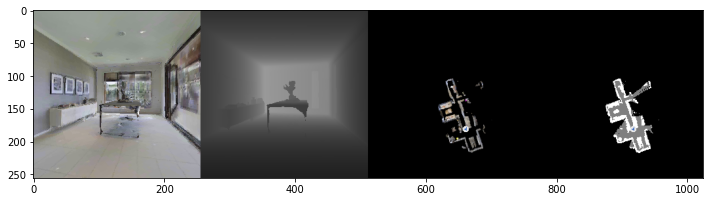

STEPS : 426 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


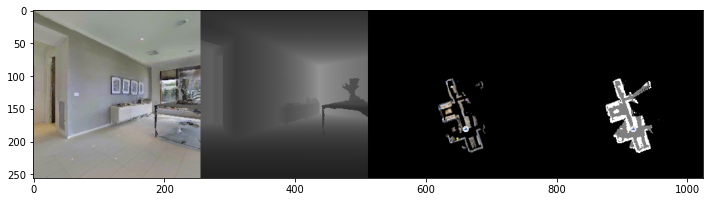

STEPS : 427 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


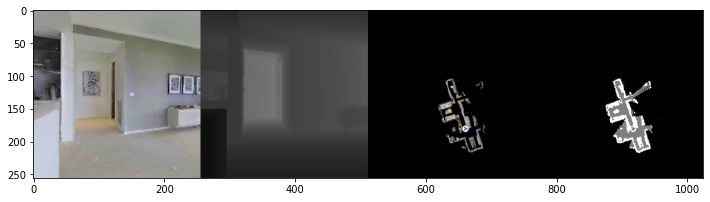

STEPS : 428 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


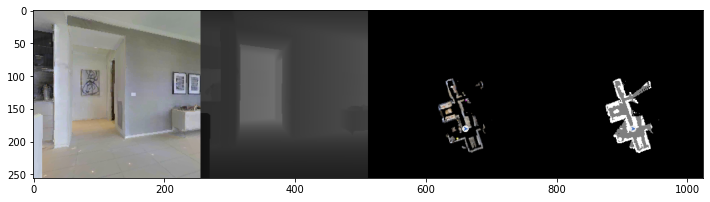

STEPS : 429 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


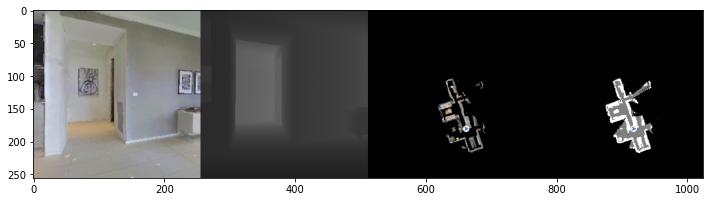

STEPS : 430 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


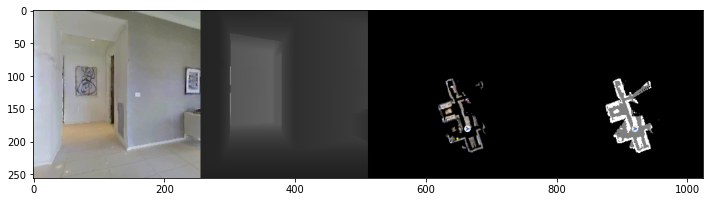

STEPS : 431 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


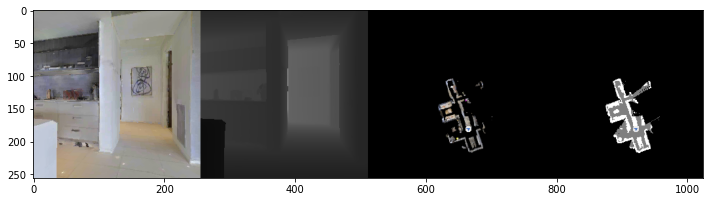

STEPS : 432 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


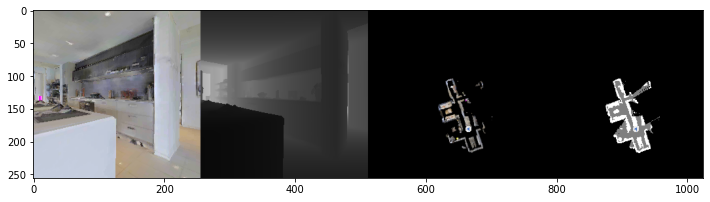

STEPS : 433 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


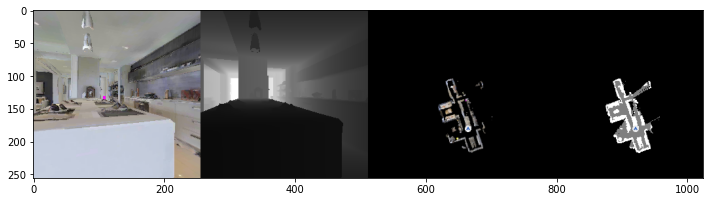

STEPS : 434 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


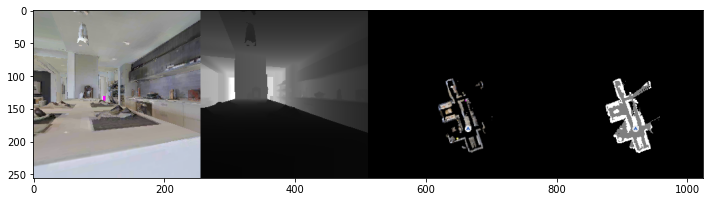

STEPS : 435 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


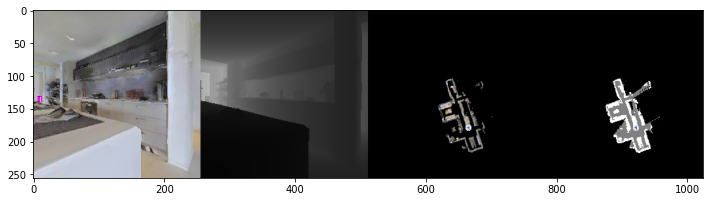

STEPS : 436 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


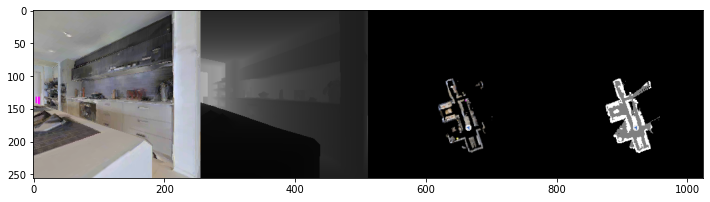

STEPS : 437 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


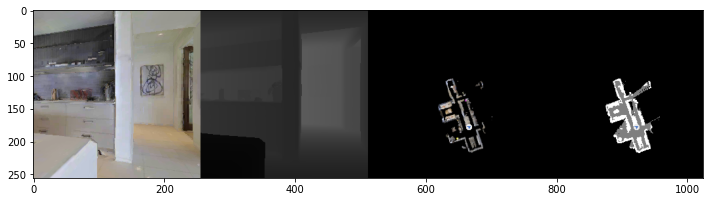

STEPS : 438 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


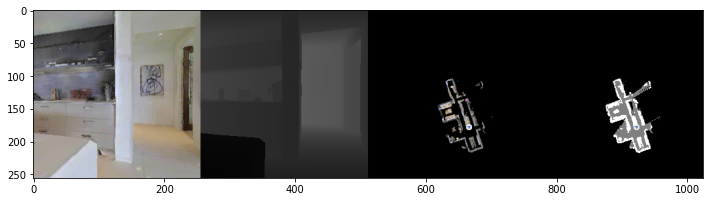

STEPS : 439 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


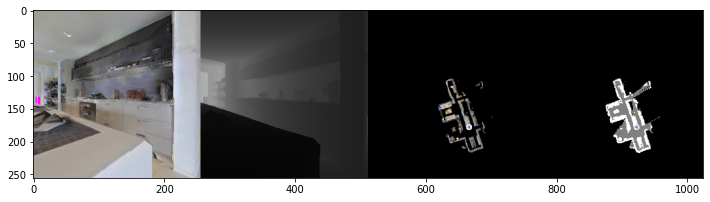

STEPS : 440 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


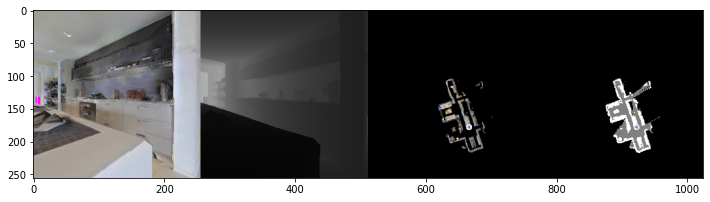

STEPS : 441 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


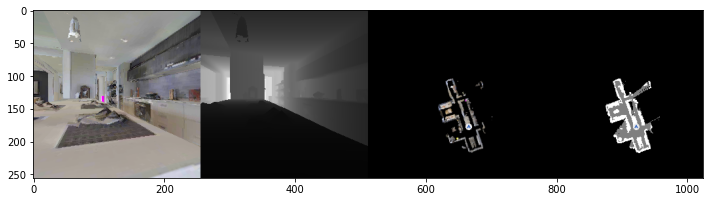

STEPS : 442 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


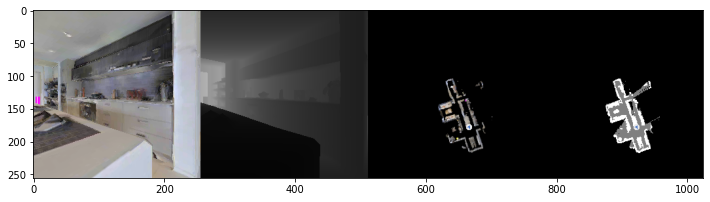

STEPS : 443 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


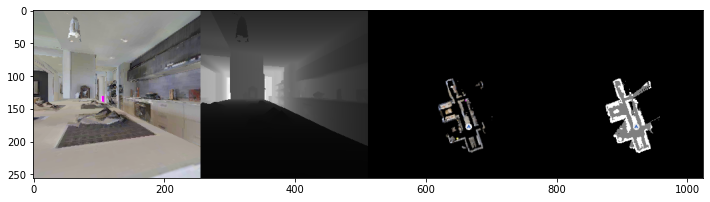

STEPS : 444 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


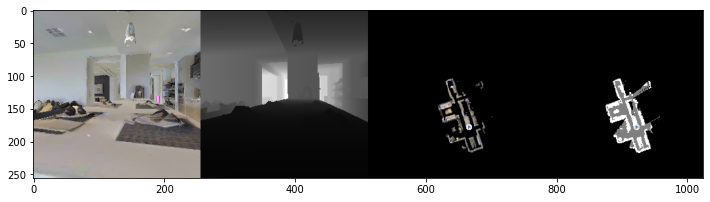

STEPS : 445 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


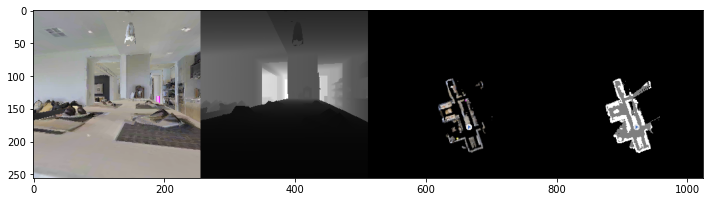

STEPS : 446 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


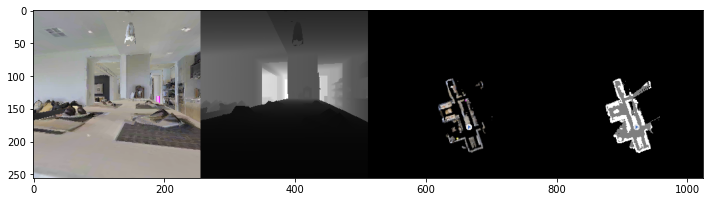

STEPS : 447 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


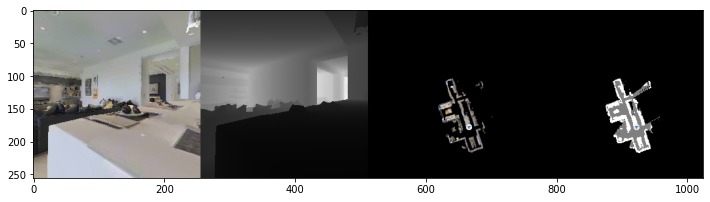

STEPS : 448 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


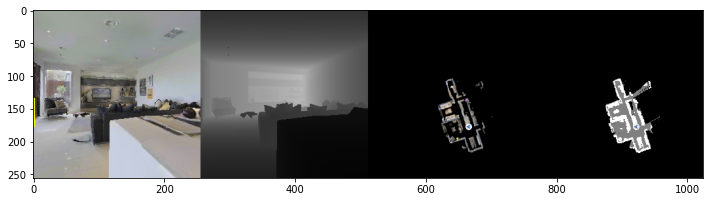

STEPS : 449 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


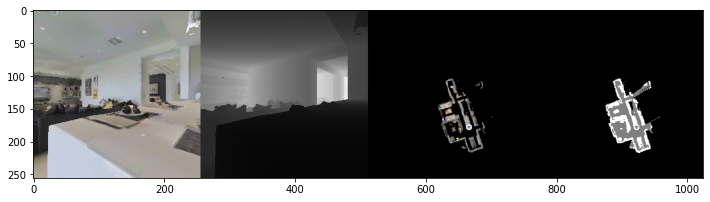

STEPS : 450 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


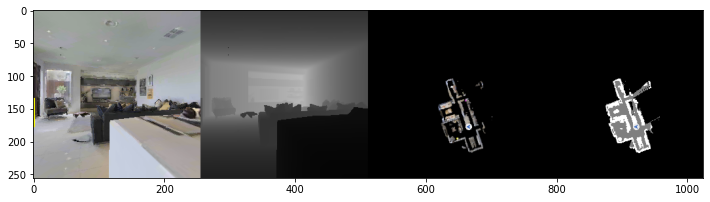

STEPS : 451 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


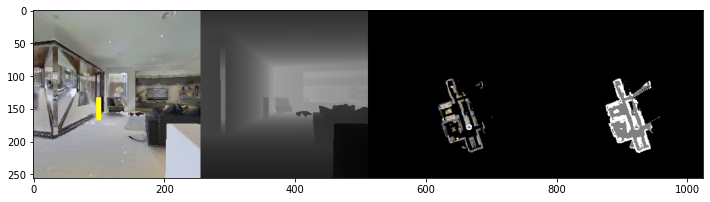

STEPS : 452 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


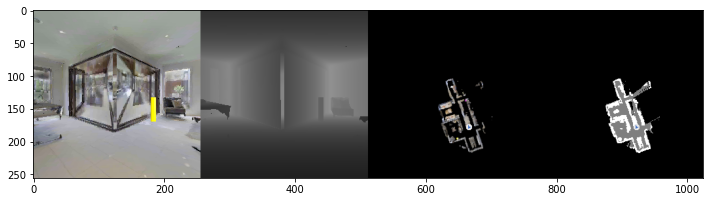

STEPS : 453 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


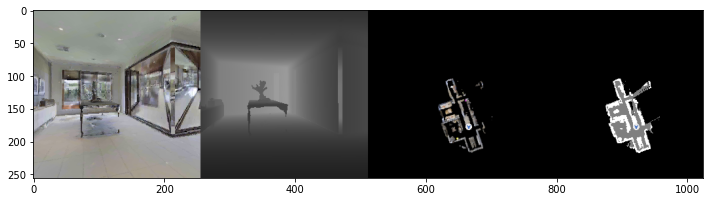

STEPS : 454 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


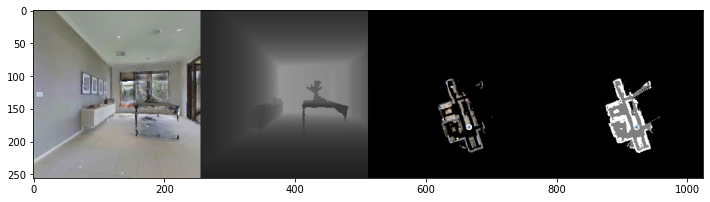

STEPS : 455 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


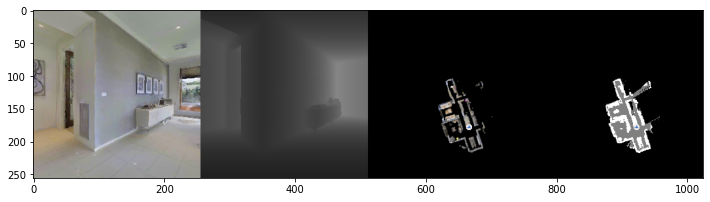

STEPS : 456 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


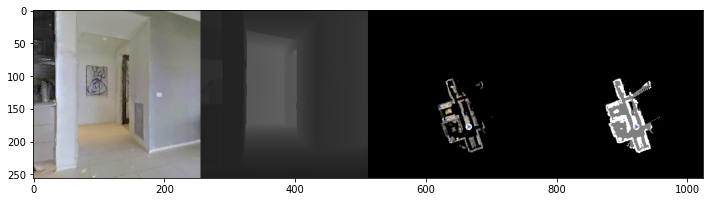

STEPS : 457 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


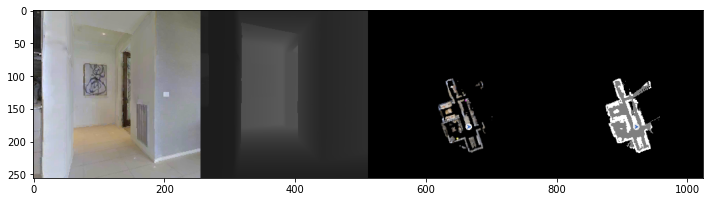

STEPS : 458 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


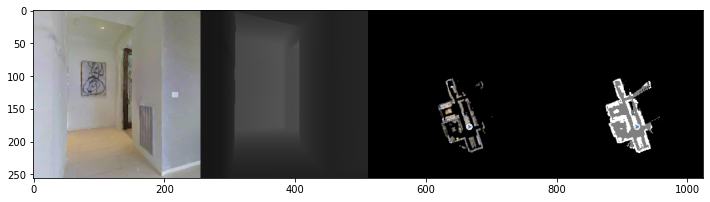

STEPS : 459 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


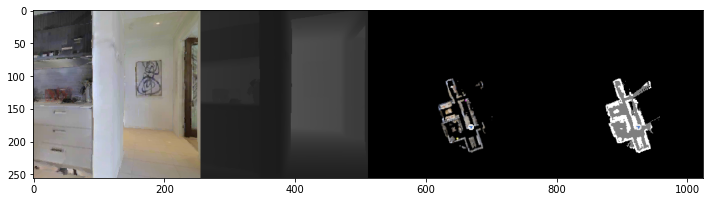

STEPS : 460 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


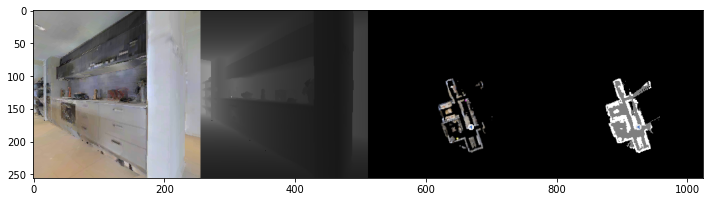

STEPS : 461 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


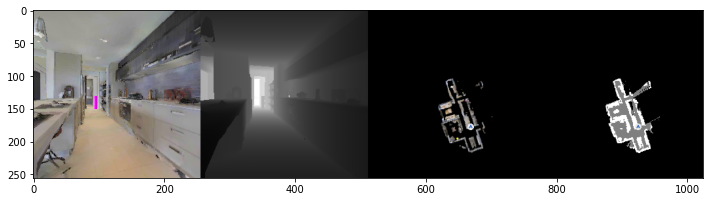

STEPS : 462 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


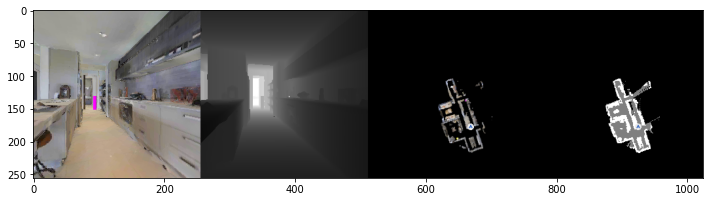

STEPS : 463 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


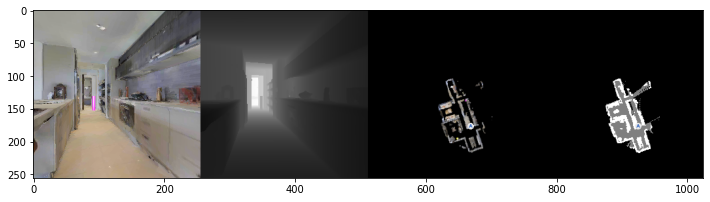

STEPS : 464 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


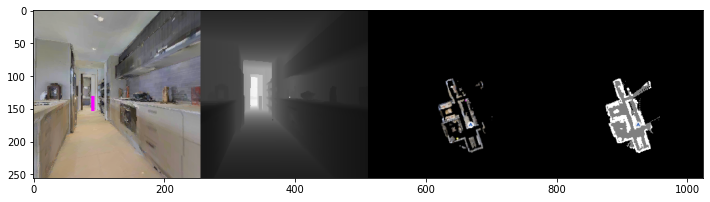

STEPS : 465 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


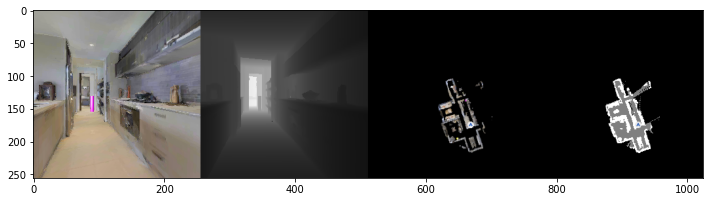

STEPS : 466 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


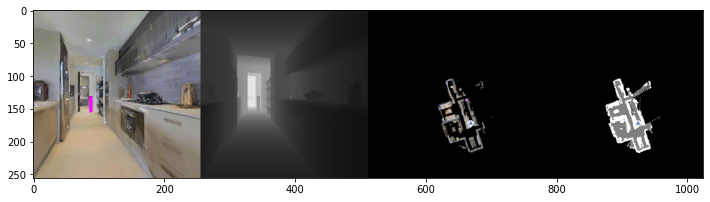

STEPS : 467 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


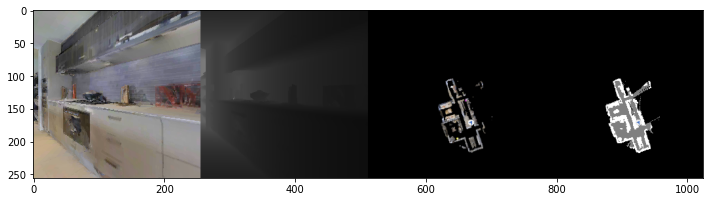

STEPS : 468 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


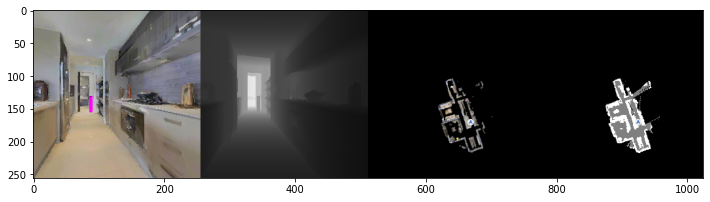

STEPS : 469 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


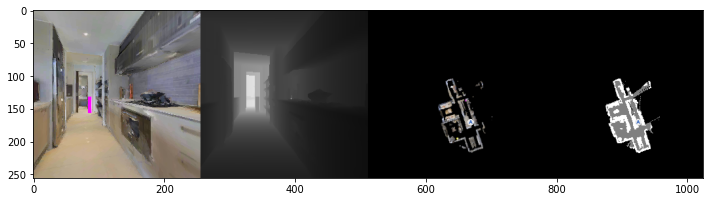

STEPS : 470 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


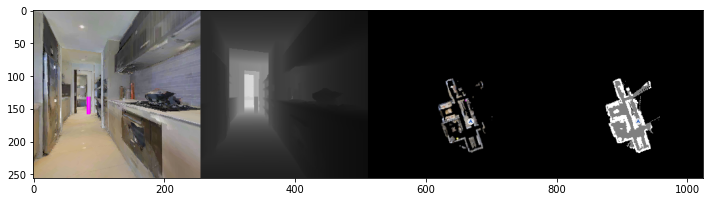

STEPS : 471 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


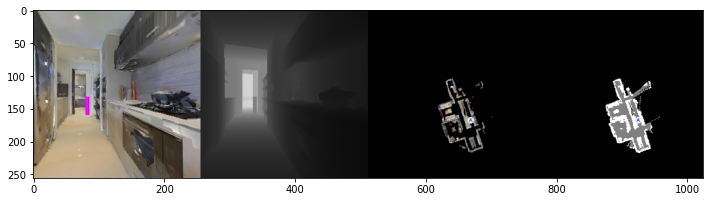

STEPS : 472 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


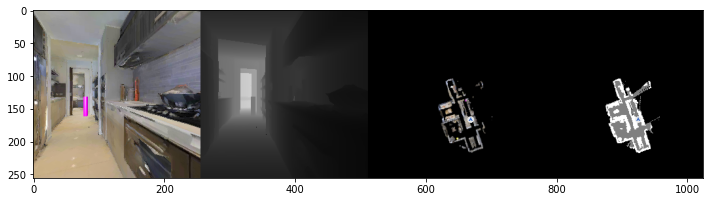

STEPS : 473 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


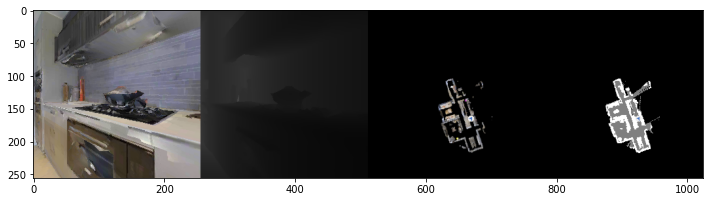

STEPS : 474 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


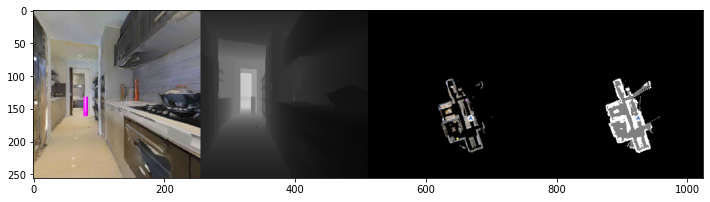

STEPS : 475 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


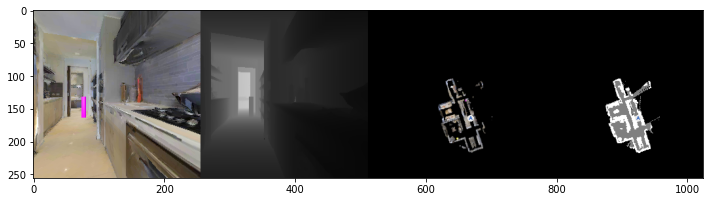

STEPS : 476 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


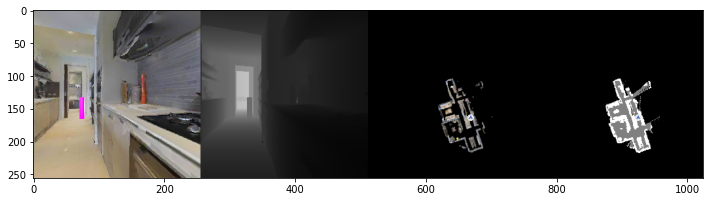

STEPS : 477 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


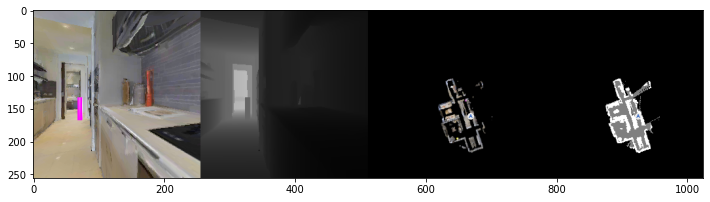

STEPS : 478 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


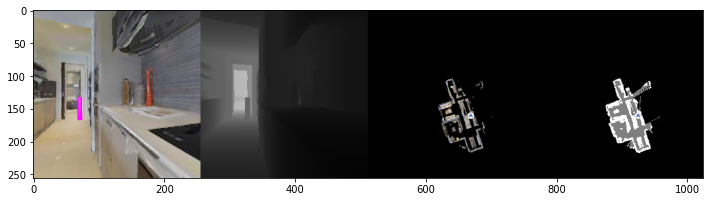

STEPS : 479 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


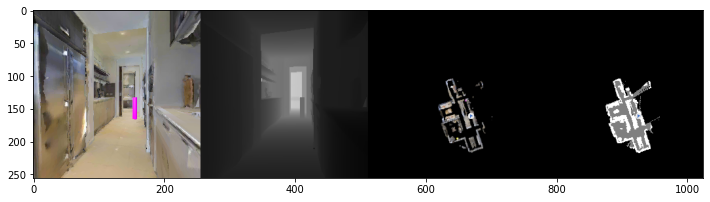

STEPS : 480 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


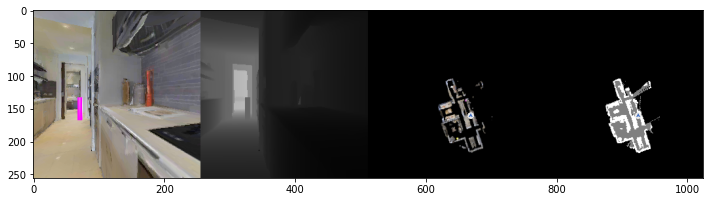

STEPS : 481 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


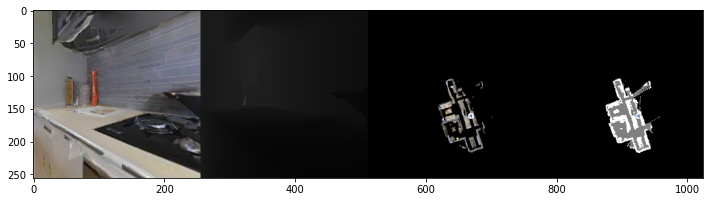

STEPS : 482 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


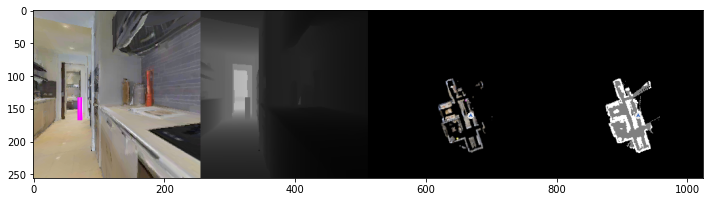

STEPS : 483 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


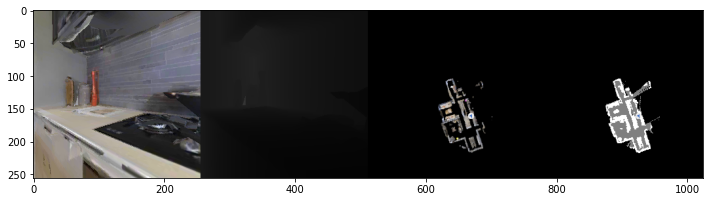

STEPS : 484 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


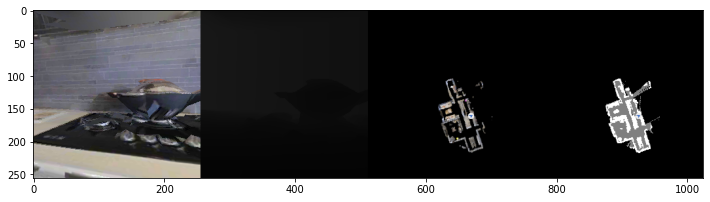

STEPS : 485 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


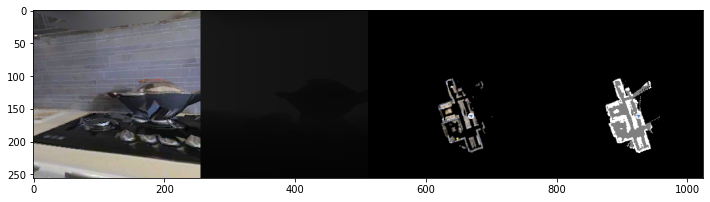

STEPS : 486 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


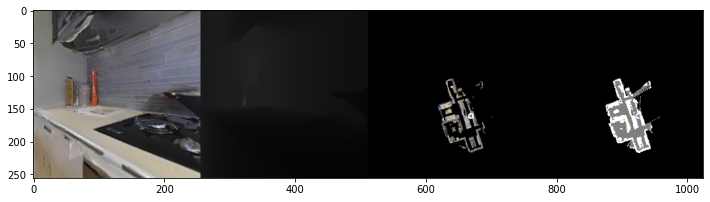

STEPS : 487 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


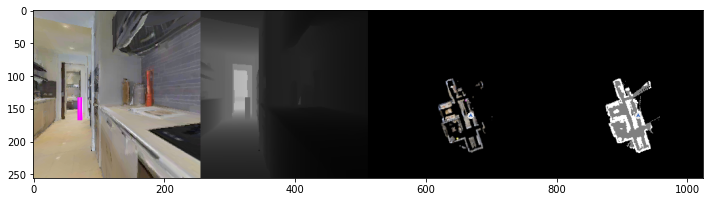

STEPS : 488 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


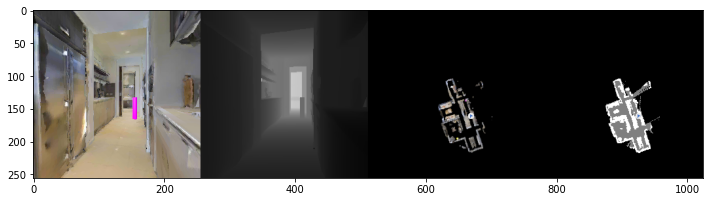

STEPS : 489 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


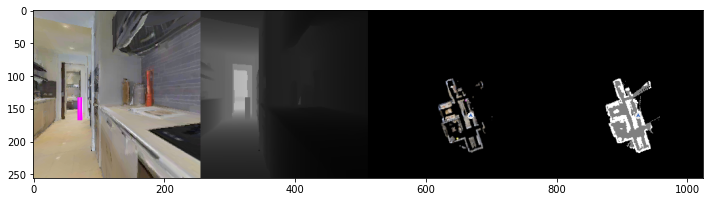

STEPS : 490 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


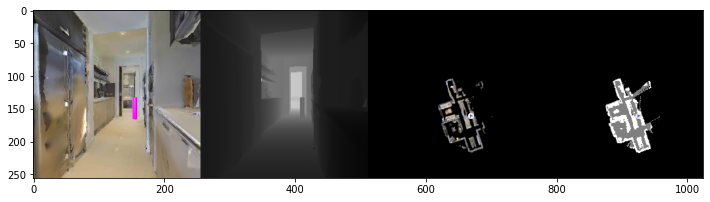

STEPS : 491 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


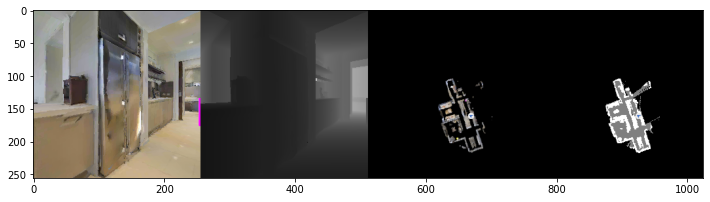

STEPS : 492 GOALS_FOUND : 3 GOALS : [4, 6, 7]
EXPLORE


KeyboardInterrupt: 

In [12]:
agg_metrics: Dict = defaultdict(float)

count_episodes = 0
rgb_frames = []
agent.config.defrost()
agent.config.AGENT.mode = "debug_planning"
agent.config.freeze()
while count_episodes < num_test:
    agent.reset()
    observations = challenge._env.reset()
    
    while not challenge._env.episode_over:
        action = agent.act(observations)
        observations = challenge._env.step(action)
        o = observations.copy()
        for key in observations.keys():
            o[key] = torch.tensor(observations[key], device=agent.device).unsqueeze(0)
        frame = observations_to_image_custum(
                    o, 
                    agent,
                    np.array([action["action"]])
        )
        
        if len(frame.shape) == 4:
            frame = frame.squeeze()
        #rgb_frames.append(frame)
        display_rgb(frame)
        
        
    metrics = challenge._env.get_metrics()
    for m, v in metrics.items():
        agg_metrics[m] += v
    count_episodes += 1

In [19]:
agent.recall

1.0

In [24]:
agent.occupancy_map.shape

torch.Size([1, 275, 275, 1])

In [22]:
challenge._env.get_metrics()

{'distance_to_currgoal': 4.370443344116211,
 'distance_to_multi_goal': 24.233675479888916,
 'sub_success': 0,
 'success': 0,
 'episode_length': 492,
 'mspl': 0.0,
 'percentage_success': 0,
 'ratio': 1.0485717796029772,
 'pspl': 0}

In [ ]:
fig, ax = plt.subplots()
a = agent.occupancy_map.cpu().squeeze(0).squeeze(2) == 0.5
ax.imshow(a * 1., vmin=-0.5, vmax=1.5)

In [ ]:
avg_metrics = {k: v / count_episodes for k, v in agg_metrics.items()}

In [ ]:
IMAGE_DIR = os.path.join("notebook_outputs")
images_to_video(
    rgb_frames, 
    IMAGE_DIR, 
    f"hi"
)